In [1]:
from player import Player, PlayerType
from estate import Estate
import random
from operator import attrgetter

### Emulando um jogo para testes

In [2]:
def init_game():
    player_1 = Player(player_id=1,player_type=PlayerType.IMPULSIVE, balance=300)
    player_2 = Player(player_id=2,player_type=PlayerType.RIGOROUS, balance=300)
    player_3 = Player(player_id=3,player_type=PlayerType.CAUTIOUS, balance=300)
    player_4 = Player(player_id=4,player_type=PlayerType.RANDOM, balance=300)

    random.seed(0)
    
    # atribui a ordem dos jogadores aleatoriamente
    players_list = [player_1, player_2, player_3, player_4]
    players_order = players_list.copy()
    random.shuffle(players_order)
    players_list.insert(0,None)
    
    ## Posição -1 é o ponto de partida
    ## após o começo do jogo essa posição deixa de existir
    ## ao passar novamente na posição 0, o jogador ganha 100
    board = []
    board.append(Estate(price=50, rent=10, estate_id = 0))
    board.append(Estate(price=100, rent=20, estate_id = 1))
    board.append(Estate(price=150, rent=30, estate_id = 2))
    board.append(Estate(price=200, rent=40, estate_id = 3))
    board.append(Estate(price=250, rent=55, estate_id = 4))
    board.append(Estate(price=300, rent=60, estate_id = 5))
    board.append(Estate(price=50, rent=10, estate_id = 6))
    board.append(Estate(price=100, rent=20, estate_id = 7))
    board.append(Estate(price=150, rent=30, estate_id = 8))
    board.append(Estate(price=200, rent=40, estate_id = 9))
    board.append(Estate(price=250, rent=55, estate_id = 10))
    board.append(Estate(price=300, rent=60, estate_id = 11))
    board.append(Estate(price=50, rent=10, estate_id = 12))
    board.append(Estate(price=100, rent=20, estate_id = 13))
    board.append(Estate(price=150, rent=30, estate_id = 14))
    board.append(Estate(price=200, rent=40, estate_id = 15))
    board.append(Estate(price=250, rent=55, estate_id = 16))
    board.append(Estate(price=300, rent=60, estate_id = 17))
    board.append(Estate(price=50, rent=10, estate_id = 18))
    board.append(Estate(price=100, rent=20, estate_id = 19))
    
    return players_list, players_order, board

In [3]:
# Executa uma rodada, elimina jogadores com menos de 0 de saldo
# Retorna caso haja um vencedor
def run_round(players_list, players_order, board):
    
    for player in players_order:
        print(f"player {player.player_id} in position", player.position)
        
        player_current_pos = player.move()
        print("new player position:", player_current_pos)
        
        current_estate = board[player_current_pos]
            
        estate_owner = current_estate.owner

        if(estate_owner == None):
            player.buy(current_estate)
        
        else:

            estate_owner = players_list[estate_owner]
            
            print(f"player {player.player_id} fell on player {estate_owner.player_id} property!")
            bankrupt = player.pay_rent(current_estate, estate_owner)

            #falido, remove o jogador do jogo
            if(bankrupt):
                print(f"player {player.player_id} went bankrupt")
                players_order.remove(player)
                if(len(players_order) > 1):
                    return False
                else:
                    return True


In [4]:
def run_game():
    rounds = 1000
    players_list, players_order, board = init_game()
    
    for round_ in range(rounds):
        print(f"round {round_ + 1}")
        winner = run_round(players_list, players_order, board)
        if(winner):
#             print("the winner is:", players_order[0])
            return players_order[0], round_ + 1
        else:
            continue
            
    # caso o jogo ainda não tenha acabado
    winner = max(players_order, key=attrgetter('balance'))
    print("the winner is", winner)
    
    return winner, round_ + 1
    

In [5]:
winner, round_ = run_game()
print(f"the winner is: {winner.player_id} with the balance of {winner.balance}")
print("number of rounds:",round_)

round 1
player 3 in position -1
player 3 rolled 3
new player position: 2
player 1 in position -1
player 1 rolled 5
new player position: 4
player 2 in position -1
player 2 rolled 4
new player position: 3
player 4 in position -1
player 4 rolled 4
new player position: 3
round 2
player 3 in position 2
player 3 rolled 4
new player position: 6
player 1 in position 4
player 1 rolled 3
new player position: 7
player 2 in position 3
player 2 rolled 5
new player position: 8
player 4 in position 3
player 4 rolled 2
new player position: 5
round 3
player 3 in position 6
player 3 rolled 5
new player position: 11
player 1 in position 7
player 1 rolled 2
new player position: 9
player 2 in position 8
player 2 rolled 3
new player position: 11
player 4 in position 5
player 4 rolled 2
new player position: 7
round 4
player 3 in position 11
player 3 rolled 5
new player position: 16
player 1 in position 9
player 1 rolled 3
new player position: 12
player 2 in position 11
player 2 rolled 5
new player position: 

player 3 in position 6
player 3 rolled 3
new player position: 9
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 2
new player position: 9
player 1 fell on player 3 property!
round 205
player 3 in position 9
player 3 rolled 4
new player position: 13
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 4
new player position: 13
player 1 fell on player 1 property!
round 206
player 3 in position 13
player 3 rolled 1
new player position: 14
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 1
new player position: 14
player 1 fell on player 3 property!
round 207
player 3 in position 14
player 3 rolled 5
new player position: 19
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
round 208
player 3 in position 19
player 3 rolled 4
new player position: 3
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 5
new playe

round 529
player 3 in position 16
player 3 rolled 2
new player position: 18
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 5
new player position: 0
player 1 fell on player 1 property!
round 530
player 3 in position 18
player 3 rolled 4
new player position: 2
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 6
new player position: 6
player 1 fell on player 3 property!
round 531
player 3 in position 2
player 3 rolled 2
new player position: 4
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
round 532
player 3 in position 4
player 3 rolled 3
new player position: 7
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 4
new player position: 13
player 1 fell on player 1 property!
round 533
player 3 in position 7
player 3 rolled 1
new player position: 8
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 2
new

player 1 rolled 6
new player position: 11
player 1 fell on player 3 property!
round 832
player 3 in position 4
player 3 rolled 3
new player position: 7
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 fell on player 1 property!
round 833
player 3 in position 7
player 3 rolled 2
new player position: 9
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 2
new player position: 19
player 1 fell on player 3 property!
round 834
player 3 in position 9
player 3 rolled 3
new player position: 12
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 5
new player position: 4
player 1 fell on player 1 property!
round 835
player 3 in position 12
player 3 rolled 2
new player position: 14
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 5
new player position: 9
player 1 fell on player 3 property!
round 836
player 3 in position 14
player 3 rolled 4
new player position: 1

In [6]:
winner_list = []
round_list = []
for i in range(100):
    winner, round_ = run_game()
    winner_list.append(winner.player_type.value)
    round_list.append(round_)

round 1
player 3 in position -1
player 3 rolled 3
new player position: 2
player 1 in position -1
player 1 rolled 5
new player position: 4
player 2 in position -1
player 2 rolled 4
new player position: 3
player 4 in position -1
player 4 rolled 4
new player position: 3
round 2
player 3 in position 2
player 3 rolled 4
new player position: 6
player 1 in position 4
player 1 rolled 3
new player position: 7
player 2 in position 3
player 2 rolled 5
new player position: 8
player 4 in position 3
player 4 rolled 2
new player position: 5
round 3
player 3 in position 6
player 3 rolled 5
new player position: 11
player 1 in position 7
player 1 rolled 2
new player position: 9
player 2 in position 8
player 2 rolled 3
new player position: 11
player 4 in position 5
player 4 rolled 2
new player position: 7
round 4
player 3 in position 11
player 3 rolled 5
new player position: 16
player 1 in position 9
player 1 rolled 3
new player position: 12
player 2 in position 11
player 2 rolled 5
new player position: 

player 3 rolled 1
new player position: 19
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 4
new player position: 11
player 1 fell on player 2 property!
player 2 in position 14
player 2 rolled 3
new player position: 17
player 2 fell on player 1 property!
round 85
player 3 in position 19
player 3 rolled 3
new player position: 2
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 4
new player position: 15
player 1 fell on player 3 property!
player 2 in position 17
player 2 rolled 1
new player position: 18
player 2 fell on player 3 property!
round 86
player 3 in position 2
player 3 rolled 4
new player position: 6
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
player 2 in position 18
player 2 rolled 5
new player position: 3
player 2 fell on player 1 property!
round 87
player 3 in position 6
player 3 rolled 6
new player position: 12
player 3 fell on pl

player 1 fell on player 1 property!
round 240
player 3 in position 16
player 3 rolled 1
new player position: 17
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 4
new player position: 14
player 1 fell on player 3 property!
round 241
player 3 in position 17
player 3 rolled 3
new player position: 0
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
round 242
player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 1
new player position: 1
player 1 fell on player 1 property!
round 243
player 3 in position 3
player 3 rolled 3
new player position: 6
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 1
new player position: 2
player 1 fell on player 3 property!
round 244
player 3 in position 6
player 3 rolled 1
new player position: 7
player 3 fell on player 3 property!
player 1

player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 352
player 3 in position 16
player 3 rolled 2
new player position: 18
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
round 353
player 3 in position 18
player 3 rolled 1
new player position: 19
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 6
new player position: 3
player 1 fell on player 1 property!
round 354
player 3 in position 19
player 3 rolled 1
new player position: 0
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 4
new player position: 7
player 1 fell on player 3 property!
round 355
player 3 in position 0
player 3 rolled 4
new player position: 4
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 5
new player position: 12
player 1 fell on player 1 property!
round 356
player 3 in position 4
player 3 rolled 4

player 3 in position 4
player 3 rolled 4
new player position: 8
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 4
new player position: 10
player 1 fell on player 1 property!
round 557
player 3 in position 8
player 3 rolled 2
new player position: 10
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 3
new player position: 13
player 1 fell on player 1 property!
round 558
player 3 in position 10
player 3 rolled 3
new player position: 13
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!
round 559
player 3 in position 13
player 3 rolled 6
new player position: 19
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 3
new player position: 18
player 1 fell on player 3 property!
round 560
player 3 in position 19
player 3 rolled 6
new player position: 5
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 6
new p

new player position: 12
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 4
new player position: 14
player 1 fell on player 3 property!
round 702
player 3 in position 12
player 3 rolled 5
new player position: 17
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 2
new player position: 16
player 1 fell on player 1 property!
round 703
player 3 in position 17
player 3 rolled 1
new player position: 18
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 1
new player position: 17
player 1 fell on player 1 property!
round 704
player 3 in position 18
player 3 rolled 5
new player position: 3
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 3
new player position: 0
player 1 fell on player 1 property!
round 705
player 3 in position 3
player 3 rolled 3
new player position: 6
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 1
new player position: 1
player 1 fell on player 

player 1 in position 19
player 1 rolled 1
new player position: 0
player 1 fell on player 1 property!
round 886
player 3 in position 7
player 3 rolled 4
new player position: 11
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
round 887
player 3 in position 11
player 3 rolled 4
new player position: 15
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 4
new player position: 9
player 1 fell on player 3 property!
round 888
player 3 in position 15
player 3 rolled 1
new player position: 16
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 889
player 3 in position 16
player 3 rolled 6
new player position: 2
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 6
new player position: 1
player 1 fell on player 1 property!
round 890
player 3 in position 2
player 3 rolled 6


player 3 in position 2
player 3 rolled 4
new player position: 6
player 1 in position 4
player 1 rolled 3
new player position: 7
player 2 in position 3
player 2 rolled 5
new player position: 8
player 4 in position 3
player 4 rolled 2
new player position: 5
round 3
player 3 in position 6
player 3 rolled 5
new player position: 11
player 1 in position 7
player 1 rolled 2
new player position: 9
player 2 in position 8
player 2 rolled 3
new player position: 11
player 4 in position 5
player 4 rolled 2
new player position: 7
round 4
player 3 in position 11
player 3 rolled 5
new player position: 16
player 1 in position 9
player 1 rolled 3
new player position: 12
player 2 in position 11
player 2 rolled 5
new player position: 16
player 4 in position 7
player 4 rolled 6
new player position: 13
round 5
player 3 in position 16
player 3 rolled 3
new player position: 19
player 1 in position 12
player 1 rolled 1
new player position: 13
player 2 in position 16
player 2 rolled 6
new player position: 2
pla

new player position: 8
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 3
new player position: 18
player 1 fell on player 3 property!
player 2 in position 15
player 2 rolled 3
new player position: 18
player 2 fell on player 3 property!
round 114
player 3 in position 8
player 3 rolled 6
new player position: 14
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 1
new player position: 19
player 1 fell on player 3 property!
player 2 in position 18
player 2 rolled 3
new player position: 1
player 2 fell on player 1 property!
round 115
player 3 in position 14
player 3 rolled 5
new player position: 19
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 1
new player position: 0
player 1 fell on player 1 property!
player 2 in position 1
player 2 rolled 1
new player position: 2
player 2 fell on player 3 property!
round 116
player 3 in position 19
player 3 rolled 3
new player position: 2
player 3 fell on player 3 property!

new player position: 6
player 1 fell on player 3 property!
round 239
player 3 in position 10
player 3 rolled 6
new player position: 16
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 4
new player position: 10
player 1 fell on player 1 property!
round 240
player 3 in position 16
player 3 rolled 1
new player position: 17
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 4
new player position: 14
player 1 fell on player 3 property!
round 241
player 3 in position 17
player 3 rolled 3
new player position: 0
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
round 242
player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 1
new player position: 1
player 1 fell on player 1 property!
round 243
player 3 in position 3
player 3 rolled 3
new player position: 6
player 3 fell on p

new player position: 9
player 1 fell on player 3 property!
round 416
player 3 in position 7
player 3 rolled 5
new player position: 12
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 417
player 3 in position 12
player 3 rolled 4
new player position: 16
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 5
new player position: 0
player 1 fell on player 1 property!
round 418
player 3 in position 16
player 3 rolled 4
new player position: 0
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 4
new player position: 4
player 1 fell on player 1 property!
round 419
player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 6
new player position: 10
player 1 fell on player 1 property!
round 420
player 3 in position 3
player 3 rolled 4
new player position: 7
player 3 fell on pla

player 1 rolled 5
new player position: 17
player 1 fell on player 1 property!
round 564
player 3 in position 13
player 3 rolled 5
new player position: 18
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 6
new player position: 3
player 1 fell on player 1 property!
round 565
player 3 in position 18
player 3 rolled 6
new player position: 4
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 6
new player position: 9
player 1 fell on player 3 property!
round 566
player 3 in position 4
player 3 rolled 4
new player position: 8
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 1
new player position: 10
player 1 fell on player 1 property!
round 567
player 3 in position 8
player 3 rolled 5
new player position: 13
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 1
new player position: 11
player 1 fell on player 3 property!
round 568
player 3 in position 13
player 3 rolled 4
new player position: 1

player 1 in position 5
player 1 rolled 5
new player position: 10
player 1 fell on player 1 property!
round 737
player 3 in position 5
player 3 rolled 2
new player position: 7
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 1
new player position: 11
player 1 fell on player 3 property!
round 738
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 5
new player position: 16
player 1 fell on player 1 property!
round 739
player 3 in position 13
player 3 rolled 2
new player position: 15
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 6
new player position: 2
player 1 fell on player 3 property!
round 740
player 3 in position 15
player 3 rolled 5
new player position: 0
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 1
new player position: 3
player 1 fell on player 1 property!
round 741
player 3 in position 0
player 3 rolled 3

new player position: 1
player 1 fell on player 1 property!
round 890
player 3 in position 2
player 3 rolled 6
new player position: 8
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 1
new player position: 2
player 1 fell on player 3 property!
round 891
player 3 in position 8
player 3 rolled 4
new player position: 12
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 5
new player position: 7
player 1 fell on player 3 property!
round 892
player 3 in position 12
player 3 rolled 6
new player position: 18
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 5
new player position: 12
player 1 fell on player 1 property!
round 893
player 3 in position 18
player 3 rolled 2
new player position: 0
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 2
new player position: 14
player 1 fell on player 3 property!
round 894
player 3 in position 0
player 3 rolled 2
new player position: 2
player 3 fell on pla

new player position: 12
player 1 fell on player 1 property!
player 2 in position 14
player 2 rolled 2
new player position: 16
player 2 fell on player 1 property!
player 4 in position 8
player 4 rolled 6
new player position: 14
player 4 fell on player 3 property!
round 43
player 3 in position 4
player 3 rolled 1
new player position: 5
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 4
new player position: 16
player 1 fell on player 1 property!
player 2 in position 16
player 2 rolled 2
new player position: 18
player 2 fell on player 3 property!
player 4 in position 14
player 4 rolled 6
new player position: 0
player 4 fell on player 1 property!
round 44
player 3 in position 5
player 3 rolled 1
new player position: 6
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 6
new player position: 2
player 1 fell on player 3 property!
player 2 in position 18
player 2 rolled 1
new player position: 19
player 2 fell on player 4 property!
player 4 in

round 142
player 3 in position 1
player 3 rolled 3
new player position: 4
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 1
new player position: 11
player 1 fell on player 2 property!
player 2 in position 5
player 2 rolled 1
new player position: 6
player 2 fell on player 3 property!
round 143
player 3 in position 4
player 3 rolled 6
new player position: 10
player 3 fell on player 2 property!
player 1 in position 11
player 1 rolled 1
new player position: 12
player 1 fell on player 1 property!
player 2 in position 6
player 2 rolled 5
new player position: 11
player 2 fell on player 2 property!
round 144
player 3 in position 10
player 3 rolled 4
new player position: 14
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 6
new player position: 18
player 1 fell on player 3 property!
player 2 in position 11
player 2 rolled 2
new player position: 13
player 2 fell on player 1 property!
round 145
player 3 in position 14
player 3 rolled 1
new pl

round 303
player 3 in position 15
player 3 rolled 4
new player position: 19
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 2
new player position: 13
player 1 fell on player 1 property!
round 304
player 3 in position 19
player 3 rolled 4
new player position: 3
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 4
new player position: 17
player 1 fell on player 1 property!
round 305
player 3 in position 3
player 3 rolled 2
new player position: 5
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 2
new player position: 19
player 1 fell on player 3 property!
round 306
player 3 in position 5
player 3 rolled 4
new player position: 9
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 307
player 3 in position 9
player 3 rolled 5
new player position: 14
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 

player 3 in position 9
player 3 rolled 4
new player position: 13
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 1
new player position: 15
player 1 fell on player 3 property!
round 469
player 3 in position 13
player 3 rolled 5
new player position: 18
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 3
new player position: 18
player 1 fell on player 3 property!
round 470
player 3 in position 18
player 3 rolled 5
new player position: 3
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 5
new player position: 3
player 1 fell on player 1 property!
round 471
player 3 in position 3
player 3 rolled 2
new player position: 5
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 6
new player position: 9
player 1 fell on player 3 property!
round 472
player 3 in position 5
player 3 rolled 3
new player position: 8
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 4
new player

new player position: 12
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 640
player 3 in position 12
player 3 rolled 5
new player position: 17
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
round 641
player 3 in position 17
player 3 rolled 1
new player position: 18
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 5
new player position: 2
player 1 fell on player 3 property!
round 642
player 3 in position 18
player 3 rolled 4
new player position: 2
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 3
new player position: 5
player 1 fell on player 1 property!
round 643
player 3 in position 2
player 3 rolled 2
new player position: 4
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 5
new player position: 10
player 1 fell on player 1 

player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 3
new player position: 14
player 1 fell on player 3 property!
round 812
player 3 in position 16
player 3 rolled 2
new player position: 18
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 2
new player position: 16
player 1 fell on player 1 property!
round 813
player 3 in position 18
player 3 rolled 3
new player position: 1
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 2
new player position: 18
player 1 fell on player 3 property!
round 814
player 3 in position 1
player 3 rolled 2
new player position: 3
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 4
new player position: 2
player 1 fell on player 3 property!
round 815
player 3 in position 3
player 3 rolled 4
new player position: 7
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 3
new player position: 5
player 1 fell on player 1 property!
round 816
play

player 1 in position 9
player 1 rolled 5
new player position: 14
player 1 fell on player 3 property!
round 976
player 3 in position 13
player 3 rolled 2
new player position: 15
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 1
new player position: 15
player 1 fell on player 3 property!
round 977
player 3 in position 15
player 3 rolled 1
new player position: 16
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 4
new player position: 19
player 1 fell on player 3 property!
round 978
player 3 in position 16
player 3 rolled 5
new player position: 1
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 6
new player position: 5
player 1 fell on player 1 property!
round 979
player 3 in position 1
player 3 rolled 5
new player position: 6
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 4
new player position: 9
player 1 fell on player 3 property!
round 980
player 3 in position 6
player 3 rolled 

new player position: 5
player 1 fell on player 1 property!
player 2 in position 16
player 2 rolled 1
new player position: 17
player 2 fell on player 1 property!
round 91
player 3 in position 1
player 3 rolled 6
new player position: 7
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 1
new player position: 6
player 1 fell on player 3 property!
player 2 in position 17
player 2 rolled 6
new player position: 3
player 2 fell on player 1 property!
round 92
player 3 in position 7
player 3 rolled 5
new player position: 12
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 5
new player position: 11
player 1 fell on player 2 property!
player 2 in position 3
player 2 rolled 1
new player position: 4
player 2 fell on player 1 property!
round 93
player 3 in position 12
player 3 rolled 2
new player position: 14
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 1
new player position: 12
player 1 fell on player 1 property!
playe

player 3 in position 4
player 3 rolled 5
new player position: 9
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
player 2 in position 2
player 2 rolled 3
new player position: 5
player 2 fell on player 1 property!
round 180
player 3 in position 9
player 3 rolled 3
new player position: 12
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 1
new player position: 6
player 1 fell on player 3 property!
player 2 in position 5
player 2 rolled 4
new player position: 9
player 2 fell on player 3 property!
round 181
player 3 in position 12
player 3 rolled 3
new player position: 15
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
player 2 in position 9
player 2 rolled 4
new player position: 13
player 2 fell on player 1 property!
player 2 went bankrupt
round 182
player 3 in position 15
player 3 rolled 4
n

player 3 rolled 1
new player position: 0
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 3
new player position: 16
player 1 fell on player 1 property!
round 328
player 3 in position 0
player 3 rolled 4
new player position: 4
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 5
new player position: 1
player 1 fell on player 1 property!
round 329
player 3 in position 4
player 3 rolled 5
new player position: 9
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 6
new player position: 7
player 1 fell on player 3 property!
round 330
player 3 in position 9
player 3 rolled 4
new player position: 13
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 4
new player position: 11
player 1 fell on player 3 property!
round 331
player 3 in position 13
player 3 rolled 1
new player position: 14
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 f

new player position: 8
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 1
new player position: 16
player 1 fell on player 1 property!
round 509
player 3 in position 8
player 3 rolled 2
new player position: 10
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 2
new player position: 18
player 1 fell on player 3 property!
round 510
player 3 in position 10
player 3 rolled 4
new player position: 14
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 5
new player position: 3
player 1 fell on player 1 property!
round 511
player 3 in position 14
player 3 rolled 6
new player position: 0
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 2
new player position: 5
player 1 fell on player 1 property!
round 512
player 3 in position 0
player 3 rolled 2
new player position: 2
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 6
new player position: 11
player 1 fell on player 3 p

player 1 fell on player 1 property!
round 668
player 3 in position 10
player 3 rolled 2
new player position: 12
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 6
new player position: 11
player 1 fell on player 3 property!
round 669
player 3 in position 12
player 3 rolled 2
new player position: 14
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 fell on player 1 property!
round 670
player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 6
new player position: 3
player 1 fell on player 1 property!
round 671
player 3 in position 17
player 3 rolled 6
new player position: 3
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 4
new player position: 7
player 1 fell on player 3 property!
round 672
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
pla

new player position: 17
player 1 fell on player 1 property!
round 845
player 3 in position 8
player 3 rolled 4
new player position: 12
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 5
new player position: 2
player 1 fell on player 3 property!
round 846
player 3 in position 12
player 3 rolled 1
new player position: 13
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 3
new player position: 5
player 1 fell on player 1 property!
round 847
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 5
new player position: 10
player 1 fell on player 1 property!
round 848
player 3 in position 16
player 3 rolled 3
new player position: 19
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 5
new player position: 15
player 1 fell on player 3 property!
round 849
player 3 in position 19
player 3 rolled 1
new player position: 0
player 3 fell 

new player position: 7
round 4
player 3 in position 11
player 3 rolled 5
new player position: 16
player 1 in position 9
player 1 rolled 3
new player position: 12
player 2 in position 11
player 2 rolled 5
new player position: 16
player 4 in position 7
player 4 rolled 6
new player position: 13
round 5
player 3 in position 16
player 3 rolled 3
new player position: 19
player 1 in position 12
player 1 rolled 1
new player position: 13
player 2 in position 16
player 2 rolled 6
new player position: 2
player 2 fell on player 3 property!
player 4 in position 13
player 4 rolled 1
new player position: 14
round 6
player 3 in position 19
player 3 rolled 6
new player position: 5
player 1 in position 13
player 1 rolled 3
new player position: 16
player 2 in position 2
player 2 rolled 4
new player position: 6
player 2 fell on player 3 property!
player 4 in position 14
player 4 rolled 5
new player position: 19
round 7
player 3 in position 5
player 3 rolled 3
new player position: 8
player 1 in position 16

player 2 fell on player 2 property!
round 111
player 3 in position 18
player 3 rolled 5
new player position: 3
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 3
new player position: 13
player 1 fell on player 1 property!
player 2 in position 11
player 2 rolled 1
new player position: 12
player 2 fell on player 1 property!
round 112
player 3 in position 3
player 3 rolled 2
new player position: 5
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!
player 2 in position 12
player 2 rolled 3
new player position: 15
player 2 fell on player 3 property!
round 113
player 3 in position 5
player 3 rolled 3
new player position: 8
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 3
new player position: 18
player 1 fell on player 3 property!
player 2 in position 15
player 2 rolled 3
new player position: 18
player 2 fell on player 3 property!
round 114
player 3 in

player 1 in position 2
player 1 rolled 3
new player position: 5
player 1 fell on player 1 property!
round 245
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 1
new player position: 6
player 1 fell on player 3 property!
round 246
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
round 247
player 3 in position 16
player 3 rolled 2
new player position: 18
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 1
new player position: 10
player 1 fell on player 1 property!
round 248
player 3 in position 18
player 3 rolled 2
new player position: 0
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 3
new player position: 13
player 1 fell on player 1 property!
round 249
player 3 in position 0
player 3 rolled 1


player 3 in position 11
player 3 rolled 5
new player position: 16
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 3
new player position: 19
player 1 fell on player 3 property!
round 409
player 3 in position 16
player 3 rolled 5
new player position: 1
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 1
new player position: 0
player 1 fell on player 1 property!
round 410
player 3 in position 1
player 3 rolled 6
new player position: 7
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
round 411
player 3 in position 7
player 3 rolled 3
new player position: 10
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 3
new player position: 8
player 1 fell on player 3 property!
round 412
player 3 in position 10
player 3 rolled 4
new player position: 14
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 4
new player

player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 2
new player position: 12
player 1 fell on player 1 property!
round 574
player 3 in position 0
player 3 rolled 1
new player position: 1
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 3
new player position: 15
player 1 fell on player 3 property!
round 575
player 3 in position 1
player 3 rolled 2
new player position: 3
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
round 576
player 3 in position 3
player 3 rolled 2
new player position: 5
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 1
new player position: 18
player 1 fell on player 3 property!
round 577
player 3 in position 5
player 3 rolled 2
new player position: 7
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 6
new player position: 4
player 1 fell on player 1 property!
round 578
playe

new player position: 5
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 5
new player position: 10
player 1 fell on player 1 property!
round 737
player 3 in position 5
player 3 rolled 2
new player position: 7
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 1
new player position: 11
player 1 fell on player 3 property!
round 738
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 5
new player position: 16
player 1 fell on player 1 property!
round 739
player 3 in position 13
player 3 rolled 2
new player position: 15
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 6
new player position: 2
player 1 fell on player 3 property!
round 740
player 3 in position 15
player 3 rolled 5
new player position: 0
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 1
new player position: 3
player 1 fell on player 1 p

player 1 fell on player 1 property!
round 893
player 3 in position 18
player 3 rolled 2
new player position: 0
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 2
new player position: 14
player 1 fell on player 3 property!
round 894
player 3 in position 0
player 3 rolled 2
new player position: 2
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 2
new player position: 16
player 1 fell on player 1 property!
round 895
player 3 in position 2
player 3 rolled 2
new player position: 4
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 2
new player position: 18
player 1 fell on player 3 property!
round 896
player 3 in position 4
player 3 rolled 1
new player position: 5
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 5
new player position: 3
player 1 fell on player 1 property!
round 897
player 3 in position 5
player 3 rolled 2
new player position: 7
player 3 fell on player 3 property!
player

player 1 fell on player 3 property!
player 2 in position 6
player 2 rolled 1
new player position: 7
player 2 fell on player 3 property!
player 4 in position 16
player 4 rolled 1
new player position: 17
round 39
player 3 in position 14
player 3 rolled 1
new player position: 15
player 1 in position 2
player 1 rolled 6
new player position: 8
player 1 fell on player 3 property!
player 2 in position 7
player 2 rolled 2
new player position: 9
player 2 fell on player 3 property!
player 4 in position 17
player 4 rolled 5
new player position: 2
player 4 fell on player 3 property!
round 40
player 3 in position 15
player 3 rolled 5
new player position: 0
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
player 2 in position 9
player 2 rolled 4
new player position: 13
player 2 fell on player 1 property!
player 4 in position 2
player 4 rolled 1
new player position: 3
player 4 fell on player 4 property!
round 41
pl

new player position: 13
player 1 fell on player 1 property!
player 2 in position 13
player 2 rolled 1
new player position: 14
player 2 fell on player 3 property!
round 151
player 3 in position 10
player 3 rolled 5
new player position: 15
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 4
new player position: 17
player 1 fell on player 1 property!
player 2 in position 14
player 2 rolled 2
new player position: 16
player 2 fell on player 1 property!
round 152
player 3 in position 15
player 3 rolled 5
new player position: 0
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 4
new player position: 1
player 1 fell on player 1 property!
player 2 in position 16
player 2 rolled 6
new player position: 2
player 2 fell on player 3 property!
round 153
player 3 in position 0
player 3 rolled 6
new player position: 6
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 4
new player position: 5
player 1 fell on player 1 property!

new player position: 15
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 4
new player position: 11
player 1 fell on player 3 property!
round 303
player 3 in position 15
player 3 rolled 4
new player position: 19
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 2
new player position: 13
player 1 fell on player 1 property!
round 304
player 3 in position 19
player 3 rolled 4
new player position: 3
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 4
new player position: 17
player 1 fell on player 1 property!
round 305
player 3 in position 3
player 3 rolled 2
new player position: 5
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 2
new player position: 19
player 1 fell on player 3 property!
round 306
player 3 in position 5
player 3 rolled 4
new player position: 9
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3

player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 2
new player position: 19
player 1 fell on player 3 property!
round 431
player 3 in position 16
player 3 rolled 4
new player position: 0
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 2
new player position: 1
player 1 fell on player 1 property!
round 432
player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 5
new player position: 6
player 1 fell on player 3 property!
round 433
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 5
new player position: 11
player 1 fell on player 3 property!
round 434
player 3 in position 4
player 3 rolled 1
new player position: 5
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 3
new player position: 14
player 1 fell on player 3 property!
round 435
player 

player 3 in position 6
player 3 rolled 5
new player position: 11
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 3
new player position: 13
player 1 fell on player 1 property!
round 604
player 3 in position 11
player 3 rolled 6
new player position: 17
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 1
new player position: 14
player 1 fell on player 3 property!
round 605
player 3 in position 17
player 3 rolled 4
new player position: 1
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 4
new player position: 18
player 1 fell on player 3 property!
round 606
player 3 in position 1
player 3 rolled 6
new player position: 7
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 1
new player position: 19
player 1 fell on player 3 property!
round 607
player 3 in position 7
player 3 rolled 4
new player position: 11
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 3
new p

player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 2
new player position: 9
player 1 fell on player 3 property!
round 759
player 3 in position 17
player 3 rolled 3
new player position: 0
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 1
new player position: 10
player 1 fell on player 1 property!
round 760
player 3 in position 0
player 3 rolled 2
new player position: 2
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 6
new player position: 16
player 1 fell on player 1 property!
round 761
player 3 in position 2
player 3 rolled 2
new player position: 4
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 1
new player position: 17
player 1 fell on player 1 property!
round 762
player 3 in position 4
player 3 rolled 3
new player position: 7
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 5
new player position: 2
player 1 fell on player 3 property!
round 763
player 

player 3 rolled 4
new player position: 11
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 2
new player position: 0
player 1 fell on player 1 property!
round 936
player 3 in position 11
player 3 rolled 2
new player position: 13
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
round 937
player 3 in position 13
player 3 rolled 5
new player position: 18
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 1
new player position: 6
player 1 fell on player 3 property!
round 938
player 3 in position 18
player 3 rolled 5
new player position: 3
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 2
new player position: 8
player 1 fell on player 3 property!
round 939
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 6
new player position: 14
player 1 fe

player 3 rolled 6
new player position: 2
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 4
new player position: 6
player 1 fell on player 3 property!
player 2 in position 10
player 2 rolled 2
new player position: 12
player 2 fell on player 1 property!
round 51
player 3 in position 2
player 3 rolled 3
new player position: 5
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
player 2 in position 12
player 2 rolled 6
new player position: 18
player 2 fell on player 3 property!
round 52
player 3 in position 5
player 3 rolled 4
new player position: 9
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 5
new player position: 14
player 1 fell on player 3 property!
player 2 in position 18
player 2 rolled 2
new player position: 0
player 2 fell on player 1 property!
round 53
player 3 in position 9
player 3 rolled 6
new player position: 15
player 3 fell on player 3

new player position: 12
player 1 fell on player 1 property!
player 2 in position 16
player 2 rolled 2
new player position: 18
player 2 fell on player 3 property!
round 177
player 3 in position 17
player 3 rolled 1
new player position: 18
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 6
new player position: 18
player 1 fell on player 3 property!
player 2 in position 18
player 2 rolled 1
new player position: 19
player 2 fell on player 3 property!
round 178
player 3 in position 18
player 3 rolled 6
new player position: 4
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 2
new player position: 0
player 1 fell on player 1 property!
player 2 in position 19
player 2 rolled 3
new player position: 2
player 2 fell on player 3 property!
round 179
player 3 in position 4
player 3 rolled 5
new player position: 9
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!

player 1 in position 1
player 1 rolled 6
new player position: 7
player 1 fell on player 3 property!
round 330
player 3 in position 9
player 3 rolled 4
new player position: 13
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 4
new player position: 11
player 1 fell on player 3 property!
round 331
player 3 in position 13
player 3 rolled 1
new player position: 14
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 fell on player 1 property!
round 332
player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 3
new player position: 0
player 1 fell on player 1 property!
round 333
player 3 in position 17
player 3 rolled 3
new player position: 0
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 6
new player position: 6
player 1 fell on player 3 property!
round 334
player 3 in position 0
player 3 rolled 2

player 1 fell on player 3 property!
round 529
player 3 in position 16
player 3 rolled 2
new player position: 18
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 5
new player position: 0
player 1 fell on player 1 property!
round 530
player 3 in position 18
player 3 rolled 4
new player position: 2
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 6
new player position: 6
player 1 fell on player 3 property!
round 531
player 3 in position 2
player 3 rolled 2
new player position: 4
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
round 532
player 3 in position 4
player 3 rolled 3
new player position: 7
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 4
new player position: 13
player 1 fell on player 1 property!
round 533
player 3 in position 7
player 3 rolled 1
new player position: 8
player 3 fell on player 3 property!
player 1 

new player position: 19
player 1 fell on player 3 property!
round 666
player 3 in position 5
player 3 rolled 2
new player position: 7
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 1
new player position: 0
player 1 fell on player 1 property!
round 667
player 3 in position 7
player 3 rolled 3
new player position: 10
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
round 668
player 3 in position 10
player 3 rolled 2
new player position: 12
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 6
new player position: 11
player 1 fell on player 3 property!
round 669
player 3 in position 12
player 3 rolled 2
new player position: 14
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 fell on player 1 property!
round 670
player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell o

player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 2
new player position: 5
player 1 fell on player 1 property!
round 810
player 3 in position 11
player 3 rolled 2
new player position: 13
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 6
new player position: 11
player 1 fell on player 3 property!
round 811
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 3
new player position: 14
player 1 fell on player 3 property!
round 812
player 3 in position 16
player 3 rolled 2
new player position: 18
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 2
new player position: 16
player 1 fell on player 1 property!
round 813
player 3 in position 18
player 3 rolled 3
new player position: 1
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 2
new player position: 18
player 1 fell on player 3 property!
round 814


player 3 rolled 4
new player position: 2
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 5
new player position: 6
player 1 fell on player 3 property!
round 949
player 3 in position 2
player 3 rolled 1
new player position: 3
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 4
new player position: 10
player 1 fell on player 1 property!
round 950
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 6
new player position: 16
player 1 fell on player 1 property!
round 951
player 3 in position 4
player 3 rolled 5
new player position: 9
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 4
new player position: 0
player 1 fell on player 1 property!
round 952
player 3 in position 9
player 3 rolled 3
new player position: 12
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 2
new player position: 2
player 1 fell 

player 1 in position 5
player 1 rolled 4
new player position: 9
player 1 fell on player 3 property!
player 2 in position 8
player 2 rolled 4
new player position: 12
player 2 fell on player 1 property!
round 76
player 3 in position 2
player 3 rolled 6
new player position: 8
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
player 2 in position 12
player 2 rolled 5
new player position: 17
player 2 fell on player 1 property!
round 77
player 3 in position 8
player 3 rolled 4
new player position: 12
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 1
new player position: 16
player 1 fell on player 1 property!
player 2 in position 17
player 2 rolled 4
new player position: 1
player 2 fell on player 1 property!
round 78
player 3 in position 12
player 3 rolled 6
new player position: 18
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 5
new player position: 

player 3 in position 14
player 3 rolled 1
new player position: 15
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 1
new player position: 4
player 1 fell on player 1 property!
round 188
player 3 in position 15
player 3 rolled 4
new player position: 19
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 4
new player position: 8
player 1 fell on player 3 property!
round 189
player 3 in position 19
player 3 rolled 2
new player position: 1
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 4
new player position: 12
player 1 fell on player 1 property!
round 190
player 3 in position 1
player 3 rolled 5
new player position: 6
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 6
new player position: 18
player 1 fell on player 3 property!
round 191
player 3 in position 6
player 3 rolled 1
new player position: 7
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 6
new player

player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 6
new player position: 3
player 1 fell on player 1 property!
round 349
player 3 in position 4
player 3 rolled 3
new player position: 7
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 3
new player position: 6
player 1 fell on player 3 property!
round 350
player 3 in position 7
player 3 rolled 4
new player position: 11
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
round 351
player 3 in position 11
player 3 rolled 5
new player position: 16
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 352
player 3 in position 16
player 3 rolled 2
new player position: 18
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
round 353
playe

new player position: 9
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 1
new player position: 7
player 1 fell on player 3 property!
round 489
player 3 in position 9
player 3 rolled 6
new player position: 15
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 5
new player position: 12
player 1 fell on player 1 property!
round 490
player 3 in position 15
player 3 rolled 3
new player position: 18
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 2
new player position: 14
player 1 fell on player 3 property!
round 491
player 3 in position 18
player 3 rolled 6
new player position: 4
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
round 492
player 3 in position 4
player 3 rolled 6
new player position: 10
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 pr

new player position: 9
player 1 fell on player 3 property!
round 663
player 3 in position 10
player 3 rolled 4
new player position: 14
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 1
new player position: 10
player 1 fell on player 1 property!
round 664
player 3 in position 14
player 3 rolled 5
new player position: 19
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 4
new player position: 14
player 1 fell on player 3 property!
round 665
player 3 in position 19
player 3 rolled 6
new player position: 5
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 5
new player position: 19
player 1 fell on player 3 property!
round 666
player 3 in position 5
player 3 rolled 2
new player position: 7
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 1
new player position: 0
player 1 fell on player 1 property!
round 667
player 3 in position 7
player 3 rolled 3
new player position: 10
player 3 fell o

player 3 in position 4
player 3 rolled 5
new player position: 9
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 2
new player position: 14
player 1 fell on player 3 property!
round 828
player 3 in position 9
player 3 rolled 2
new player position: 11
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
round 829
player 3 in position 11
player 3 rolled 4
new player position: 15
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 1
new player position: 1
player 1 fell on player 1 property!
round 830
player 3 in position 15
player 3 rolled 4
new player position: 19
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 4
new player position: 5
player 1 fell on player 1 property!
round 831
player 3 in position 19
player 3 rolled 5
new player position: 4
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 6
new player

new player position: 9
player 1 fell on player 3 property!
round 975
player 3 in position 8
player 3 rolled 5
new player position: 13
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 5
new player position: 14
player 1 fell on player 3 property!
round 976
player 3 in position 13
player 3 rolled 2
new player position: 15
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 1
new player position: 15
player 1 fell on player 3 property!
round 977
player 3 in position 15
player 3 rolled 1
new player position: 16
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 4
new player position: 19
player 1 fell on player 3 property!
round 978
player 3 in position 16
player 3 rolled 5
new player position: 1
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 6
new player position: 5
player 1 fell on player 1 property!
round 979
player 3 in position 1
player 3 rolled 5
new player position: 6
player 3 fell o

player 3 in position 7
player 3 rolled 5
new player position: 12
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 5
new player position: 11
player 1 fell on player 2 property!
player 2 in position 3
player 2 rolled 1
new player position: 4
player 2 fell on player 1 property!
round 93
player 3 in position 12
player 3 rolled 2
new player position: 14
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 1
new player position: 12
player 1 fell on player 1 property!
player 2 in position 4
player 2 rolled 5
new player position: 9
player 2 fell on player 3 property!
round 94
player 3 in position 14
player 3 rolled 6
new player position: 0
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 2
new player position: 14
player 1 fell on player 3 property!
player 2 in position 9
player 2 rolled 3
new player position: 12
player 2 fell on player 1 property!
round 95
player 3 in position 0
player 3 rolled 3
new player position: 3

player 1 in position 7
player 1 rolled 2
new player position: 9
player 1 fell on player 3 property!
round 205
player 3 in position 9
player 3 rolled 4
new player position: 13
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 4
new player position: 13
player 1 fell on player 1 property!
round 206
player 3 in position 13
player 3 rolled 1
new player position: 14
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 1
new player position: 14
player 1 fell on player 3 property!
round 207
player 3 in position 14
player 3 rolled 5
new player position: 19
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
round 208
player 3 in position 19
player 3 rolled 4
new player position: 3
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
round 209
player 3 in position 3
player 3 rolled 6

player 1 rolled 4
new player position: 13
player 1 fell on player 1 property!
round 390
player 3 in position 13
player 3 rolled 2
new player position: 15
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 4
new player position: 17
player 1 fell on player 1 property!
round 391
player 3 in position 15
player 3 rolled 6
new player position: 1
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 2
new player position: 19
player 1 fell on player 3 property!
round 392
player 3 in position 1
player 3 rolled 5
new player position: 6
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 393
player 3 in position 6
player 3 rolled 2
new player position: 8
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 2
new player position: 4
player 1 fell on player 1 property!
round 394
player 3 in position 8
player 3 rolled 2
new player position: 10

player 1 in position 4
player 1 rolled 2
new player position: 6
player 1 fell on player 3 property!
round 542
player 3 in position 2
player 3 rolled 3
new player position: 5
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 1
new player position: 7
player 1 fell on player 3 property!
round 543
player 3 in position 5
player 3 rolled 3
new player position: 8
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 5
new player position: 12
player 1 fell on player 1 property!
round 544
player 3 in position 8
player 3 rolled 5
new player position: 13
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 1
new player position: 13
player 1 fell on player 1 property!
round 545
player 3 in position 13
player 3 rolled 6
new player position: 19
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 6
new player position: 19
player 1 fell on player 3 property!
round 546
player 3 in position 19
player 3 rolled 2


round 731
player 3 in position 3
player 3 rolled 2
new player position: 5
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
round 732
player 3 in position 5
player 3 rolled 3
new player position: 8
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 733
player 3 in position 8
player 3 rolled 6
new player position: 14
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 3
new player position: 18
player 1 fell on player 3 property!
round 734
player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 5
new player position: 3
player 1 fell on player 1 property!
round 735
player 3 in position 17
player 3 rolled 4
new player position: 1
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 2
n

player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
round 887
player 3 in position 11
player 3 rolled 4
new player position: 15
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 4
new player position: 9
player 1 fell on player 3 property!
round 888
player 3 in position 15
player 3 rolled 1
new player position: 16
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 889
player 3 in position 16
player 3 rolled 6
new player position: 2
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 6
new player position: 1
player 1 fell on player 1 property!
round 890
player 3 in position 2
player 3 rolled 6
new player position: 8
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 1
new player position: 2
player 1 fell on player 3 property!
round 891
player 3 in position 8
player 3 rolled 4
ne

player 4 fell on player 3 property!
round 46
player 3 in position 10
player 3 rolled 1
new player position: 11
player 3 fell on player 2 property!
player 1 in position 7
player 1 rolled 2
new player position: 9
player 1 fell on player 3 property!
player 2 in position 0
player 2 rolled 1
new player position: 1
player 2 fell on player 1 property!
player 4 in position 8
player 4 rolled 6
new player position: 14
player 4 fell on player 3 property!
round 47
player 3 in position 11
player 3 rolled 3
new player position: 14
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 3
new player position: 12
player 1 fell on player 1 property!
player 2 in position 1
player 2 rolled 4
new player position: 5
player 2 fell on player 1 property!
player 4 in position 14
player 4 rolled 2
new player position: 16
player 4 fell on player 1 property!
player 4 went bankrupt
round 48
player 3 in position 14
player 3 rolled 1
new player position: 15
player 3 fell on player 3 property!
play

player 2 in position 6
player 2 rolled 4
new player position: 10
player 2 fell on player 2 property!
round 132
player 3 in position 8
player 3 rolled 6
new player position: 14
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 1
new player position: 3
player 1 fell on player 1 property!
player 2 in position 10
player 2 rolled 1
new player position: 11
player 2 fell on player 2 property!
round 133
player 3 in position 14
player 3 rolled 1
new player position: 15
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 2
new player position: 5
player 1 fell on player 1 property!
player 2 in position 11
player 2 rolled 6
new player position: 17
player 2 fell on player 1 property!
round 134
player 3 in position 15
player 3 rolled 2
new player position: 17
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 1
new player position: 6
player 1 fell on player 3 property!
player 2 in position 17
player 2 rolled 4
new player positio

new player position: 9
player 1 fell on player 3 property!
round 294
player 3 in position 16
player 3 rolled 6
new player position: 2
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 3
new player position: 12
player 1 fell on player 1 property!
round 295
player 3 in position 2
player 3 rolled 4
new player position: 6
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 2
new player position: 14
player 1 fell on player 3 property!
round 296
player 3 in position 6
player 3 rolled 3
new player position: 9
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 3
new player position: 17
player 1 fell on player 1 property!
round 297
player 3 in position 9
player 3 rolled 4
new player position: 13
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 1
new player position: 18
player 1 fell on player 3 property!
round 298
player 3 in position 13
player 3 rolled 2
new player position: 15
player 3 fell on

new player position: 6
player 1 fell on player 3 property!
round 445
player 3 in position 19
player 3 rolled 3
new player position: 2
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
round 446
player 3 in position 2
player 3 rolled 5
new player position: 7
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 4
new player position: 13
player 1 fell on player 1 property!
round 447
player 3 in position 7
player 3 rolled 3
new player position: 10
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 4
new player position: 17
player 1 fell on player 1 property!
round 448
player 3 in position 10
player 3 rolled 3
new player position: 13
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 6
new player position: 3
player 1 fell on player 1 property!
round 449
player 3 in position 13
player 3 rolled 2
new player position: 15
player 3 fell on 

round 629
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 630
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 4
new player position: 6
player 1 fell on player 3 property!
round 631
player 3 in position 16
player 3 rolled 4
new player position: 0
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 5
new player position: 11
player 1 fell on player 3 property!
round 632
player 3 in position 0
player 3 rolled 4
new player position: 4
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 2
new player position: 13
player 1 fell on player 1 property!
round 633
player 3 in position 4
player 3 rolled 1
new player position: 5
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 2


new player position: 7
player 1 fell on player 3 property!
round 758
player 3 in position 16
player 3 rolled 1
new player position: 17
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 2
new player position: 9
player 1 fell on player 3 property!
round 759
player 3 in position 17
player 3 rolled 3
new player position: 0
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 1
new player position: 10
player 1 fell on player 1 property!
round 760
player 3 in position 0
player 3 rolled 2
new player position: 2
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 6
new player position: 16
player 1 fell on player 1 property!
round 761
player 3 in position 2
player 3 rolled 2
new player position: 4
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 1
new player position: 17
player 1 fell on player 1 property!
round 762
player 3 in position 4
player 3 rolled 3
new player position: 7
player 3 fell on pl

player 3 in position 4
player 3 rolled 5
new player position: 9
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 4
new player position: 0
player 1 fell on player 1 property!
round 952
player 3 in position 9
player 3 rolled 3
new player position: 12
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 2
new player position: 2
player 1 fell on player 3 property!
round 953
player 3 in position 12
player 3 rolled 5
new player position: 17
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 4
new player position: 6
player 1 fell on player 3 property!
round 954
player 3 in position 17
player 3 rolled 1
new player position: 18
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 4
new player position: 10
player 1 fell on player 1 property!
round 955
player 3 in position 18
player 3 rolled 5
new player position: 3
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 1
new player

player 2 in position 5
player 2 rolled 4
new player position: 9
player 2 fell on player 3 property!
round 49
player 3 in position 15
player 3 rolled 1
new player position: 16
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 5
new player position: 2
player 1 fell on player 3 property!
player 2 in position 9
player 2 rolled 1
new player position: 10
player 2 fell on player 2 property!
round 50
player 3 in position 16
player 3 rolled 6
new player position: 2
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 4
new player position: 6
player 1 fell on player 3 property!
player 2 in position 10
player 2 rolled 2
new player position: 12
player 2 fell on player 1 property!
round 51
player 3 in position 2
player 3 rolled 3
new player position: 5
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
player 2 in position 12
player 2 rolled 6
new player position: 18


player 2 fell on player 1 property!
round 169
player 3 in position 1
player 3 rolled 3
new player position: 4
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 5
new player position: 3
player 1 fell on player 1 property!
player 2 in position 13
player 2 rolled 4
new player position: 17
player 2 fell on player 1 property!
round 170
player 3 in position 4
player 3 rolled 5
new player position: 9
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 5
new player position: 8
player 1 fell on player 3 property!
player 2 in position 17
player 2 rolled 1
new player position: 18
player 2 fell on player 3 property!
round 171
player 3 in position 9
player 3 rolled 5
new player position: 14
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
player 2 in position 18
player 2 rolled 6
new player position: 4
player 2 fell on player 1 property!
round 172
player 3 in posit

player 3 in position 10
player 3 rolled 4
new player position: 14
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 1
new player position: 16
player 1 fell on player 1 property!
round 321
player 3 in position 14
player 3 rolled 6
new player position: 0
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 4
new player position: 0
player 1 fell on player 1 property!
round 322
player 3 in position 0
player 3 rolled 2
new player position: 2
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
round 323
player 3 in position 2
player 3 rolled 4
new player position: 6
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 3
new player position: 8
player 1 fell on player 3 property!
round 324
player 3 in position 6
player 3 rolled 6
new player position: 12
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 1
new player p

round 500
player 3 in position 19
player 3 rolled 3
new player position: 2
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 5
new player position: 13
player 1 fell on player 1 property!
round 501
player 3 in position 2
player 3 rolled 2
new player position: 4
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!
round 502
player 3 in position 4
player 3 rolled 1
new player position: 5
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 5
new player position: 0
player 1 fell on player 1 property!
round 503
player 3 in position 5
player 3 rolled 5
new player position: 10
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 3
new player position: 3
player 1 fell on player 1 property!
round 504
player 3 in position 10
player 3 rolled 3
new player position: 13
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 5
n

new player position: 10
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!
round 674
player 3 in position 10
player 3 rolled 5
new player position: 15
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
round 675
player 3 in position 15
player 3 rolled 3
new player position: 18
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 2
new player position: 19
player 1 fell on player 3 property!
round 676
player 3 in position 18
player 3 rolled 4
new player position: 2
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 1
new player position: 0
player 1 fell on player 1 property!
round 677
player 3 in position 2
player 3 rolled 5
new player position: 7
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 4
new player position: 4
player 1 fell on player 

player 1 rolled 2
new player position: 18
player 1 fell on player 3 property!
round 814
player 3 in position 1
player 3 rolled 2
new player position: 3
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 4
new player position: 2
player 1 fell on player 3 property!
round 815
player 3 in position 3
player 3 rolled 4
new player position: 7
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 3
new player position: 5
player 1 fell on player 1 property!
round 816
player 3 in position 7
player 3 rolled 5
new player position: 12
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 2
new player position: 7
player 1 fell on player 3 property!
round 817
player 3 in position 12
player 3 rolled 4
new player position: 16
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 5
new player position: 12
player 1 fell on player 1 property!
round 818
player 3 in position 16
player 3 rolled 1
new player position: 17
p

player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 1
new player position: 3
player 1 fell on player 1 property!
round 984
player 3 in position 1
player 3 rolled 6
new player position: 7
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 1
new player position: 4
player 1 fell on player 1 property!
round 985
player 3 in position 7
player 3 rolled 2
new player position: 9
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 2
new player position: 6
player 1 fell on player 3 property!
round 986
player 3 in position 9
player 3 rolled 4
new player position: 13
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
round 987
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 2
new player position: 11
player 1 fell on player 3 property!
round 988
player 3 i

new player position: 14
player 2 fell on player 3 property!
round 84
player 3 in position 18
player 3 rolled 1
new player position: 19
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 4
new player position: 11
player 1 fell on player 2 property!
player 2 in position 14
player 2 rolled 3
new player position: 17
player 2 fell on player 1 property!
round 85
player 3 in position 19
player 3 rolled 3
new player position: 2
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 4
new player position: 15
player 1 fell on player 3 property!
player 2 in position 17
player 2 rolled 1
new player position: 18
player 2 fell on player 3 property!
round 86
player 3 in position 2
player 3 rolled 4
new player position: 6
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
player 2 in position 18
player 2 rolled 5
new player position: 3
player 2 fell on player 1 property!


player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
round 216
player 3 in position 17
player 3 rolled 5
new player position: 2
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 2
new player position: 11
player 1 fell on player 3 property!
round 217
player 3 in position 2
player 3 rolled 1
new player position: 3
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 4
new player position: 15
player 1 fell on player 3 property!
round 218
player 3 in position 3
player 3 rolled 4
new player position: 7
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 3
new player position: 18
player 1 fell on player 3 property!
round 219
player 3 in position 7
player 3 rolled 2
new player position: 9
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 4
new player position: 2
player 1 fell on player 3 property!
round 220
player 

new player position: 1
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 2
new player position: 19
player 1 fell on player 3 property!
round 392
player 3 in position 1
player 3 rolled 5
new player position: 6
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 393
player 3 in position 6
player 3 rolled 2
new player position: 8
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 2
new player position: 4
player 1 fell on player 1 property!
round 394
player 3 in position 8
player 3 rolled 2
new player position: 10
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 4
new player position: 8
player 1 fell on player 3 property!
round 395
player 3 in position 10
player 3 rolled 3
new player position: 13
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 4
new player position: 12
player 1 fell on player 1 prop

new player position: 4
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 2
new player position: 6
player 1 fell on player 3 property!
round 556
player 3 in position 4
player 3 rolled 4
new player position: 8
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 4
new player position: 10
player 1 fell on player 1 property!
round 557
player 3 in position 8
player 3 rolled 2
new player position: 10
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 3
new player position: 13
player 1 fell on player 1 property!
round 558
player 3 in position 10
player 3 rolled 3
new player position: 13
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!
round 559
player 3 in position 13
player 3 rolled 6
new player position: 19
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 3
new player position: 18
player 1 fell on player 3

player 1 rolled 1
new player position: 18
player 1 fell on player 3 property!
round 729
player 3 in position 0
player 3 rolled 1
new player position: 1
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 5
new player position: 3
player 1 fell on player 1 property!
round 730
player 3 in position 1
player 3 rolled 2
new player position: 3
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 3
new player position: 6
player 1 fell on player 3 property!
round 731
player 3 in position 3
player 3 rolled 2
new player position: 5
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
round 732
player 3 in position 5
player 3 rolled 3
new player position: 8
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 733
player 3 in position 8
player 3 rolled 6
new player position: 14
playe

player 1 in position 15
player 1 rolled 6
new player position: 1
player 1 fell on player 1 property!
round 890
player 3 in position 2
player 3 rolled 6
new player position: 8
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 1
new player position: 2
player 1 fell on player 3 property!
round 891
player 3 in position 8
player 3 rolled 4
new player position: 12
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 5
new player position: 7
player 1 fell on player 3 property!
round 892
player 3 in position 12
player 3 rolled 6
new player position: 18
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 5
new player position: 12
player 1 fell on player 1 property!
round 893
player 3 in position 18
player 3 rolled 2
new player position: 0
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 2
new player position: 14
player 1 fell on player 3 property!
round 894
player 3 in position 0
player 3 rolled 2
n

round 37
player 3 in position 8
player 3 rolled 1
new player position: 9
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 5
new player position: 16
player 2 in position 0
player 2 rolled 6
new player position: 6
player 2 fell on player 3 property!
player 4 in position 11
player 4 rolled 5
new player position: 16
player 4 fell on player 1 property!
round 38
player 3 in position 9
player 3 rolled 5
new player position: 14
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 6
new player position: 2
player 1 fell on player 3 property!
player 2 in position 6
player 2 rolled 1
new player position: 7
player 2 fell on player 3 property!
player 4 in position 16
player 4 rolled 1
new player position: 17
round 39
player 3 in position 14
player 3 rolled 1
new player position: 15
player 1 in position 2
player 1 rolled 6
new player position: 8
player 1 fell on player 3 property!
player 2 in position 7
player 2 rolled 2
new player position: 9
player 

player 1 in position 2
player 1 rolled 1
new player position: 3
player 1 fell on player 1 property!
player 2 in position 15
player 2 rolled 3
new player position: 18
player 2 fell on player 3 property!
round 140
player 3 in position 17
player 3 rolled 2
new player position: 19
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 3
new player position: 6
player 1 fell on player 3 property!
player 2 in position 18
player 2 rolled 5
new player position: 3
player 2 fell on player 1 property!
round 141
player 3 in position 19
player 3 rolled 2
new player position: 1
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 4
new player position: 10
player 1 fell on player 2 property!
player 2 in position 3
player 2 rolled 2
new player position: 5
player 2 fell on player 1 property!
round 142
player 3 in position 1
player 3 rolled 3
new player position: 4
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 1
new player position: 

player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 3
new player position: 12
player 1 fell on player 1 property!
round 295
player 3 in position 2
player 3 rolled 4
new player position: 6
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 2
new player position: 14
player 1 fell on player 3 property!
round 296
player 3 in position 6
player 3 rolled 3
new player position: 9
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 3
new player position: 17
player 1 fell on player 1 property!
round 297
player 3 in position 9
player 3 rolled 4
new player position: 13
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 1
new player position: 18
player 1 fell on player 3 property!
round 298
player 3 in position 13
player 3 rolled 2
new player position: 15
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 1
new player position: 19
player 1 fell on player 3 property!
round 299
pl

player 3 in position 0
player 3 rolled 6
new player position: 6
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 2
new player position: 13
player 1 fell on player 1 property!
round 429
player 3 in position 6
player 3 rolled 5
new player position: 11
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 4
new player position: 17
player 1 fell on player 1 property!
round 430
player 3 in position 11
player 3 rolled 5
new player position: 16
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 2
new player position: 19
player 1 fell on player 3 property!
round 431
player 3 in position 16
player 3 rolled 4
new player position: 0
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 2
new player position: 1
player 1 fell on player 1 property!
round 432
player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 5
new play

player 3 rolled 2
new player position: 4
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 3
new player position: 16
player 1 fell on player 1 property!
round 628
player 3 in position 4
player 3 rolled 3
new player position: 7
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 3
new player position: 19
player 1 fell on player 3 property!
round 629
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 630
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 4
new player position: 6
player 1 fell on player 3 property!
round 631
player 3 in position 16
player 3 rolled 4
new player position: 0
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 5
new player position: 11
player 1 

player 1 in position 6
player 1 rolled 2
new player position: 8
player 1 fell on player 3 property!
round 783
player 3 in position 2
player 3 rolled 4
new player position: 6
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 5
new player position: 13
player 1 fell on player 1 property!
round 784
player 3 in position 6
player 3 rolled 6
new player position: 12
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 6
new player position: 19
player 1 fell on player 3 property!
round 785
player 3 in position 12
player 3 rolled 1
new player position: 13
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 786
player 3 in position 13
player 3 rolled 4
new player position: 17
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 5
new player position: 7
player 1 fell on player 3 property!
round 787
player 3 in position 17
player 3 rolled 6

new player position: 17
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 4
new player position: 6
player 1 fell on player 3 property!
round 954
player 3 in position 17
player 3 rolled 1
new player position: 18
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 4
new player position: 10
player 1 fell on player 1 property!
round 955
player 3 in position 18
player 3 rolled 5
new player position: 3
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 1
new player position: 11
player 1 fell on player 3 property!
round 956
player 3 in position 3
player 3 rolled 3
new player position: 6
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 5
new player position: 16
player 1 fell on player 1 property!
round 957
player 3 in position 6
player 3 rolled 4
new player position: 10
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 5
new player position: 1
player 1 fell on player 1 

player 2 in position 5
player 2 rolled 4
new player position: 9
player 2 fell on player 3 property!
round 49
player 3 in position 15
player 3 rolled 1
new player position: 16
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 5
new player position: 2
player 1 fell on player 3 property!
player 2 in position 9
player 2 rolled 1
new player position: 10
player 2 fell on player 2 property!
round 50
player 3 in position 16
player 3 rolled 6
new player position: 2
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 4
new player position: 6
player 1 fell on player 3 property!
player 2 in position 10
player 2 rolled 2
new player position: 12
player 2 fell on player 1 property!
round 51
player 3 in position 2
player 3 rolled 3
new player position: 5
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
player 2 in position 12
player 2 rolled 6
new player position: 18


player 2 rolled 6
new player position: 4
player 2 fell on player 1 property!
round 172
player 3 in position 14
player 3 rolled 5
new player position: 19
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 5
new player position: 14
player 1 fell on player 3 property!
player 2 in position 4
player 2 rolled 1
new player position: 5
player 2 fell on player 1 property!
round 173
player 3 in position 19
player 3 rolled 6
new player position: 5
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 4
new player position: 18
player 1 fell on player 3 property!
player 2 in position 5
player 2 rolled 2
new player position: 7
player 2 fell on player 3 property!
round 174
player 3 in position 5
player 3 rolled 3
new player position: 8
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 5
new player position: 3
player 1 fell on player 1 property!
player 2 in position 7
player 2 rolled 5
new player position: 12
player 2 fell on play

new player position: 6
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 3
new player position: 1
player 1 fell on player 1 property!
round 312
player 3 in position 6
player 3 rolled 1
new player position: 7
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 6
new player position: 7
player 1 fell on player 3 property!
round 313
player 3 in position 7
player 3 rolled 4
new player position: 11
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 5
new player position: 12
player 1 fell on player 1 property!
round 314
player 3 in position 11
player 3 rolled 4
new player position: 15
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 1
new player position: 13
player 1 fell on player 1 property!
round 315
player 3 in position 15
player 3 rolled 2
new player position: 17
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 3
new player position: 16
player 1 fell on player 1 

player 3 in position 15
player 3 rolled 3
new player position: 18
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 2
new player position: 14
player 1 fell on player 3 property!
round 491
player 3 in position 18
player 3 rolled 6
new player position: 4
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
round 492
player 3 in position 4
player 3 rolled 6
new player position: 10
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
round 493
player 3 in position 10
player 3 rolled 6
new player position: 16
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 3
new player position: 8
player 1 fell on player 3 property!
round 494
player 3 in position 16
player 3 rolled 2
new player position: 18
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 6
new play

new player position: 3
player 1 fell on player 1 property!
round 638
player 3 in position 3
player 3 rolled 6
new player position: 9
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 6
new player position: 9
player 1 fell on player 3 property!
round 639
player 3 in position 9
player 3 rolled 3
new player position: 12
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 640
player 3 in position 12
player 3 rolled 5
new player position: 17
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
round 641
player 3 in position 17
player 3 rolled 1
new player position: 18
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 5
new player position: 2
player 1 fell on player 3 property!
round 642
player 3 in position 18
player 3 rolled 4
new player position: 2
player 3 fell on 

player 1 fell on player 3 property!
round 820
player 3 in position 2
player 3 rolled 6
new player position: 8
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 4
new player position: 19
player 1 fell on player 3 property!
round 821
player 3 in position 8
player 3 rolled 6
new player position: 14
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 2
new player position: 1
player 1 fell on player 1 property!
round 822
player 3 in position 14
player 3 rolled 2
new player position: 16
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 1
new player position: 2
player 1 fell on player 3 property!
round 823
player 3 in position 16
player 3 rolled 1
new player position: 17
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 3
new player position: 5
player 1 fell on player 1 property!
round 824
player 3 in position 17
player 3 rolled 5
new player position: 2
player 3 fell on player 3 property!
playe

player 3 in position 8
player 3 rolled 4
new player position: 12
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 2
new player position: 18
player 1 fell on player 3 property!
round 970
player 3 in position 12
player 3 rolled 1
new player position: 13
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 3
new player position: 1
player 1 fell on player 1 property!
round 971
player 3 in position 13
player 3 rolled 2
new player position: 15
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 3
new player position: 4
player 1 fell on player 1 property!
round 972
player 3 in position 15
player 3 rolled 1
new player position: 16
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 2
new player position: 6
player 1 fell on player 3 property!
round 973
player 3 in position 16
player 3 rolled 6
new player position: 2
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 1
new play

player 3 rolled 3
new player position: 9
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 fell on player 1 property!
player 2 in position 7
player 2 rolled 2
new player position: 9
player 2 fell on player 3 property!
round 82
player 3 in position 9
player 3 rolled 4
new player position: 13
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 5
new player position: 2
player 1 fell on player 3 property!
player 2 in position 9
player 2 rolled 4
new player position: 13
player 2 fell on player 1 property!
round 83
player 3 in position 13
player 3 rolled 5
new player position: 18
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 5
new player position: 7
player 1 fell on player 3 property!
player 2 in position 13
player 2 rolled 1
new player position: 14
player 2 fell on player 3 property!
round 84
player 3 in position 18
player 3 rolled 1
new player position: 19
player 3 fell on play

player 1 rolled 1
new player position: 4
player 1 fell on player 1 property!
round 188
player 3 in position 15
player 3 rolled 4
new player position: 19
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 4
new player position: 8
player 1 fell on player 3 property!
round 189
player 3 in position 19
player 3 rolled 2
new player position: 1
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 4
new player position: 12
player 1 fell on player 1 property!
round 190
player 3 in position 1
player 3 rolled 5
new player position: 6
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 6
new player position: 18
player 1 fell on player 3 property!
round 191
player 3 in position 6
player 3 rolled 1
new player position: 7
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 6
new player position: 4
player 1 fell on player 1 property!
round 192
player 3 in position 7
player 3 rolled 6
new player position: 13
p

player 3 rolled 5
new player position: 13
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 1
new player position: 8
player 1 fell on player 3 property!
round 379
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 6
new player position: 14
player 1 fell on player 3 property!
round 380
player 3 in position 16
player 3 rolled 6
new player position: 2
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 3
new player position: 17
player 1 fell on player 1 property!
round 381
player 3 in position 2
player 3 rolled 6
new player position: 8
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 2
new player position: 19
player 1 fell on player 3 property!
round 382
player 3 in position 8
player 3 rolled 2
new player position: 10
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 5
new player position: 4
player 1

new player position: 19
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 4
new player position: 8
player 1 fell on player 3 property!
round 500
player 3 in position 19
player 3 rolled 3
new player position: 2
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 5
new player position: 13
player 1 fell on player 1 property!
round 501
player 3 in position 2
player 3 rolled 2
new player position: 4
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!
round 502
player 3 in position 4
player 3 rolled 1
new player position: 5
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 5
new player position: 0
player 1 fell on player 1 property!
round 503
player 3 in position 5
player 3 rolled 5
new player position: 10
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 3
new player position: 3
player 1 fell on player 1 prop

player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 6
new player position: 10
player 1 fell on player 1 property!
round 679
player 3 in position 9
player 3 rolled 6
new player position: 15
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 4
new player position: 14
player 1 fell on player 3 property!
round 680
player 3 in position 15
player 3 rolled 5
new player position: 0
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
round 681
player 3 in position 0
player 3 rolled 1
new player position: 1
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 2
new player position: 2
player 1 fell on player 3 property!
round 682
player 3 in position 1
player 3 rolled 2
new player position: 3
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 4
new player position: 6
player 1 fell on player 3 property!
round 683
player 3

new player position: 16
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 5
new player position: 10
player 1 fell on player 1 property!
round 848
player 3 in position 16
player 3 rolled 3
new player position: 19
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 5
new player position: 15
player 1 fell on player 3 property!
round 849
player 3 in position 19
player 3 rolled 1
new player position: 0
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 5
new player position: 0
player 1 fell on player 1 property!
round 850
player 3 in position 0
player 3 rolled 5
new player position: 5
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 4
new player position: 4
player 1 fell on player 1 property!
round 851
player 3 in position 5
player 3 rolled 2
new player position: 7
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 3
new player position: 7
player 1 fell on player 3 pro

new player position: 15
player 4 in position 4
player 4 rolled 2
new player position: 6
player 4 fell on player 3 property!
round 15
player 3 in position 0
player 3 rolled 2
new player position: 2
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 5
new player position: 11
player 1 fell on player 2 property!
player 2 in position 15
player 2 rolled 4
new player position: 19
player 4 in position 6
player 4 rolled 1
new player position: 7
player 4 fell on player 3 property!
round 16
player 3 in position 2
player 3 rolled 1
new player position: 3
player 3 fell on player 4 property!
player 1 in position 11
player 1 rolled 3
new player position: 14
player 2 in position 19
player 2 rolled 5
new player position: 4
player 2 fell on player 1 property!
player 4 in position 7
player 4 rolled 4
new player position: 11
player 4 fell on player 2 property!
round 17
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in po

player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 2
new player position: 14
player 1 fell on player 3 property!
player 2 in position 9
player 2 rolled 3
new player position: 12
player 2 fell on player 1 property!
round 95
player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
player 2 in position 12
player 2 rolled 2
new player position: 14
player 2 fell on player 3 property!
round 96
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 4
new player position: 4
player 1 fell on player 1 property!
player 2 in position 14
player 2 rolled 4
new player position: 18
player 2 fell on player 3 property!
round 97
player 3 in position 4
player 3 rolled 6
new player position: 10
player 3 fell on player 2 property!
player 1 in position 4
playe

new player position: 8
player 1 fell on player 3 property!
round 210
player 3 in position 9
player 3 rolled 6
new player position: 15
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
round 211
player 3 in position 15
player 3 rolled 6
new player position: 1
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 212
player 3 in position 1
player 3 rolled 5
new player position: 6
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 3
new player position: 18
player 1 fell on player 3 property!
round 213
player 3 in position 6
player 3 rolled 2
new player position: 8
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 4
new player position: 2
player 1 fell on player 3 property!
round 214
player 3 in position 8
player 3 rolled 3
new player position: 11
player 1 in position

player 1 fell on player 1 property!
round 381
player 3 in position 2
player 3 rolled 6
new player position: 8
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 2
new player position: 19
player 1 fell on player 3 property!
round 382
player 3 in position 8
player 3 rolled 2
new player position: 10
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 5
new player position: 4
player 1 fell on player 1 property!
round 383
player 3 in position 10
player 3 rolled 3
new player position: 13
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 2
new player position: 6
player 1 fell on player 3 property!
round 384
player 3 in position 13
player 3 rolled 1
new player position: 14
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 4
new player position: 10
player 1 fell on player 1 property!
round 385
player 3 in position 14
player 3 rolled 4
new player position: 18
player 3 fell on player 3 property!
pla

new player position: 2
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 4
new player position: 4
player 1 fell on player 1 property!
round 555
player 3 in position 2
player 3 rolled 2
new player position: 4
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 2
new player position: 6
player 1 fell on player 3 property!
round 556
player 3 in position 4
player 3 rolled 4
new player position: 8
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 4
new player position: 10
player 1 fell on player 1 property!
round 557
player 3 in position 8
player 3 rolled 2
new player position: 10
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 3
new player position: 13
player 1 fell on player 1 property!
round 558
player 3 in position 10
player 3 rolled 3
new player position: 13
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 pro

player 1 in position 14
player 1 rolled 3
new player position: 17
player 1 fell on player 1 property!
round 728
player 3 in position 15
player 3 rolled 5
new player position: 0
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 1
new player position: 18
player 1 fell on player 3 property!
round 729
player 3 in position 0
player 3 rolled 1
new player position: 1
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 5
new player position: 3
player 1 fell on player 1 property!
round 730
player 3 in position 1
player 3 rolled 2
new player position: 3
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 3
new player position: 6
player 1 fell on player 3 property!
round 731
player 3 in position 3
player 3 rolled 2
new player position: 5
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
round 732
player 3 in position 5
player 3 rolled 3
new

new player position: 9
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 4
new player position: 11
player 1 fell on player 3 property!
round 881
player 3 in position 9
player 3 rolled 6
new player position: 15
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 2
new player position: 13
player 1 fell on player 1 property!
round 882
player 3 in position 15
player 3 rolled 3
new player position: 18
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!
round 883
player 3 in position 18
player 3 rolled 2
new player position: 0
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 1
new player position: 16
player 1 fell on player 1 property!
round 884
player 3 in position 0
player 3 rolled 5
new player position: 5
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 3
new player position: 19
player 1 fell on player 

player 4 in position 12
player 4 rolled 5
new player position: 17
round 26
player 3 in position 10
player 3 rolled 6
new player position: 16
player 1 in position 4
player 1 rolled 4
new player position: 8
player 1 fell on player 3 property!
player 2 in position 19
player 2 rolled 6
new player position: 5
player 2 fell on player 1 property!
player 4 in position 17
player 4 rolled 5
new player position: 2
player 4 fell on player 3 property!
round 27
player 3 in position 16
player 3 rolled 3
new player position: 19
player 3 fell on player 4 property!
player 1 in position 8
player 1 rolled 5
new player position: 13
player 2 in position 5
player 2 rolled 2
new player position: 7
player 2 fell on player 3 property!
player 4 in position 2
player 4 rolled 2
new player position: 4
player 4 fell on player 1 property!
round 28
player 3 in position 19
player 3 rolled 6
new player position: 5
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 5
new player position: 18
playe

player 3 in position 18
player 3 rolled 5
new player position: 3
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 5
new player position: 12
player 1 fell on player 1 property!
player 2 in position 5
player 2 rolled 3
new player position: 8
player 2 fell on player 3 property!
round 137
player 3 in position 3
player 3 rolled 4
new player position: 7
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 4
new player position: 16
player 1 fell on player 1 property!
player 2 in position 8
player 2 rolled 5
new player position: 13
player 2 fell on player 1 property!
round 138
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 6
new player position: 2
player 1 fell on player 3 property!
player 2 in position 13
player 2 rolled 2
new player position: 15
player 2 fell on player 3 property!
round 139
player 3 in position 13
player 3 rolled 4
new player position

new player position: 8
player 1 fell on player 3 property!
round 253
player 3 in position 10
player 3 rolled 6
new player position: 16
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
round 254
player 3 in position 16
player 3 rolled 6
new player position: 2
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 1
new player position: 10
player 1 fell on player 1 property!
round 255
player 3 in position 2
player 3 rolled 3
new player position: 5
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 3
new player position: 13
player 1 fell on player 1 property!
round 256
player 3 in position 5
player 3 rolled 6
new player position: 11
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 1
new player position: 14
player 1 fell on player 3 property!
round 257
player 3 in position 11
player 3 rolled 5
new player position: 16
player 3 fell on

player 1 in position 0
player 1 rolled 4
new player position: 4
player 1 fell on player 1 property!
round 419
player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 6
new player position: 10
player 1 fell on player 1 property!
round 420
player 3 in position 3
player 3 rolled 4
new player position: 7
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 2
new player position: 12
player 1 fell on player 1 property!
round 421
player 3 in position 7
player 3 rolled 3
new player position: 10
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 3
new player position: 15
player 1 fell on player 3 property!
round 422
player 3 in position 10
player 3 rolled 1
new player position: 11
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 1
new player position: 16
player 1 fell on player 1 property!
round 423
player 3 in position 11
player 3 rolled 

player 1 rolled 3
new player position: 1
player 1 fell on player 1 property!
round 587
player 3 in position 0
player 3 rolled 6
new player position: 6
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 6
new player position: 7
player 1 fell on player 3 property!
round 588
player 3 in position 6
player 3 rolled 4
new player position: 10
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 1
new player position: 8
player 1 fell on player 3 property!
round 589
player 3 in position 10
player 3 rolled 6
new player position: 16
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
round 590
player 3 in position 16
player 3 rolled 4
new player position: 0
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 1
new player position: 10
player 1 fell on player 1 property!
round 591
player 3 in position 0
player 3 rolled 3
new player position: 3
play

player 1 in position 10
player 1 rolled 5
new player position: 15
player 1 fell on player 3 property!
round 744
player 3 in position 9
player 3 rolled 2
new player position: 11
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 4
new player position: 19
player 1 fell on player 3 property!
round 745
player 3 in position 11
player 3 rolled 5
new player position: 16
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 2
new player position: 1
player 1 fell on player 1 property!
round 746
player 3 in position 16
player 3 rolled 6
new player position: 2
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 3
new player position: 4
player 1 fell on player 1 property!
round 747
player 3 in position 2
player 3 rolled 6
new player position: 8
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 2
new player position: 6
player 1 fell on player 3 property!
round 748
player 3 in position 8
player 3 rolled 4


player 1 fell on player 3 property!
round 920
player 3 in position 15
player 3 rolled 6
new player position: 1
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
round 921
player 3 in position 1
player 3 rolled 2
new player position: 3
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
round 922
player 3 in position 3
player 3 rolled 6
new player position: 9
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 5
new player position: 10
player 1 fell on player 1 property!
round 923
player 3 in position 9
player 3 rolled 5
new player position: 14
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 1
new player position: 11
player 1 fell on player 3 property!
round 924
player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player

new player position: 9
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 5
new player position: 16
player 2 in position 0
player 2 rolled 6
new player position: 6
player 2 fell on player 3 property!
player 4 in position 11
player 4 rolled 5
new player position: 16
player 4 fell on player 1 property!
round 38
player 3 in position 9
player 3 rolled 5
new player position: 14
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 6
new player position: 2
player 1 fell on player 3 property!
player 2 in position 6
player 2 rolled 1
new player position: 7
player 2 fell on player 3 property!
player 4 in position 16
player 4 rolled 1
new player position: 17
round 39
player 3 in position 14
player 3 rolled 1
new player position: 15
player 1 in position 2
player 1 rolled 6
new player position: 8
player 1 fell on player 3 property!
player 2 in position 7
player 2 rolled 2
new player position: 9
player 2 fell on player 3 property!
player 4 in position 

player 2 in position 14
player 2 rolled 2
new player position: 16
player 2 fell on player 1 property!
round 152
player 3 in position 15
player 3 rolled 5
new player position: 0
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 4
new player position: 1
player 1 fell on player 1 property!
player 2 in position 16
player 2 rolled 6
new player position: 2
player 2 fell on player 3 property!
round 153
player 3 in position 0
player 3 rolled 6
new player position: 6
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 4
new player position: 5
player 1 fell on player 1 property!
player 2 in position 2
player 2 rolled 5
new player position: 7
player 2 fell on player 3 property!
round 154
player 3 in position 6
player 3 rolled 4
new player position: 10
player 3 fell on player 2 property!
player 1 in position 5
player 1 rolled 6
new player position: 11
player 1 fell on player 2 property!
player 2 in position 7
player 2 rolled 3
new player position: 1

player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 3
new player position: 16
player 1 fell on player 1 property!
round 266
player 3 in position 2
player 3 rolled 5
new player position: 7
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 6
new player position: 2
player 1 fell on player 3 property!
round 267
player 3 in position 7
player 3 rolled 3
new player position: 10
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 2
new player position: 4
player 1 fell on player 1 property!
round 268
player 3 in position 10
player 3 rolled 5
new player position: 15
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 1
new player position: 5
player 1 fell on player 1 property!
round 269
player 3 in position 15
player 3 rolled 1
new player position: 16
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 5
new player position: 10
player 1 fell on player 1 property!
round 270
playe

new player position: 14
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 4
new player position: 6
player 1 fell on player 3 property!
round 456
player 3 in position 14
player 3 rolled 4
new player position: 18
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 1
new player position: 7
player 1 fell on player 3 property!
round 457
player 3 in position 18
player 3 rolled 1
new player position: 19
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 1
new player position: 8
player 1 fell on player 3 property!
round 458
player 3 in position 19
player 3 rolled 2
new player position: 1
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
round 459
player 3 in position 1
player 3 rolled 2
new player position: 3
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 4
new player position: 13
player 1 fell on player 1 prop

player 1 in position 13
player 1 rolled 1
new player position: 14
player 1 fell on player 3 property!
round 599
player 3 in position 11
player 3 rolled 3
new player position: 14
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 5
new player position: 19
player 1 fell on player 3 property!
round 600
player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 5
new player position: 4
player 1 fell on player 1 property!
round 601
player 3 in position 17
player 3 rolled 4
new player position: 1
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 1
new player position: 5
player 1 fell on player 1 property!
round 602
player 3 in position 1
player 3 rolled 5
new player position: 6
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 5
new player position: 10
player 1 fell on player 1 property!
round 603
player 3 in position 6
player 3 rolled 

player 1 in position 15
player 1 rolled 4
new player position: 19
player 1 fell on player 3 property!
round 745
player 3 in position 11
player 3 rolled 5
new player position: 16
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 2
new player position: 1
player 1 fell on player 1 property!
round 746
player 3 in position 16
player 3 rolled 6
new player position: 2
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 3
new player position: 4
player 1 fell on player 1 property!
round 747
player 3 in position 2
player 3 rolled 6
new player position: 8
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 2
new player position: 6
player 1 fell on player 3 property!
round 748
player 3 in position 8
player 3 rolled 4
new player position: 12
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 5
new player position: 11
player 1 fell on player 3 property!
round 749
player 3 in position 12
player 3 rolled 1


new player position: 1
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 5
new player position: 6
player 1 fell on player 3 property!
round 862
player 3 in position 1
player 3 rolled 4
new player position: 5
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 2
new player position: 8
player 1 fell on player 3 property!
round 863
player 3 in position 5
player 3 rolled 2
new player position: 7
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 3
new player position: 11
player 1 fell on player 3 property!
round 864
player 3 in position 7
player 3 rolled 4
new player position: 11
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 4
new player position: 15
player 1 fell on player 3 property!
round 865
player 3 in position 11
player 3 rolled 2
new player position: 13
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 5
new player position: 0
player 1 fell on player 1 prop

new player position: 2
player 2 fell on player 3 property!
player 4 in position 13
player 4 rolled 1
new player position: 14
round 6
player 3 in position 19
player 3 rolled 6
new player position: 5
player 1 in position 13
player 1 rolled 3
new player position: 16
player 2 in position 2
player 2 rolled 4
new player position: 6
player 2 fell on player 3 property!
player 4 in position 14
player 4 rolled 5
new player position: 19
round 7
player 3 in position 5
player 3 rolled 3
new player position: 8
player 1 in position 16
player 1 rolled 4
new player position: 0
player 2 in position 6
player 2 rolled 3
new player position: 9
player 4 in position 19
player 4 rolled 5
new player position: 4
player 4 fell on player 1 property!
round 8
player 3 in position 8
player 3 rolled 6
new player position: 14
player 1 in position 0
player 1 rolled 2
new player position: 2
player 1 fell on player 3 property!
player 2 in position 9
player 2 rolled 5
new player position: 14
player 4 in position 4
player 

player 2 in position 14
player 2 rolled 2
new player position: 16
player 2 fell on player 1 property!
round 58
player 3 in position 5
player 3 rolled 1
new player position: 6
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 4
new player position: 0
player 1 fell on player 1 property!
player 2 in position 16
player 2 rolled 6
new player position: 2
player 2 fell on player 3 property!
round 59
player 3 in position 6
player 3 rolled 4
new player position: 10
player 3 fell on player 2 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
player 2 in position 2
player 2 rolled 5
new player position: 7
player 2 fell on player 3 property!
round 60
player 3 in position 10
player 3 rolled 3
new player position: 13
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 6
new player position: 11
player 1 fell on player 2 property!
player 2 in position 7
player 2 rolled 3
new player position: 10


player 2 rolled 1
new player position: 11
player 2 fell on player 2 property!
round 133
player 3 in position 14
player 3 rolled 1
new player position: 15
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 2
new player position: 5
player 1 fell on player 1 property!
player 2 in position 11
player 2 rolled 6
new player position: 17
player 2 fell on player 1 property!
round 134
player 3 in position 15
player 3 rolled 2
new player position: 17
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 1
new player position: 6
player 1 fell on player 3 property!
player 2 in position 17
player 2 rolled 4
new player position: 1
player 2 fell on player 1 property!
round 135
player 3 in position 17
player 3 rolled 1
new player position: 18
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 1
new player position: 7
player 1 fell on player 3 property!
player 2 in position 1
player 2 rolled 4
new player position: 5
player 2 fell on pl

player 3 rolled 1
new player position: 9
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 5
new player position: 10
player 1 fell on player 1 property!
round 200
player 3 in position 9
player 3 rolled 5
new player position: 14
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 2
new player position: 12
player 1 fell on player 1 property!
round 201
player 3 in position 14
player 3 rolled 6
new player position: 0
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 3
new player position: 15
player 1 fell on player 3 property!
round 202
player 3 in position 0
player 3 rolled 1
new player position: 1
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 6
new player position: 1
player 1 fell on player 1 property!
round 203
player 3 in position 1
player 3 rolled 5
new player position: 6
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 6
new player position: 7
player 1 fe

player 3 in position 4
player 3 rolled 3
new player position: 7
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 5
new player position: 0
player 1 fell on player 1 property!
round 338
player 3 in position 7
player 3 rolled 3
new player position: 10
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 1
new player position: 1
player 1 fell on player 1 property!
round 339
player 3 in position 10
player 3 rolled 5
new player position: 15
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 2
new player position: 3
player 1 fell on player 1 property!
round 340
player 3 in position 15
player 3 rolled 2
new player position: 17
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 1
new player position: 4
player 1 fell on player 1 property!
round 341
player 3 in position 17
player 3 rolled 4
new player position: 1
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 3
new player p

player 3 in position 0
player 3 rolled 6
new player position: 6
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 2
new player position: 13
player 1 fell on player 1 property!
round 429
player 3 in position 6
player 3 rolled 5
new player position: 11
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 4
new player position: 17
player 1 fell on player 1 property!
round 430
player 3 in position 11
player 3 rolled 5
new player position: 16
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 2
new player position: 19
player 1 fell on player 3 property!
round 431
player 3 in position 16
player 3 rolled 4
new player position: 0
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 2
new player position: 1
player 1 fell on player 1 property!
round 432
player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 5
new play

player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 1
new player position: 11
player 1 fell on player 3 property!
round 568
player 3 in position 13
player 3 rolled 4
new player position: 17
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 4
new player position: 15
player 1 fell on player 3 property!
round 569
player 3 in position 17
player 3 rolled 2
new player position: 19
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 1
new player position: 16
player 1 fell on player 1 property!
round 570
player 3 in position 19
player 3 rolled 5
new player position: 4
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 2
new player position: 18
player 1 fell on player 3 property!
round 571
player 3 in position 4
player 3 rolled 5
new player position: 9
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 6
new player position: 4
player 1 fell on player 1 property!
round 572


player 1 fell on player 3 property!
round 645
player 3 in position 6
player 3 rolled 6
new player position: 12
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 fell on player 1 property!
round 646
player 3 in position 12
player 3 rolled 2
new player position: 14
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 5
new player position: 2
player 1 fell on player 3 property!
round 647
player 3 in position 14
player 3 rolled 1
new player position: 15
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 5
new player position: 7
player 1 fell on player 3 property!
round 648
player 3 in position 15
player 3 rolled 6
new player position: 1
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 5
new player position: 12
player 1 fell on player 1 property!
round 649
player 3 in position 1
player 3 rolled 5
new player position: 6
player 3 fell on player 3 property!
play

player 3 in position 19
player 3 rolled 1
new player position: 0
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 1
new player position: 3
player 1 fell on player 1 property!
round 781
player 3 in position 0
player 3 rolled 1
new player position: 1
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 3
new player position: 6
player 1 fell on player 3 property!
round 782
player 3 in position 1
player 3 rolled 1
new player position: 2
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 2
new player position: 8
player 1 fell on player 3 property!
round 783
player 3 in position 2
player 3 rolled 4
new player position: 6
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 5
new player position: 13
player 1 fell on player 1 property!
round 784
player 3 in position 6
player 3 rolled 6
new player position: 12
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 6
new player posi

round 868
player 3 in position 17
player 3 rolled 3
new player position: 0
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 2
new player position: 10
player 1 fell on player 1 property!
round 869
player 3 in position 0
player 3 rolled 6
new player position: 6
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 3
new player position: 13
player 1 fell on player 1 property!
round 870
player 3 in position 6
player 3 rolled 4
new player position: 10
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 6
new player position: 19
player 1 fell on player 3 property!
round 871
player 3 in position 10
player 3 rolled 5
new player position: 15
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 1
new player position: 0
player 1 fell on player 1 property!
round 872
player 3 in position 15
player 3 rolled 2
new player position: 17
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled

round 13
player 3 in position 12
player 3 rolled 6
new player position: 18
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 3
new player position: 1
player 2 in position 7
player 2 rolled 6
new player position: 13
player 4 in position 3
player 4 rolled 1
new player position: 4
player 4 fell on player 1 property!
round 14
player 3 in position 18
player 3 rolled 2
new player position: 0
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 5
new player position: 6
player 1 fell on player 3 property!
player 2 in position 13
player 2 rolled 2
new player position: 15
player 4 in position 4
player 4 rolled 2
new player position: 6
player 4 fell on player 3 property!
round 15
player 3 in position 0
player 3 rolled 2
new player position: 2
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 5
new player position: 11
player 1 fell on player 2 property!
player 2 in position 15
player 2 rolled 4
new player position: 19
player 

round 74
player 3 in position 14
player 3 rolled 2
new player position: 16
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 2
new player position: 5
player 1 fell on player 1 property!
player 2 in position 6
player 2 rolled 2
new player position: 8
player 2 fell on player 3 property!
round 75
player 3 in position 16
player 3 rolled 6
new player position: 2
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 4
new player position: 9
player 1 fell on player 3 property!
player 2 in position 8
player 2 rolled 4
new player position: 12
player 2 fell on player 1 property!
round 76
player 3 in position 2
player 3 rolled 6
new player position: 8
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
player 2 in position 12
player 2 rolled 5
new player position: 17
player 2 fell on player 1 property!
round 77
player 3 in position 8
player 3 rolled 4
new player posit

player 1 in position 11
player 1 rolled 4
new player position: 15
player 1 fell on player 3 property!
player 2 in position 10
player 2 rolled 6
new player position: 16
player 2 fell on player 1 property!
round 156
player 3 in position 14
player 3 rolled 6
new player position: 0
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
player 2 in position 16
player 2 rolled 5
new player position: 1
player 2 fell on player 1 property!
round 157
player 3 in position 0
player 3 rolled 5
new player position: 5
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 2
new player position: 19
player 1 fell on player 3 property!
player 2 in position 1
player 2 rolled 1
new player position: 2
player 2 fell on player 3 property!
round 158
player 3 in position 5
player 3 rolled 3
new player position: 8
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 6
new player positio

new player position: 4
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 2
new player position: 2
player 1 fell on player 3 property!
round 252
player 3 in position 4
player 3 rolled 6
new player position: 10
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 6
new player position: 8
player 1 fell on player 3 property!
round 253
player 3 in position 10
player 3 rolled 6
new player position: 16
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
round 254
player 3 in position 16
player 3 rolled 6
new player position: 2
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 1
new player position: 10
player 1 fell on player 1 property!
round 255
player 3 in position 2
player 3 rolled 3
new player position: 5
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 3
new player position: 13
player 1 fell on player 1 prop

new player position: 8
player 1 fell on player 3 property!
round 395
player 3 in position 10
player 3 rolled 3
new player position: 13
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 4
new player position: 12
player 1 fell on player 1 property!
round 396
player 3 in position 13
player 3 rolled 4
new player position: 17
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 4
new player position: 16
player 1 fell on player 1 property!
round 397
player 3 in position 17
player 3 rolled 4
new player position: 1
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 6
new player position: 2
player 1 fell on player 3 property!
round 398
player 3 in position 1
player 3 rolled 2
new player position: 3
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 2
new player position: 4
player 1 fell on player 1 property!
round 399
player 3 in position 3
player 3 rolled 4
new player position: 7
player 3 fell on p

player 1 in position 3
player 1 rolled 5
new player position: 8
player 1 fell on player 3 property!
round 505
player 3 in position 13
player 3 rolled 6
new player position: 19
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
round 506
player 3 in position 19
player 3 rolled 2
new player position: 1
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 4
new player position: 13
player 1 fell on player 1 property!
round 507
player 3 in position 1
player 3 rolled 2
new player position: 3
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!
round 508
player 3 in position 3
player 3 rolled 5
new player position: 8
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 1
new player position: 16
player 1 fell on player 1 property!
round 509
player 3 in position 8
player 3 rolled 2
n

player 3 in position 12
player 3 rolled 2
new player position: 14
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 fell on player 1 property!
round 670
player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 6
new player position: 3
player 1 fell on player 1 property!
round 671
player 3 in position 17
player 3 rolled 6
new player position: 3
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 4
new player position: 7
player 1 fell on player 3 property!
round 672
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 6
new player position: 13
player 1 fell on player 1 property!
round 673
player 3 in position 4
player 3 rolled 6
new player position: 10
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 2
new play

player 1 in position 10
player 1 rolled 5
new player position: 15
player 1 fell on player 3 property!
round 744
player 3 in position 9
player 3 rolled 2
new player position: 11
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 4
new player position: 19
player 1 fell on player 3 property!
round 745
player 3 in position 11
player 3 rolled 5
new player position: 16
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 2
new player position: 1
player 1 fell on player 1 property!
round 746
player 3 in position 16
player 3 rolled 6
new player position: 2
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 3
new player position: 4
player 1 fell on player 1 property!
round 747
player 3 in position 2
player 3 rolled 6
new player position: 8
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 2
new player position: 6
player 1 fell on player 3 property!
round 748
player 3 in position 8
player 3 rolled 4


player 1 in position 17
player 1 rolled 5
new player position: 2
player 1 fell on player 3 property!
round 878
player 3 in position 16
player 3 rolled 4
new player position: 0
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 1
new player position: 3
player 1 fell on player 1 property!
round 879
player 3 in position 0
player 3 rolled 6
new player position: 6
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 4
new player position: 7
player 1 fell on player 3 property!
round 880
player 3 in position 6
player 3 rolled 3
new player position: 9
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 4
new player position: 11
player 1 fell on player 3 property!
round 881
player 3 in position 9
player 3 rolled 6
new player position: 15
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 2
new player position: 13
player 1 fell on player 1 property!
round 882
player 3 in position 15
player 3 rolled 3
ne

player 3 in position 5
player 3 rolled 3
new player position: 8
player 1 in position 16
player 1 rolled 4
new player position: 0
player 2 in position 6
player 2 rolled 3
new player position: 9
player 4 in position 19
player 4 rolled 5
new player position: 4
player 4 fell on player 1 property!
round 8
player 3 in position 8
player 3 rolled 6
new player position: 14
player 1 in position 0
player 1 rolled 2
new player position: 2
player 1 fell on player 3 property!
player 2 in position 9
player 2 rolled 5
new player position: 14
player 4 in position 4
player 4 rolled 4
new player position: 8
player 4 fell on player 3 property!
round 9
player 3 in position 14
player 3 rolled 4
new player position: 18
player 1 in position 2
player 1 rolled 5
new player position: 7
player 2 in position 14
player 2 rolled 3
new player position: 17
player 4 in position 8
player 4 rolled 1
new player position: 9
round 10
player 3 in position 18
player 3 rolled 5
new player position: 3
player 3 fell on player 4 

new player position: 7
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 5
new player position: 1
player 1 fell on player 1 property!
player 2 in position 18
player 2 rolled 3
new player position: 1
player 2 fell on player 1 property!
round 68
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 3
new player position: 4
player 1 fell on player 1 property!
player 2 in position 1
player 2 rolled 5
new player position: 6
player 2 fell on player 3 property!
round 69
player 3 in position 13
player 3 rolled 6
new player position: 19
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 5
new player position: 9
player 1 fell on player 3 property!
player 2 in position 6
player 2 rolled 2
new player position: 8
player 2 fell on player 3 property!
round 70
player 3 in position 19
player 3 rolled 6
new player position: 5
player 3 fell on player 1 property!
player 1

new player position: 10
player 3 fell on player 2 property!
player 1 in position 11
player 1 rolled 1
new player position: 12
player 1 fell on player 1 property!
player 2 in position 6
player 2 rolled 5
new player position: 11
player 2 fell on player 2 property!
round 144
player 3 in position 10
player 3 rolled 4
new player position: 14
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 6
new player position: 18
player 1 fell on player 3 property!
player 2 in position 11
player 2 rolled 2
new player position: 13
player 2 fell on player 1 property!
round 145
player 3 in position 14
player 3 rolled 1
new player position: 15
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 4
new player position: 2
player 1 fell on player 3 property!
player 2 in position 13
player 2 rolled 4
new player position: 17
player 2 fell on player 1 property!
round 146
player 3 in position 15
player 3 rolled 3
new player position: 18
player 3 fell on player 3 prop

player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
round 225
player 3 in position 2
player 3 rolled 5
new player position: 7
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
round 226
player 3 in position 7
player 3 rolled 2
new player position: 9
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 2
new player position: 7
player 1 fell on player 3 property!
round 227
player 3 in position 9
player 3 rolled 1
new player position: 10
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 6
new player position: 13
player 1 fell on player 1 property!
round 228
player 3 in position 10
player 3 rolled 5
new player position: 15
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 6
new player position: 19
player 1 fell on player 3 property!
round 229
player 3 in position 15
player 3 rolled 5
n

round 318
player 3 in position 1
player 3 rolled 5
new player position: 6
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 2
new player position: 9
player 1 fell on player 3 property!
round 319
player 3 in position 6
player 3 rolled 4
new player position: 10
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 320
player 3 in position 10
player 3 rolled 4
new player position: 14
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 1
new player position: 16
player 1 fell on player 1 property!
round 321
player 3 in position 14
player 3 rolled 6
new player position: 0
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 4
new player position: 0
player 1 fell on player 1 property!
round 322
player 3 in position 0
player 3 rolled 2
new player position: 2
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 5
n

player 1 fell on player 1 property!
round 448
player 3 in position 10
player 3 rolled 3
new player position: 13
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 6
new player position: 3
player 1 fell on player 1 property!
round 449
player 3 in position 13
player 3 rolled 2
new player position: 15
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 1
new player position: 4
player 1 fell on player 1 property!
round 450
player 3 in position 15
player 3 rolled 3
new player position: 18
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 5
new player position: 9
player 1 fell on player 3 property!
round 451
player 3 in position 18
player 3 rolled 1
new player position: 19
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 1
new player position: 10
player 1 fell on player 1 property!
round 452
player 3 in position 19
player 3 rolled 4
new player position: 3
player 3 fell on player 1 property!
pla

new player position: 18
player 1 fell on player 3 property!
round 560
player 3 in position 19
player 3 rolled 6
new player position: 5
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 6
new player position: 4
player 1 fell on player 1 property!
round 561
player 3 in position 5
player 3 rolled 4
new player position: 9
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 4
new player position: 8
player 1 fell on player 3 property!
round 562
player 3 in position 9
player 3 rolled 1
new player position: 10
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 4
new player position: 12
player 1 fell on player 1 property!
round 563
player 3 in position 10
player 3 rolled 3
new player position: 13
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 5
new player position: 17
player 1 fell on player 1 property!
round 564
player 3 in position 13
player 3 rolled 5
new player position: 18
player 3 fell on

new player position: 10
player 1 fell on player 1 property!
round 679
player 3 in position 9
player 3 rolled 6
new player position: 15
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 4
new player position: 14
player 1 fell on player 3 property!
round 680
player 3 in position 15
player 3 rolled 5
new player position: 0
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
round 681
player 3 in position 0
player 3 rolled 1
new player position: 1
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 2
new player position: 2
player 1 fell on player 3 property!
round 682
player 3 in position 1
player 3 rolled 2
new player position: 3
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 4
new player position: 6
player 1 fell on player 3 property!
round 683
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on play

player 1 in position 12
player 1 rolled 4
new player position: 16
player 1 fell on player 1 property!
round 796
player 3 in position 7
player 3 rolled 1
new player position: 8
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 2
new player position: 18
player 1 fell on player 3 property!
round 797
player 3 in position 8
player 3 rolled 5
new player position: 13
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 6
new player position: 4
player 1 fell on player 1 property!
round 798
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 1
new player position: 5
player 1 fell on player 1 property!
round 799
player 3 in position 16
player 3 rolled 1
new player position: 17
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 4
new player position: 9
player 1 fell on player 3 property!
round 800
player 3 in position 17
player 3 rolled 

player 3 rolled 5
new player position: 4
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 3
new player position: 12
player 1 fell on player 1 property!
round 875
player 3 in position 4
player 3 rolled 3
new player position: 7
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 4
new player position: 16
player 1 fell on player 1 property!
round 876
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 1
new player position: 17
player 1 fell on player 1 property!
round 877
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 5
new player position: 2
player 1 fell on player 3 property!
round 878
player 3 in position 16
player 3 rolled 4
new player position: 0
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 1
new player position: 3
player 1 

player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 983
player 3 in position 18
player 3 rolled 3
new player position: 1
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 1
new player position: 3
player 1 fell on player 1 property!
round 984
player 3 in position 1
player 3 rolled 6
new player position: 7
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 1
new player position: 4
player 1 fell on player 1 property!
round 985
player 3 in position 7
player 3 rolled 2
new player position: 9
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 2
new player position: 6
player 1 fell on player 3 property!
round 986
player 3 in position 9
player 3 rolled 4
new player position: 13
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
round 987
player 3 in position 13
player 3 rolled 3
new p

player 3 rolled 1
new player position: 0
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 4
new player position: 6
player 1 fell on player 3 property!
player 2 in position 19
player 2 rolled 6
new player position: 5
player 2 fell on player 1 property!
round 64
player 3 in position 0
player 3 rolled 1
new player position: 1
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
player 2 in position 5
player 2 rolled 6
new player position: 11
player 2 fell on player 2 property!
round 65
player 3 in position 1
player 3 rolled 1
new player position: 2
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 5
new player position: 14
player 1 fell on player 3 property!
player 2 in position 11
player 2 rolled 3
new player position: 14
player 2 fell on player 3 property!
round 66
player 3 in position 2
player 3 rolled 2
new player position: 4
player 3 fell on player 1 p

new player position: 10
player 3 fell on player 2 property!
player 1 in position 11
player 1 rolled 1
new player position: 12
player 1 fell on player 1 property!
player 2 in position 6
player 2 rolled 5
new player position: 11
player 2 fell on player 2 property!
round 144
player 3 in position 10
player 3 rolled 4
new player position: 14
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 6
new player position: 18
player 1 fell on player 3 property!
player 2 in position 11
player 2 rolled 2
new player position: 13
player 2 fell on player 1 property!
round 145
player 3 in position 14
player 3 rolled 1
new player position: 15
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 4
new player position: 2
player 1 fell on player 3 property!
player 2 in position 13
player 2 rolled 4
new player position: 17
player 2 fell on player 1 property!
round 146
player 3 in position 15
player 3 rolled 3
new player position: 18
player 3 fell on player 3 prop

player 1 rolled 2
new player position: 2
player 1 fell on player 3 property!
round 252
player 3 in position 4
player 3 rolled 6
new player position: 10
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 6
new player position: 8
player 1 fell on player 3 property!
round 253
player 3 in position 10
player 3 rolled 6
new player position: 16
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
round 254
player 3 in position 16
player 3 rolled 6
new player position: 2
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 1
new player position: 10
player 1 fell on player 1 property!
round 255
player 3 in position 2
player 3 rolled 3
new player position: 5
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 3
new player position: 13
player 1 fell on player 1 property!
round 256
player 3 in position 5
player 3 rolled 6
new player position: 11
p

player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 4
new player position: 14
player 1 fell on player 3 property!
round 366
player 3 in position 4
player 3 rolled 3
new player position: 7
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 2
new player position: 16
player 1 fell on player 1 property!
round 367
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 4
new player position: 0
player 1 fell on player 1 property!
round 368
player 3 in position 13
player 3 rolled 1
new player position: 14
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
round 369
player 3 in position 14
player 3 rolled 2
new player position: 16
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 1
new player position: 6
player 1 

round 500
player 3 in position 19
player 3 rolled 3
new player position: 2
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 5
new player position: 13
player 1 fell on player 1 property!
round 501
player 3 in position 2
player 3 rolled 2
new player position: 4
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!
round 502
player 3 in position 4
player 3 rolled 1
new player position: 5
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 5
new player position: 0
player 1 fell on player 1 property!
round 503
player 3 in position 5
player 3 rolled 5
new player position: 10
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 3
new player position: 3
player 1 fell on player 1 property!
round 504
player 3 in position 10
player 3 rolled 3
new player position: 13
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 5
n

new player position: 5
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 6
new player position: 13
player 1 fell on player 1 property!
round 612
player 3 in position 5
player 3 rolled 6
new player position: 11
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 5
new player position: 18
player 1 fell on player 3 property!
round 613
player 3 in position 11
player 3 rolled 6
new player position: 17
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 3
new player position: 1
player 1 fell on player 1 property!
round 614
player 3 in position 17
player 3 rolled 6
new player position: 3
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 2
new player position: 3
player 1 fell on player 1 property!
round 615
player 3 in position 3
player 3 rolled 5
new player position: 8
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 5
new player position: 8
player 1 fell on player 3 pro

new player position: 17
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 1
new player position: 2
player 1 fell on player 3 property!
round 752
player 3 in position 17
player 3 rolled 1
new player position: 18
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 1
new player position: 3
player 1 fell on player 1 property!
round 753
player 3 in position 18
player 3 rolled 4
new player position: 2
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 5
new player position: 8
player 1 fell on player 3 property!
round 754
player 3 in position 2
player 3 rolled 3
new player position: 5
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 5
new player position: 13
player 1 fell on player 1 property!
round 755
player 3 in position 5
player 3 rolled 4
new player position: 9
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 3
new player position: 16
player 1 fell on player 1 prop

player 3 in position 2
player 3 rolled 6
new player position: 8
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 4
new player position: 17
player 1 fell on player 1 property!
round 845
player 3 in position 8
player 3 rolled 4
new player position: 12
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 5
new player position: 2
player 1 fell on player 3 property!
round 846
player 3 in position 12
player 3 rolled 1
new player position: 13
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 3
new player position: 5
player 1 fell on player 1 property!
round 847
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 5
new player position: 10
player 1 fell on player 1 property!
round 848
player 3 in position 16
player 3 rolled 3
new player position: 19
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 5
new pla

player 1 in position 19
player 1 rolled 4
new player position: 3
player 1 fell on player 1 property!
round 966
player 3 in position 19
player 3 rolled 4
new player position: 3
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 5
new player position: 8
player 1 fell on player 3 property!
round 967
player 3 in position 3
player 3 rolled 4
new player position: 7
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 5
new player position: 13
player 1 fell on player 1 property!
round 968
player 3 in position 7
player 3 rolled 1
new player position: 8
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 3
new player position: 16
player 1 fell on player 1 property!
round 969
player 3 in position 8
player 3 rolled 4
new player position: 12
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 2
new player position: 18
player 1 fell on player 3 property!
round 970
player 3 in position 12
player 3 rolled 1


new player position: 10
player 1 fell on player 2 property!
player 2 in position 13
player 2 rolled 1
new player position: 14
player 2 fell on player 3 property!
player 4 in position 3
player 4 rolled 5
new player position: 8
player 4 fell on player 3 property!
round 42
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 2
new player position: 12
player 1 fell on player 1 property!
player 2 in position 14
player 2 rolled 2
new player position: 16
player 2 fell on player 1 property!
player 4 in position 8
player 4 rolled 6
new player position: 14
player 4 fell on player 3 property!
round 43
player 3 in position 4
player 3 rolled 1
new player position: 5
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 4
new player position: 16
player 1 fell on player 1 property!
player 2 in position 16
player 2 rolled 2
new player position: 18
player 2 fell on player 3 property!
player 4 in

new player position: 10
player 1 fell on player 2 property!
player 2 in position 7
player 2 rolled 4
new player position: 11
player 2 fell on player 2 property!
round 111
player 3 in position 18
player 3 rolled 5
new player position: 3
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 3
new player position: 13
player 1 fell on player 1 property!
player 2 in position 11
player 2 rolled 1
new player position: 12
player 2 fell on player 1 property!
round 112
player 3 in position 3
player 3 rolled 2
new player position: 5
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!
player 2 in position 12
player 2 rolled 3
new player position: 15
player 2 fell on player 3 property!
round 113
player 3 in position 5
player 3 rolled 3
new player position: 8
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 3
new player position: 18
player 1 fell on player 3 property

new player position: 3
player 1 fell on player 1 property!
player 2 in position 7
player 2 rolled 5
new player position: 12
player 2 fell on player 1 property!
round 175
player 3 in position 8
player 3 rolled 4
new player position: 12
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 4
new player position: 7
player 1 fell on player 3 property!
player 2 in position 12
player 2 rolled 4
new player position: 16
player 2 fell on player 1 property!
round 176
player 3 in position 12
player 3 rolled 5
new player position: 17
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 5
new player position: 12
player 1 fell on player 1 property!
player 2 in position 16
player 2 rolled 2
new player position: 18
player 2 fell on player 3 property!
round 177
player 3 in position 17
player 3 rolled 1
new player position: 18
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 6
new player position: 18
player 1 fell on player 3 property

new player position: 6
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 2
new player position: 9
player 1 fell on player 3 property!
round 319
player 3 in position 6
player 3 rolled 4
new player position: 10
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 320
player 3 in position 10
player 3 rolled 4
new player position: 14
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 1
new player position: 16
player 1 fell on player 1 property!
round 321
player 3 in position 14
player 3 rolled 6
new player position: 0
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 4
new player position: 0
player 1 fell on player 1 property!
round 322
player 3 in position 0
player 3 rolled 2
new player position: 2
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 pro

player 1 in position 15
player 1 rolled 1
new player position: 16
player 1 fell on player 1 property!
round 423
player 3 in position 11
player 3 rolled 1
new player position: 12
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 2
new player position: 18
player 1 fell on player 3 property!
round 424
player 3 in position 12
player 3 rolled 3
new player position: 15
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 1
new player position: 19
player 1 fell on player 3 property!
round 425
player 3 in position 15
player 3 rolled 3
new player position: 18
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 6
new player position: 5
player 1 fell on player 1 property!
round 426
player 3 in position 18
player 3 rolled 1
new player position: 19
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 2
new player position: 7
player 1 fell on player 3 property!
round 427
player 3 in position 19
player 3 ro

player 1 in position 9
player 1 rolled 1
new player position: 10
player 1 fell on player 1 property!
round 567
player 3 in position 8
player 3 rolled 5
new player position: 13
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 1
new player position: 11
player 1 fell on player 3 property!
round 568
player 3 in position 13
player 3 rolled 4
new player position: 17
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 4
new player position: 15
player 1 fell on player 3 property!
round 569
player 3 in position 17
player 3 rolled 2
new player position: 19
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 1
new player position: 16
player 1 fell on player 1 property!
round 570
player 3 in position 19
player 3 rolled 5
new player position: 4
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 2
new player position: 18
player 1 fell on player 3 property!
round 571
player 3 in position 4
player 3 rol

player 1 fell on player 3 property!
round 666
player 3 in position 5
player 3 rolled 2
new player position: 7
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 1
new player position: 0
player 1 fell on player 1 property!
round 667
player 3 in position 7
player 3 rolled 3
new player position: 10
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
round 668
player 3 in position 10
player 3 rolled 2
new player position: 12
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 6
new player position: 11
player 1 fell on player 3 property!
round 669
player 3 in position 12
player 3 rolled 2
new player position: 14
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 fell on player 1 property!
round 670
player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
pla

player 1 fell on player 3 property!
round 819
player 3 in position 17
player 3 rolled 5
new player position: 2
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 1
new player position: 15
player 1 fell on player 3 property!
round 820
player 3 in position 2
player 3 rolled 6
new player position: 8
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 4
new player position: 19
player 1 fell on player 3 property!
round 821
player 3 in position 8
player 3 rolled 6
new player position: 14
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 2
new player position: 1
player 1 fell on player 1 property!
round 822
player 3 in position 14
player 3 rolled 2
new player position: 16
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 1
new player position: 2
player 1 fell on player 3 property!
round 823
player 3 in position 16
player 3 rolled 1
new player position: 17
player 3 fell on player 1 property!
pla

player 3 rolled 6
new player position: 9
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 5
new player position: 10
player 1 fell on player 1 property!
round 923
player 3 in position 9
player 3 rolled 5
new player position: 14
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 1
new player position: 11
player 1 fell on player 3 property!
round 924
player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 fell on player 1 property!
round 925
player 3 in position 17
player 3 rolled 6
new player position: 3
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 5
new player position: 2
player 1 fell on player 3 property!
round 926
player 3 in position 3
player 3 rolled 2
new player position: 5
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 4
new player position: 6
player 1 

player 3 rolled 2
new player position: 7
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
player 2 in position 10
player 2 rolled 4
new player position: 14
player 2 fell on player 3 property!
player 4 in position 8
player 4 rolled 1
new player position: 9
player 4 fell on player 3 property!
round 36
player 3 in position 7
player 3 rolled 1
new player position: 8
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 2
new player position: 11
player 1 fell on player 2 property!
player 2 in position 14
player 2 rolled 6
new player position: 0
player 2 fell on player 1 property!
player 4 in position 9
player 4 rolled 2
new player position: 11
player 4 fell on player 2 property!
round 37
player 3 in position 8
player 3 rolled 1
new player position: 9
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 5
new player position: 16
player 2 in position 0
player 2 ro

new player position: 7
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 1
new player position: 19
player 1 fell on player 3 property!
player 2 in position 14
player 2 rolled 1
new player position: 15
player 2 fell on player 3 property!
round 103
player 3 in position 7
player 3 rolled 1
new player position: 8
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 2
new player position: 1
player 1 fell on player 1 property!
player 2 in position 15
player 2 rolled 6
new player position: 1
player 2 fell on player 1 property!
round 104
player 3 in position 8
player 3 rolled 3
new player position: 11
player 3 fell on player 2 property!
player 1 in position 1
player 1 rolled 5
new player position: 6
player 1 fell on player 3 property!
player 2 in position 1
player 2 rolled 3
new player position: 4
player 2 fell on player 1 property!
round 105
player 3 in position 11
player 3 rolled 3
new player position: 14
player 3 fell on player 3 property!
pl

player 3 in position 8
player 3 rolled 3
new player position: 11
player 1 in position 2
player 1 rolled 6
new player position: 8
player 1 fell on player 3 property!
round 215
player 3 in position 11
player 3 rolled 6
new player position: 17
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
round 216
player 3 in position 17
player 3 rolled 5
new player position: 2
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 2
new player position: 11
player 1 fell on player 3 property!
round 217
player 3 in position 2
player 3 rolled 1
new player position: 3
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 4
new player position: 15
player 1 fell on player 3 property!
round 218
player 3 in position 3
player 3 rolled 4
new player position: 7
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 3
new player position: 18
player 1 fell on player

player 1 rolled 5
new player position: 7
player 1 fell on player 3 property!
round 318
player 3 in position 1
player 3 rolled 5
new player position: 6
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 2
new player position: 9
player 1 fell on player 3 property!
round 319
player 3 in position 6
player 3 rolled 4
new player position: 10
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 320
player 3 in position 10
player 3 rolled 4
new player position: 14
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 1
new player position: 16
player 1 fell on player 1 property!
round 321
player 3 in position 14
player 3 rolled 6
new player position: 0
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 4
new player position: 0
player 1 fell on player 1 property!
round 322
player 3 in position 0
player 3 rolled 2
new player position: 2
p

player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 3
new player position: 6
player 1 fell on player 3 property!
round 476
player 3 in position 3
player 3 rolled 3
new player position: 6
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 2
new player position: 8
player 1 fell on player 3 property!
round 477
player 3 in position 6
player 3 rolled 1
new player position: 7
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
round 478
player 3 in position 7
player 3 rolled 5
new player position: 12
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 479
player 3 in position 12
player 3 rolled 1
new player position: 13
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
round 480
player 3

new player position: 7
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 6
new player position: 4
player 1 fell on player 1 property!
round 578
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 5
new player position: 9
player 1 fell on player 3 property!
round 579
player 3 in position 13
player 3 rolled 2
new player position: 15
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 580
player 3 in position 15
player 3 rolled 1
new player position: 16
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 4
new player position: 19
player 1 fell on player 3 property!
round 581
player 3 in position 16
player 3 rolled 5
new player position: 1
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 1
new player position: 0
player 1 fell on player 1 

round 735
player 3 in position 17
player 3 rolled 4
new player position: 1
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 2
new player position: 5
player 1 fell on player 1 property!
round 736
player 3 in position 1
player 3 rolled 4
new player position: 5
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 5
new player position: 10
player 1 fell on player 1 property!
round 737
player 3 in position 5
player 3 rolled 2
new player position: 7
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 1
new player position: 11
player 1 fell on player 3 property!
round 738
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 5
new player position: 16
player 1 fell on player 1 property!
round 739
player 3 in position 13
player 3 rolled 2
new player position: 15
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 6

player 3 rolled 2
new player position: 13
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 6
new player position: 11
player 1 fell on player 3 property!
round 811
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 3
new player position: 14
player 1 fell on player 3 property!
round 812
player 3 in position 16
player 3 rolled 2
new player position: 18
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 2
new player position: 16
player 1 fell on player 1 property!
round 813
player 3 in position 18
player 3 rolled 3
new player position: 1
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 2
new player position: 18
player 1 fell on player 3 property!
round 814
player 3 in position 1
player 3 rolled 2
new player position: 3
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 4
new player position: 2
playe

player 1 in position 16
player 1 rolled 4
new player position: 0
player 1 fell on player 1 property!
round 952
player 3 in position 9
player 3 rolled 3
new player position: 12
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 2
new player position: 2
player 1 fell on player 3 property!
round 953
player 3 in position 12
player 3 rolled 5
new player position: 17
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 4
new player position: 6
player 1 fell on player 3 property!
round 954
player 3 in position 17
player 3 rolled 1
new player position: 18
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 4
new player position: 10
player 1 fell on player 1 property!
round 955
player 3 in position 18
player 3 rolled 5
new player position: 3
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 1
new player position: 11
player 1 fell on player 3 property!
round 956
player 3 in position 3
player 3 rolled 3

new player position: 5
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 6
new player position: 6
player 1 fell on player 3 property!
player 2 in position 8
player 2 rolled 2
new player position: 10
player 4 in position 5
player 4 rolled 3
new player position: 8
player 4 fell on player 3 property!
round 35
player 3 in position 5
player 3 rolled 2
new player position: 7
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
player 2 in position 10
player 2 rolled 4
new player position: 14
player 2 fell on player 3 property!
player 4 in position 8
player 4 rolled 1
new player position: 9
player 4 fell on player 3 property!
round 36
player 3 in position 7
player 3 rolled 1
new player position: 8
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 2
new player position: 11
player 1 fell on player 2 property!
player 2 in position 14
player 2 rolled 6
new player po

player 1 in position 4
player 1 rolled 2
new player position: 6
player 1 fell on player 3 property!
player 2 in position 3
player 2 rolled 5
new player position: 8
player 2 fell on player 3 property!
round 148
player 3 in position 19
player 3 rolled 2
new player position: 1
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 1
new player position: 7
player 1 fell on player 3 property!
player 2 in position 8
player 2 rolled 2
new player position: 10
player 2 fell on player 2 property!
round 149
player 3 in position 1
player 3 rolled 4
new player position: 5
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 4
new player position: 11
player 1 fell on player 2 property!
player 2 in position 10
player 2 rolled 3
new player position: 13
player 2 fell on player 1 property!
round 150
player 3 in position 5
player 3 rolled 5
new player position: 10
player 3 fell on player 2 property!
player 1 in position 11
player 1 rolled 2
new player position: 1

player 3 rolled 1
new player position: 14
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 1
new player position: 14
player 1 fell on player 3 property!
round 207
player 3 in position 14
player 3 rolled 5
new player position: 19
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
round 208
player 3 in position 19
player 3 rolled 4
new player position: 3
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
round 209
player 3 in position 3
player 3 rolled 6
new player position: 9
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 3
new player position: 8
player 1 fell on player 3 property!
round 210
player 3 in position 9
player 3 rolled 6
new player position: 15
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fe

player 1 fell on player 3 property!
round 372
player 3 in position 3
player 3 rolled 5
new player position: 8
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 1
new player position: 12
player 1 fell on player 1 property!
round 373
player 3 in position 8
player 3 rolled 6
new player position: 14
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 1
new player position: 13
player 1 fell on player 1 property!
round 374
player 3 in position 14
player 3 rolled 6
new player position: 0
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 6
new player position: 19
player 1 fell on player 3 property!
round 375
player 3 in position 0
player 3 rolled 6
new player position: 6
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 4
new player position: 3
player 1 fell on player 1 property!
round 376
player 3 in position 6
player 3 rolled 1
new player position: 7
player 3 fell on player 3 property!
playe

new player position: 4
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 2
new player position: 8
player 1 fell on player 3 property!
round 466
player 3 in position 4
player 3 rolled 2
new player position: 6
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 3
new player position: 11
player 1 fell on player 3 property!
round 467
player 3 in position 6
player 3 rolled 3
new player position: 9
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 3
new player position: 14
player 1 fell on player 3 property!
round 468
player 3 in position 9
player 3 rolled 4
new player position: 13
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 1
new player position: 15
player 1 fell on player 3 property!
round 469
player 3 in position 13
player 3 rolled 5
new player position: 18
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 3
new player position: 18
player 1 fell on player 3 p

player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 1
new player position: 3
player 1 fell on player 1 property!
round 609
player 3 in position 15
player 3 rolled 1
new player position: 16
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 3
new player position: 6
player 1 fell on player 3 property!
round 610
player 3 in position 16
player 3 rolled 6
new player position: 2
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 1
new player position: 7
player 1 fell on player 3 property!
round 611
player 3 in position 2
player 3 rolled 3
new player position: 5
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 6
new player position: 13
player 1 fell on player 1 property!
round 612
player 3 in position 5
player 3 rolled 6
new player position: 11
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 5
new player position: 18
player 1 fell on player 3 property!
round 613
player 

player 1 in position 15
player 1 rolled 3
new player position: 18
player 1 fell on player 3 property!
round 734
player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 5
new player position: 3
player 1 fell on player 1 property!
round 735
player 3 in position 17
player 3 rolled 4
new player position: 1
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 2
new player position: 5
player 1 fell on player 1 property!
round 736
player 3 in position 1
player 3 rolled 4
new player position: 5
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 5
new player position: 10
player 1 fell on player 1 property!
round 737
player 3 in position 5
player 3 rolled 2
new player position: 7
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 1
new player position: 11
player 1 fell on player 3 property!
round 738
player 3 in position 7
player 3 rolled 6


player 1 rolled 6
new player position: 11
player 1 fell on player 3 property!
round 859
player 3 in position 12
player 3 rolled 4
new player position: 16
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 4
new player position: 15
player 1 fell on player 3 property!
round 860
player 3 in position 16
player 3 rolled 1
new player position: 17
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 6
new player position: 1
player 1 fell on player 1 property!
round 861
player 3 in position 17
player 3 rolled 4
new player position: 1
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 5
new player position: 6
player 1 fell on player 3 property!
round 862
player 3 in position 1
player 3 rolled 4
new player position: 5
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 2
new player position: 8
player 1 fell on player 3 property!
round 863
player 3 in position 5
player 3 rolled 2
new player position: 7


player 3 rolled 4
new player position: 18
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 1
new player position: 19
player 1 fell on player 3 property!
round 965
player 3 in position 18
player 3 rolled 1
new player position: 19
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 4
new player position: 3
player 1 fell on player 1 property!
round 966
player 3 in position 19
player 3 rolled 4
new player position: 3
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 5
new player position: 8
player 1 fell on player 3 property!
round 967
player 3 in position 3
player 3 rolled 4
new player position: 7
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 5
new player position: 13
player 1 fell on player 1 property!
round 968
player 3 in position 7
player 3 rolled 1
new player position: 8
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 3
new player position: 16
player 1 

player 2 in position 10
player 2 rolled 2
new player position: 12
player 2 fell on player 1 property!
round 51
player 3 in position 2
player 3 rolled 3
new player position: 5
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
player 2 in position 12
player 2 rolled 6
new player position: 18
player 2 fell on player 3 property!
round 52
player 3 in position 5
player 3 rolled 4
new player position: 9
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 5
new player position: 14
player 1 fell on player 3 property!
player 2 in position 18
player 2 rolled 2
new player position: 0
player 2 fell on player 1 property!
round 53
player 3 in position 9
player 3 rolled 6
new player position: 15
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
player 2 in position 0
player 2 rolled 2
new player position: 2
p

new player position: 2
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
player 2 in position 4
player 2 rolled 2
new player position: 6
player 2 fell on player 3 property!
round 131
player 3 in position 2
player 3 rolled 6
new player position: 8
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 5
new player position: 2
player 1 fell on player 3 property!
player 2 in position 6
player 2 rolled 4
new player position: 10
player 2 fell on player 2 property!
round 132
player 3 in position 8
player 3 rolled 6
new player position: 14
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 1
new player position: 3
player 1 fell on player 1 property!
player 2 in position 10
player 2 rolled 1
new player position: 11
player 2 fell on player 2 property!
round 133
player 3 in position 14
player 3 rolled 1
new player position: 15
player 3 fell on player 3 property!
pl

new player position: 5
player 1 fell on player 1 property!
round 245
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 1
new player position: 6
player 1 fell on player 3 property!
round 246
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
round 247
player 3 in position 16
player 3 rolled 2
new player position: 18
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 1
new player position: 10
player 1 fell on player 1 property!
round 248
player 3 in position 18
player 3 rolled 2
new player position: 0
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 3
new player position: 13
player 1 fell on player 1 property!
round 249
player 3 in position 0
player 3 rolled 1
new player position: 1
player 3 fell on p

new player position: 4
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 3
new player position: 15
player 1 fell on player 3 property!
round 337
player 3 in position 4
player 3 rolled 3
new player position: 7
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 5
new player position: 0
player 1 fell on player 1 property!
round 338
player 3 in position 7
player 3 rolled 3
new player position: 10
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 1
new player position: 1
player 1 fell on player 1 property!
round 339
player 3 in position 10
player 3 rolled 5
new player position: 15
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 2
new player position: 3
player 1 fell on player 1 property!
round 340
player 3 in position 15
player 3 rolled 2
new player position: 17
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 1
new player position: 4
player 1 fell on player 1 pro

player 3 in position 4
player 3 rolled 6
new player position: 10
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
round 493
player 3 in position 10
player 3 rolled 6
new player position: 16
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 3
new player position: 8
player 1 fell on player 3 property!
round 494
player 3 in position 16
player 3 rolled 2
new player position: 18
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 6
new player position: 14
player 1 fell on player 3 property!
round 495
player 3 in position 18
player 3 rolled 2
new player position: 0
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 1
new player position: 15
player 1 fell on player 3 property!
round 496
player 3 in position 0
player 3 rolled 5
new player position: 5
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 3
new playe

player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 3
new player position: 15
player 1 fell on player 3 property!
round 575
player 3 in position 1
player 3 rolled 2
new player position: 3
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
round 576
player 3 in position 3
player 3 rolled 2
new player position: 5
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 1
new player position: 18
player 1 fell on player 3 property!
round 577
player 3 in position 5
player 3 rolled 2
new player position: 7
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 6
new player position: 4
player 1 fell on player 1 property!
round 578
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 5
new player position: 9
player 1 fell on player 3 property!
round 579
player

player 1 fell on player 1 property!
round 721
player 3 in position 4
player 3 rolled 6
new player position: 10
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 6
new player position: 11
player 1 fell on player 3 property!
round 722
player 3 in position 10
player 3 rolled 1
new player position: 11
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 fell on player 1 property!
round 723
player 3 in position 11
player 3 rolled 5
new player position: 16
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 1
new player position: 18
player 1 fell on player 3 property!
round 724
player 3 in position 16
player 3 rolled 5
new player position: 1
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 6
new player position: 4
player 1 fell on player 1 property!
round 725
player 3 in position 1
player 3 rolled 6
new player position: 7
player 3 fell on player 3 property!
pl

new player position: 1
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 2
new player position: 18
player 1 fell on player 3 property!
round 814
player 3 in position 1
player 3 rolled 2
new player position: 3
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 4
new player position: 2
player 1 fell on player 3 property!
round 815
player 3 in position 3
player 3 rolled 4
new player position: 7
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 3
new player position: 5
player 1 fell on player 1 property!
round 816
player 3 in position 7
player 3 rolled 5
new player position: 12
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 2
new player position: 7
player 1 fell on player 3 property!
round 817
player 3 in position 12
player 3 rolled 4
new player position: 16
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 5
new player position: 12
player 1 fell on player 1 prop

player 1 in position 16
player 1 rolled 2
new player position: 18
player 1 fell on player 3 property!
round 970
player 3 in position 12
player 3 rolled 1
new player position: 13
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 3
new player position: 1
player 1 fell on player 1 property!
round 971
player 3 in position 13
player 3 rolled 2
new player position: 15
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 3
new player position: 4
player 1 fell on player 1 property!
round 972
player 3 in position 15
player 3 rolled 1
new player position: 16
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 2
new player position: 6
player 1 fell on player 3 property!
round 973
player 3 in position 16
player 3 rolled 6
new player position: 2
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 1
new player position: 7
player 1 fell on player 3 property!
round 974
player 3 in position 2
player 3 rolled 6

player 2 in position 18
player 2 rolled 1
new player position: 19
player 2 fell on player 4 property!
player 4 in position 16
player 4 rolled 4
new player position: 0
player 4 fell on player 1 property!
round 32
player 3 in position 17
player 3 rolled 5
new player position: 2
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 6
new player position: 19
player 1 fell on player 4 property!
player 2 in position 19
player 2 rolled 3
new player position: 2
player 2 fell on player 3 property!
player 4 in position 0
player 4 rolled 2
new player position: 2
player 4 fell on player 3 property!
round 33
player 3 in position 2
player 3 rolled 2
new player position: 4
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 1
new player position: 0
player 1 fell on player 1 property!
player 2 in position 2
player 2 rolled 6
new player position: 8
player 2 fell on player 3 property!
player 4 in position 2
player 4 rolled 3
new player position: 5
player 4 f

new player position: 15
player 1 fell on player 3 property!
player 2 in position 14
player 2 rolled 5
new player position: 19
player 2 fell on player 3 property!
round 122
player 3 in position 3
player 3 rolled 6
new player position: 9
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 1
new player position: 16
player 1 fell on player 1 property!
player 2 in position 19
player 2 rolled 3
new player position: 2
player 2 fell on player 3 property!
round 123
player 3 in position 9
player 3 rolled 4
new player position: 13
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 3
new player position: 19
player 1 fell on player 3 property!
player 2 in position 2
player 2 rolled 3
new player position: 5
player 2 fell on player 1 property!
round 124
player 3 in position 13
player 3 rolled 4
new player position: 17
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 1
new player position: 0
player 1 fell on player 1 property!

player 3 in position 18
player 3 rolled 6
new player position: 4
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 2
new player position: 0
player 1 fell on player 1 property!
player 2 in position 19
player 2 rolled 3
new player position: 2
player 2 fell on player 3 property!
round 179
player 3 in position 4
player 3 rolled 5
new player position: 9
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
player 2 in position 2
player 2 rolled 3
new player position: 5
player 2 fell on player 1 property!
round 180
player 3 in position 9
player 3 rolled 3
new player position: 12
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 1
new player position: 6
player 1 fell on player 3 property!
player 2 in position 5
player 2 rolled 4
new player position: 9
player 2 fell on player 3 property!
round 181
player 3 in position 12
player 3 rolled 3
new player position: 15


player 1 in position 7
player 1 rolled 4
new player position: 11
player 1 fell on player 3 property!
round 331
player 3 in position 13
player 3 rolled 1
new player position: 14
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 fell on player 1 property!
round 332
player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 3
new player position: 0
player 1 fell on player 1 property!
round 333
player 3 in position 17
player 3 rolled 3
new player position: 0
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 6
new player position: 6
player 1 fell on player 3 property!
round 334
player 3 in position 0
player 3 rolled 2
new player position: 2
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 5
new player position: 11
player 1 fell on player 3 property!
round 335
player 3 in position 2
player 3 rolled 1

player 1 rolled 5
new player position: 6
player 1 fell on player 3 property!
round 433
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 5
new player position: 11
player 1 fell on player 3 property!
round 434
player 3 in position 4
player 3 rolled 1
new player position: 5
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 3
new player position: 14
player 1 fell on player 3 property!
round 435
player 3 in position 5
player 3 rolled 3
new player position: 8
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 5
new player position: 19
player 1 fell on player 3 property!
round 436
player 3 in position 8
player 3 rolled 4
new player position: 12
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 437
player 3 in position 12
player 3 rolled 3
new player position: 15


new player position: 17
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 1
new player position: 18
player 1 fell on player 3 property!
round 586
player 3 in position 17
player 3 rolled 3
new player position: 0
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 3
new player position: 1
player 1 fell on player 1 property!
round 587
player 3 in position 0
player 3 rolled 6
new player position: 6
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 6
new player position: 7
player 1 fell on player 3 property!
round 588
player 3 in position 6
player 3 rolled 4
new player position: 10
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 1
new player position: 8
player 1 fell on player 3 property!
round 589
player 3 in position 10
player 3 rolled 6
new player position: 16
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 pro

player 1 in position 19
player 1 rolled 1
new player position: 0
player 1 fell on player 1 property!
round 667
player 3 in position 7
player 3 rolled 3
new player position: 10
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
round 668
player 3 in position 10
player 3 rolled 2
new player position: 12
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 6
new player position: 11
player 1 fell on player 3 property!
round 669
player 3 in position 12
player 3 rolled 2
new player position: 14
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 fell on player 1 property!
round 670
player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 6
new player position: 3
player 1 fell on player 1 property!
round 671
player 3 in position 17
player 3 rolle

new player position: 18
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 2
new player position: 16
player 1 fell on player 1 property!
round 813
player 3 in position 18
player 3 rolled 3
new player position: 1
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 2
new player position: 18
player 1 fell on player 3 property!
round 814
player 3 in position 1
player 3 rolled 2
new player position: 3
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 4
new player position: 2
player 1 fell on player 3 property!
round 815
player 3 in position 3
player 3 rolled 4
new player position: 7
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 3
new player position: 5
player 1 fell on player 1 property!
round 816
player 3 in position 7
player 3 rolled 5
new player position: 12
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 2
new player position: 7
player 1 fell on player 3 pro

player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
round 867
player 3 in position 16
player 3 rolled 1
new player position: 17
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 3
new player position: 8
player 1 fell on player 3 property!
round 868
player 3 in position 17
player 3 rolled 3
new player position: 0
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 2
new player position: 10
player 1 fell on player 1 property!
round 869
player 3 in position 0
player 3 rolled 6
new player position: 6
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 3
new player position: 13
player 1 fell on player 1 property!
round 870
player 3 in position 6
player 3 rolled 4
new player position: 10
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 6
new playe

player 3 in position 19
player 3 rolled 6
new player position: 5
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 4
new player position: 6
player 1 fell on player 3 property!
round 998
player 3 in position 5
player 3 rolled 6
new player position: 11
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
round 999
player 3 in position 11
player 3 rolled 3
new player position: 14
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 4
new player position: 13
player 1 fell on player 1 property!
round 1000
player 3 in position 14
player 3 rolled 5
new player position: 19
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!
the winner is player_id=1 player_type=<PlayerType.IMPULSIVE: 'impulsive'> balance=22600 estates=[Estate(estate_id=4, price=250, rent=55, owner=1), Estate(estate

player 3 rolled 1
new player position: 15
player 1 in position 2
player 1 rolled 6
new player position: 8
player 1 fell on player 3 property!
player 2 in position 7
player 2 rolled 2
new player position: 9
player 2 fell on player 3 property!
player 4 in position 17
player 4 rolled 5
new player position: 2
player 4 fell on player 3 property!
round 40
player 3 in position 15
player 3 rolled 5
new player position: 0
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
player 2 in position 9
player 2 rolled 4
new player position: 13
player 2 fell on player 1 property!
player 4 in position 2
player 4 rolled 1
new player position: 3
player 4 fell on player 4 property!
round 41
player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 4 property!
player 1 in position 9
player 1 rolled 1
new player position: 10
player 1 fell on player 2 property!
player 2 in position 13
player 2 rol

player 1 fell on player 1 property!
player 2 in position 10
player 2 rolled 1
new player position: 11
player 2 fell on player 2 property!
round 133
player 3 in position 14
player 3 rolled 1
new player position: 15
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 2
new player position: 5
player 1 fell on player 1 property!
player 2 in position 11
player 2 rolled 6
new player position: 17
player 2 fell on player 1 property!
round 134
player 3 in position 15
player 3 rolled 2
new player position: 17
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 1
new player position: 6
player 1 fell on player 3 property!
player 2 in position 17
player 2 rolled 4
new player position: 1
player 2 fell on player 1 property!
round 135
player 3 in position 17
player 3 rolled 1
new player position: 18
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 1
new player position: 7
player 1 fell on player 3 property!
player 2 in position 1


player 2 in position 9
player 2 rolled 4
new player position: 13
player 2 fell on player 1 property!
player 2 went bankrupt
round 182
player 3 in position 15
player 3 rolled 4
new player position: 19
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 4
new player position: 13
player 1 fell on player 1 property!
round 183
player 3 in position 19
player 3 rolled 1
new player position: 0
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!
round 184
player 3 in position 0
player 3 rolled 6
new player position: 6
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
round 185
player 3 in position 6
player 3 rolled 2
new player position: 8
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 3
new player position: 0
player 1 fell on player 1 property!
round 186
player 3 in posit

player 1 in position 13
player 1 rolled 3
new player position: 16
player 1 fell on player 1 property!
round 316
player 3 in position 17
player 3 rolled 1
new player position: 18
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 6
new player position: 2
player 1 fell on player 3 property!
round 317
player 3 in position 18
player 3 rolled 3
new player position: 1
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 5
new player position: 7
player 1 fell on player 3 property!
round 318
player 3 in position 1
player 3 rolled 5
new player position: 6
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 2
new player position: 9
player 1 fell on player 3 property!
round 319
player 3 in position 6
player 3 rolled 4
new player position: 10
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 320
player 3 in position 10
player 3 rolled 4


player 3 in position 12
player 3 rolled 1
new player position: 13
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 4
new player position: 16
player 1 fell on player 1 property!
round 402
player 3 in position 13
player 3 rolled 1
new player position: 14
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 2
new player position: 18
player 1 fell on player 3 property!
round 403
player 3 in position 14
player 3 rolled 6
new player position: 0
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 1
new player position: 19
player 1 fell on player 3 property!
round 404
player 3 in position 0
player 3 rolled 2
new player position: 2
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 405
player 3 in position 2
player 3 rolled 1
new player position: 3
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 6
new pla

player 3 in position 13
player 3 rolled 6
new player position: 19
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 3
new player position: 18
player 1 fell on player 3 property!
round 560
player 3 in position 19
player 3 rolled 6
new player position: 5
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 6
new player position: 4
player 1 fell on player 1 property!
round 561
player 3 in position 5
player 3 rolled 4
new player position: 9
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 4
new player position: 8
player 1 fell on player 3 property!
round 562
player 3 in position 9
player 3 rolled 1
new player position: 10
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 4
new player position: 12
player 1 fell on player 1 property!
round 563
player 3 in position 10
player 3 rolled 3
new player position: 13
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 5
new play

player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
round 624
player 3 in position 17
player 3 rolled 3
new player position: 0
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 6
new player position: 3
player 1 fell on player 1 property!
round 625
player 3 in position 0
player 3 rolled 1
new player position: 1
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 5
new player position: 8
player 1 fell on player 3 property!
round 626
player 3 in position 1
player 3 rolled 1
new player position: 2
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 5
new player position: 13
player 1 fell on player 1 property!
round 627
player 3 in position 2
player 3 rolled 2
new player position: 4
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 3
new player position: 16
player 1 fell on player 1 property!
round 628
player 3 in position 4
player 3 rolled 3
ne

player 1 in position 8
player 1 rolled 5
new player position: 13
player 1 fell on player 1 property!
round 784
player 3 in position 6
player 3 rolled 6
new player position: 12
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 6
new player position: 19
player 1 fell on player 3 property!
round 785
player 3 in position 12
player 3 rolled 1
new player position: 13
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 786
player 3 in position 13
player 3 rolled 4
new player position: 17
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 5
new player position: 7
player 1 fell on player 3 property!
round 787
player 3 in position 17
player 3 rolled 6
new player position: 3
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 6
new player position: 13
player 1 fell on player 1 property!
round 788
player 3 in position 3
player 3 rolled 

player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 2
new player position: 8
player 1 fell on player 3 property!
round 863
player 3 in position 5
player 3 rolled 2
new player position: 7
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 3
new player position: 11
player 1 fell on player 3 property!
round 864
player 3 in position 7
player 3 rolled 4
new player position: 11
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 4
new player position: 15
player 1 fell on player 3 property!
round 865
player 3 in position 11
player 3 rolled 2
new player position: 13
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 5
new player position: 0
player 1 fell on player 1 property!
round 866
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
round 867
playe

player 4 in position 4
player 4 rolled 5
new player position: 9
round 23
player 3 in position 2
player 3 rolled 6
new player position: 8
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 3
new player position: 17
player 2 in position 7
player 2 rolled 4
new player position: 11
player 2 fell on player 2 property!
player 4 in position 9
player 4 rolled 1
new player position: 10
round 24
player 3 in position 8
player 3 rolled 1
new player position: 9
player 1 in position 17
player 1 rolled 6
new player position: 3
player 1 fell on player 4 property!
player 2 in position 11
player 2 rolled 2
new player position: 13
player 4 in position 10
player 4 rolled 2
new player position: 12
player 4 fell on player 1 property!
round 25
player 3 in position 9
player 3 rolled 1
new player position: 10
player 1 in position 3
player 1 rolled 1
new player position: 4
player 1 fell on player 1 property!
player 2 in position 13
player 2 rolled 6
new player position: 19
player 2 fell

player 3 in position 0
player 3 rolled 6
new player position: 6
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 4
new player position: 5
player 1 fell on player 1 property!
player 2 in position 2
player 2 rolled 5
new player position: 7
player 2 fell on player 3 property!
round 154
player 3 in position 6
player 3 rolled 4
new player position: 10
player 3 fell on player 2 property!
player 1 in position 5
player 1 rolled 6
new player position: 11
player 1 fell on player 2 property!
player 2 in position 7
player 2 rolled 3
new player position: 10
player 2 fell on player 2 property!
round 155
player 3 in position 10
player 3 rolled 4
new player position: 14
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 4
new player position: 15
player 1 fell on player 3 property!
player 2 in position 10
player 2 rolled 6
new player position: 16
player 2 fell on player 1 property!
round 156
player 3 in position 14
player 3 rolled 6
new player position

player 3 rolled 4
new player position: 13
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 4
new player position: 13
player 1 fell on player 1 property!
round 206
player 3 in position 13
player 3 rolled 1
new player position: 14
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 1
new player position: 14
player 1 fell on player 3 property!
round 207
player 3 in position 14
player 3 rolled 5
new player position: 19
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
round 208
player 3 in position 19
player 3 rolled 4
new player position: 3
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
round 209
player 3 in position 3
player 3 rolled 6
new player position: 9
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 3
new player position: 8
player 1 

player 3 rolled 4
new player position: 4
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 5
new player position: 12
player 1 fell on player 1 property!
round 356
player 3 in position 4
player 3 rolled 4
new player position: 8
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 2
new player position: 14
player 1 fell on player 3 property!
round 357
player 3 in position 8
player 3 rolled 5
new player position: 13
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
round 358
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 3
new player position: 3
player 1 fell on player 1 property!
round 359
player 3 in position 16
player 3 rolled 6
new player position: 2
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 4
new player position: 7
player 1 fe

player 3 in position 16
player 3 rolled 4
new player position: 0
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 4
new player position: 4
player 1 fell on player 1 property!
round 419
player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 6
new player position: 10
player 1 fell on player 1 property!
round 420
player 3 in position 3
player 3 rolled 4
new player position: 7
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 2
new player position: 12
player 1 fell on player 1 property!
round 421
player 3 in position 7
player 3 rolled 3
new player position: 10
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 3
new player position: 15
player 1 fell on player 3 property!
round 422
player 3 in position 10
player 3 rolled 1
new player position: 11
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 1
new playe

new player position: 11
player 1 fell on player 3 property!
round 568
player 3 in position 13
player 3 rolled 4
new player position: 17
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 4
new player position: 15
player 1 fell on player 3 property!
round 569
player 3 in position 17
player 3 rolled 2
new player position: 19
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 1
new player position: 16
player 1 fell on player 1 property!
round 570
player 3 in position 19
player 3 rolled 5
new player position: 4
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 2
new player position: 18
player 1 fell on player 3 property!
round 571
player 3 in position 4
player 3 rolled 5
new player position: 9
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 6
new player position: 4
player 1 fell on player 1 property!
round 572
player 3 in position 9
player 3 rolled 5
new player position: 14
player 3 fell

player 3 in position 2
player 3 rolled 2
new player position: 4
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 3
new player position: 16
player 1 fell on player 1 property!
round 628
player 3 in position 4
player 3 rolled 3
new player position: 7
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 3
new player position: 19
player 1 fell on player 3 property!
round 629
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 630
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 4
new player position: 6
player 1 fell on player 3 property!
round 631
player 3 in position 16
player 3 rolled 4
new player position: 0
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 5
new player

player 1 in position 6
player 1 rolled 1
new player position: 7
player 1 fell on player 3 property!
round 770
player 3 in position 7
player 3 rolled 4
new player position: 11
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 1
new player position: 8
player 1 fell on player 3 property!
round 771
player 3 in position 11
player 3 rolled 4
new player position: 15
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 3
new player position: 11
player 1 fell on player 3 property!
round 772
player 3 in position 15
player 3 rolled 5
new player position: 0
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 5
new player position: 16
player 1 fell on player 1 property!
round 773
player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 6
new player position: 2
player 1 fell on player 3 property!
round 774
player 3 in position 3
player 3 rolled 3
n

new player position: 1
player 1 fell on player 1 property!
round 830
player 3 in position 15
player 3 rolled 4
new player position: 19
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 4
new player position: 5
player 1 fell on player 1 property!
round 831
player 3 in position 19
player 3 rolled 5
new player position: 4
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 6
new player position: 11
player 1 fell on player 3 property!
round 832
player 3 in position 4
player 3 rolled 3
new player position: 7
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 fell on player 1 property!
round 833
player 3 in position 7
player 3 rolled 2
new player position: 9
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 2
new player position: 19
player 1 fell on player 3 property!
round 834
player 3 in position 9
player 3 rolled 3
new player position: 12
player 3 fell on p

player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 983
player 3 in position 18
player 3 rolled 3
new player position: 1
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 1
new player position: 3
player 1 fell on player 1 property!
round 984
player 3 in position 1
player 3 rolled 6
new player position: 7
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 1
new player position: 4
player 1 fell on player 1 property!
round 985
player 3 in position 7
player 3 rolled 2
new player position: 9
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 2
new player position: 6
player 1 fell on player 3 property!
round 986
player 3 in position 9
player 3 rolled 4
new player position: 13
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
round 987
player 3 in

player 4 rolled 5
new player position: 9
round 23
player 3 in position 2
player 3 rolled 6
new player position: 8
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 3
new player position: 17
player 2 in position 7
player 2 rolled 4
new player position: 11
player 2 fell on player 2 property!
player 4 in position 9
player 4 rolled 1
new player position: 10
round 24
player 3 in position 8
player 3 rolled 1
new player position: 9
player 1 in position 17
player 1 rolled 6
new player position: 3
player 1 fell on player 4 property!
player 2 in position 11
player 2 rolled 2
new player position: 13
player 4 in position 10
player 4 rolled 2
new player position: 12
player 4 fell on player 1 property!
round 25
player 3 in position 9
player 3 rolled 1
new player position: 10
player 1 in position 3
player 1 rolled 1
new player position: 4
player 1 fell on player 1 property!
player 2 in position 13
player 2 rolled 6
new player position: 19
player 2 fell on player 4 property!


player 3 in position 0
player 3 rolled 6
new player position: 6
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 4
new player position: 1
player 1 fell on player 1 property!
player 2 in position 10
player 2 rolled 6
new player position: 16
player 2 fell on player 1 property!
round 108
player 3 in position 6
player 3 rolled 6
new player position: 12
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 4
new player position: 5
player 1 fell on player 1 property!
player 2 in position 16
player 2 rolled 6
new player position: 2
player 2 fell on player 3 property!
round 109
player 3 in position 12
player 3 rolled 4
new player position: 16
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 3
new player position: 8
player 1 fell on player 3 property!
player 2 in position 2
player 2 rolled 5
new player position: 7
player 2 fell on player 3 property!
round 110
player 3 in position 16
player 3 rolled 2
new player position: 

new player position: 5
player 2 fell on player 1 property!
round 136
player 3 in position 18
player 3 rolled 5
new player position: 3
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 5
new player position: 12
player 1 fell on player 1 property!
player 2 in position 5
player 2 rolled 3
new player position: 8
player 2 fell on player 3 property!
round 137
player 3 in position 3
player 3 rolled 4
new player position: 7
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 4
new player position: 16
player 1 fell on player 1 property!
player 2 in position 8
player 2 rolled 5
new player position: 13
player 2 fell on player 1 property!
round 138
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 6
new player position: 2
player 1 fell on player 3 property!
player 2 in position 13
player 2 rolled 2
new player position: 15
player 2 fell on player 3 property!
ro

player 1 in position 10
player 1 rolled 3
new player position: 13
player 1 fell on player 1 property!
round 256
player 3 in position 5
player 3 rolled 6
new player position: 11
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 1
new player position: 14
player 1 fell on player 3 property!
round 257
player 3 in position 11
player 3 rolled 5
new player position: 16
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 2
new player position: 16
player 1 fell on player 1 property!
round 258
player 3 in position 16
player 3 rolled 2
new player position: 18
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 2
new player position: 18
player 1 fell on player 3 property!
round 259
player 3 in position 18
player 3 rolled 4
new player position: 2
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 1
new player position: 19
player 1 fell on player 3 property!
round 260
player 3 in position 2
player 3 ro

player 1 rolled 3
new player position: 1
player 1 fell on player 1 property!
round 312
player 3 in position 6
player 3 rolled 1
new player position: 7
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 6
new player position: 7
player 1 fell on player 3 property!
round 313
player 3 in position 7
player 3 rolled 4
new player position: 11
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 5
new player position: 12
player 1 fell on player 1 property!
round 314
player 3 in position 11
player 3 rolled 4
new player position: 15
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 1
new player position: 13
player 1 fell on player 1 property!
round 315
player 3 in position 15
player 3 rolled 2
new player position: 17
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 3
new player position: 16
player 1 fell on player 1 property!
round 316
player 3 in position 17
player 3 rolled 1
new player position: 

player 3 in position 3
player 3 rolled 3
new player position: 6
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 2
new player position: 8
player 1 fell on player 3 property!
round 477
player 3 in position 6
player 3 rolled 1
new player position: 7
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
round 478
player 3 in position 7
player 3 rolled 5
new player position: 12
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 479
player 3 in position 12
player 3 rolled 1
new player position: 13
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
round 480
player 3 in position 13
player 3 rolled 6
new player position: 19
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 4
new player

player 1 in position 12
player 1 rolled 3
new player position: 15
player 1 fell on player 3 property!
round 529
player 3 in position 16
player 3 rolled 2
new player position: 18
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 5
new player position: 0
player 1 fell on player 1 property!
round 530
player 3 in position 18
player 3 rolled 4
new player position: 2
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 6
new player position: 6
player 1 fell on player 3 property!
round 531
player 3 in position 2
player 3 rolled 2
new player position: 4
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
round 532
player 3 in position 4
player 3 rolled 3
new player position: 7
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 4
new player position: 13
player 1 fell on player 1 property!
round 533
player 3 in position 7
player 3 rolled 1
ne

player 1 in position 15
player 1 rolled 3
new player position: 18
player 1 fell on player 3 property!
round 734
player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 5
new player position: 3
player 1 fell on player 1 property!
round 735
player 3 in position 17
player 3 rolled 4
new player position: 1
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 2
new player position: 5
player 1 fell on player 1 property!
round 736
player 3 in position 1
player 3 rolled 4
new player position: 5
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 5
new player position: 10
player 1 fell on player 1 property!
round 737
player 3 in position 5
player 3 rolled 2
new player position: 7
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 1
new player position: 11
player 1 fell on player 3 property!
round 738
player 3 in position 7
player 3 rolled 6


player 3 rolled 2
new player position: 18
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 4
new player position: 19
player 1 fell on player 3 property!
round 779
player 3 in position 18
player 3 rolled 1
new player position: 19
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 780
player 3 in position 19
player 3 rolled 1
new player position: 0
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 1
new player position: 3
player 1 fell on player 1 property!
round 781
player 3 in position 0
player 3 rolled 1
new player position: 1
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 3
new player position: 6
player 1 fell on player 3 property!
round 782
player 3 in position 1
player 3 rolled 1
new player position: 2
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 2
new player position: 8
player 1 fel

player 1 in position 14
player 1 rolled 1
new player position: 15
player 1 fell on player 3 property!
round 977
player 3 in position 15
player 3 rolled 1
new player position: 16
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 4
new player position: 19
player 1 fell on player 3 property!
round 978
player 3 in position 16
player 3 rolled 5
new player position: 1
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 6
new player position: 5
player 1 fell on player 1 property!
round 979
player 3 in position 1
player 3 rolled 5
new player position: 6
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 4
new player position: 9
player 1 fell on player 3 property!
round 980
player 3 in position 6
player 3 rolled 6
new player position: 12
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 981
player 3 in position 12
player 3 rolled 

player 4 in position 2
player 4 rolled 2
new player position: 4
player 4 fell on player 1 property!
round 22
player 3 in position 0
player 3 rolled 2
new player position: 2
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 2
new player position: 14
player 2 in position 6
player 2 rolled 1
new player position: 7
player 2 fell on player 3 property!
player 4 in position 4
player 4 rolled 5
new player position: 9
round 23
player 3 in position 2
player 3 rolled 6
new player position: 8
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 3
new player position: 17
player 2 in position 7
player 2 rolled 4
new player position: 11
player 2 fell on player 2 property!
player 4 in position 9
player 4 rolled 1
new player position: 10
round 24
player 3 in position 8
player 3 rolled 1
new player position: 9
player 1 in position 17
player 1 rolled 6
new player position: 3
player 1 fell on player 4 property!
player 2 in position 11
player 2 rolled 2
new 

player 3 in position 5
player 3 rolled 3
new player position: 8
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 6
new player position: 5
player 1 fell on player 1 property!
player 2 in position 2
player 2 rolled 6
new player position: 8
player 2 fell on player 3 property!
round 159
player 3 in position 8
player 3 rolled 3
new player position: 11
player 3 fell on player 2 property!
player 1 in position 5
player 1 rolled 3
new player position: 8
player 1 fell on player 3 property!
player 2 in position 8
player 2 rolled 1
new player position: 9
player 2 fell on player 3 property!
round 160
player 3 in position 11
player 3 rolled 5
new player position: 16
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 2
new player position: 10
player 1 fell on player 2 property!
player 2 in position 9
player 2 rolled 3
new player position: 12
player 2 fell on player 1 property!
round 161
player 3 in position 16
player 3 rolled 5
new player position: 1

player 1 rolled 4
new player position: 10
player 1 fell on player 1 property!
round 371
player 3 in position 19
player 3 rolled 4
new player position: 3
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 1
new player position: 11
player 1 fell on player 3 property!
round 372
player 3 in position 3
player 3 rolled 5
new player position: 8
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 1
new player position: 12
player 1 fell on player 1 property!
round 373
player 3 in position 8
player 3 rolled 6
new player position: 14
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 1
new player position: 13
player 1 fell on player 1 property!
round 374
player 3 in position 14
player 3 rolled 6
new player position: 0
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 6
new player position: 19
player 1 fell on player 3 property!
round 375
player 3 in position 0
player 3 rolled 6
new player position:

player 3 in position 0
player 3 rolled 6
new player position: 6
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 6
new player position: 7
player 1 fell on player 3 property!
round 588
player 3 in position 6
player 3 rolled 4
new player position: 10
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 1
new player position: 8
player 1 fell on player 3 property!
round 589
player 3 in position 10
player 3 rolled 6
new player position: 16
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
round 590
player 3 in position 16
player 3 rolled 4
new player position: 0
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 1
new player position: 10
player 1 fell on player 1 property!
round 591
player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 3
new player po

new player position: 13
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 6
new player position: 9
player 1 fell on player 3 property!
round 765
player 3 in position 13
player 3 rolled 1
new player position: 14
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 766
player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 4
new player position: 19
player 1 fell on player 3 property!
round 767
player 3 in position 17
player 3 rolled 1
new player position: 18
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 5
new player position: 4
player 1 fell on player 1 property!
round 768
player 3 in position 18
player 3 rolled 6
new player position: 4
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 2
new player position: 6
player 1 fell on player 3

player 3 in position 7
player 3 rolled 4
new player position: 11
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 2
new player position: 0
player 1 fell on player 1 property!
round 936
player 3 in position 11
player 3 rolled 2
new player position: 13
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
round 937
player 3 in position 13
player 3 rolled 5
new player position: 18
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 1
new player position: 6
player 1 fell on player 3 property!
round 938
player 3 in position 18
player 3 rolled 5
new player position: 3
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 2
new player position: 8
player 1 fell on player 3 property!
round 939
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 6
new player p

player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
player 2 in position 9
player 2 rolled 4
new player position: 13
player 2 fell on player 1 property!
player 4 in position 2
player 4 rolled 1
new player position: 3
player 4 fell on player 4 property!
round 41
player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 4 property!
player 1 in position 9
player 1 rolled 1
new player position: 10
player 1 fell on player 2 property!
player 2 in position 13
player 2 rolled 1
new player position: 14
player 2 fell on player 3 property!
player 4 in position 3
player 4 rolled 5
new player position: 8
player 4 fell on player 3 property!
round 42
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 2
new player position: 12
player 1 fell on player 1 property!
player 2 in position 14
player 2 rolled 2
new player position: 16
player 2 f

player 2 in position 3
player 2 rolled 1
new player position: 4
player 2 fell on player 1 property!
round 165
player 3 in position 13
player 3 rolled 1
new player position: 14
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 2
new player position: 6
player 1 fell on player 3 property!
player 2 in position 4
player 2 rolled 2
new player position: 6
player 2 fell on player 3 property!
round 166
player 3 in position 14
player 3 rolled 1
new player position: 15
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
player 2 in position 6
player 2 rolled 1
new player position: 7
player 2 fell on player 3 property!
round 167
player 3 in position 15
player 3 rolled 4
new player position: 19
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 3
new player position: 12
player 1 fell on player 1 property!
player 2 in position 7
player 2 rolled 2
new player position: 9

new player position: 12
player 1 fell on player 1 property!
round 201
player 3 in position 14
player 3 rolled 6
new player position: 0
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 3
new player position: 15
player 1 fell on player 3 property!
round 202
player 3 in position 0
player 3 rolled 1
new player position: 1
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 6
new player position: 1
player 1 fell on player 1 property!
round 203
player 3 in position 1
player 3 rolled 5
new player position: 6
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 6
new player position: 7
player 1 fell on player 3 property!
round 204
player 3 in position 6
player 3 rolled 3
new player position: 9
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 2
new player position: 9
player 1 fell on player 3 property!
round 205
player 3 in position 9
player 3 rolled 4
new player position: 13
player 3 fell on play

player 1 in position 6
player 1 rolled 1
new player position: 7
player 1 fell on player 3 property!
round 378
player 3 in position 8
player 3 rolled 5
new player position: 13
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 1
new player position: 8
player 1 fell on player 3 property!
round 379
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 6
new player position: 14
player 1 fell on player 3 property!
round 380
player 3 in position 16
player 3 rolled 6
new player position: 2
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 3
new player position: 17
player 1 fell on player 1 property!
round 381
player 3 in position 2
player 3 rolled 6
new player position: 8
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 2
new player position: 19
player 1 fell on player 3 property!
round 382
player 3 in position 8
player 3 rolled 2


player 1 in position 14
player 1 rolled 5
new player position: 19
player 1 fell on player 3 property!
round 600
player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 5
new player position: 4
player 1 fell on player 1 property!
round 601
player 3 in position 17
player 3 rolled 4
new player position: 1
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 1
new player position: 5
player 1 fell on player 1 property!
round 602
player 3 in position 1
player 3 rolled 5
new player position: 6
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 5
new player position: 10
player 1 fell on player 1 property!
round 603
player 3 in position 6
player 3 rolled 5
new player position: 11
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 3
new player position: 13
player 1 fell on player 1 property!
round 604
player 3 in position 11
player 3 rolled 

player 1 in position 16
player 1 rolled 2
new player position: 18
player 1 fell on player 3 property!
round 797
player 3 in position 8
player 3 rolled 5
new player position: 13
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 6
new player position: 4
player 1 fell on player 1 property!
round 798
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 1
new player position: 5
player 1 fell on player 1 property!
round 799
player 3 in position 16
player 3 rolled 1
new player position: 17
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 4
new player position: 9
player 1 fell on player 3 property!
round 800
player 3 in position 17
player 3 rolled 3
new player position: 0
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 2
new player position: 11
player 1 fell on player 3 property!
round 801
player 3 in position 0
player 3 rolled 5

new player position: 15
player 1 fell on player 3 property!
round 977
player 3 in position 15
player 3 rolled 1
new player position: 16
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 4
new player position: 19
player 1 fell on player 3 property!
round 978
player 3 in position 16
player 3 rolled 5
new player position: 1
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 6
new player position: 5
player 1 fell on player 1 property!
round 979
player 3 in position 1
player 3 rolled 5
new player position: 6
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 4
new player position: 9
player 1 fell on player 3 property!
round 980
player 3 in position 6
player 3 rolled 6
new player position: 12
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 981
player 3 in position 12
player 3 rolled 1
new player position: 13
player 3 fell on

player 1 in position 10
player 1 rolled 1
new player position: 11
player 1 fell on player 2 property!
player 2 in position 9
player 2 rolled 4
new player position: 13
player 2 fell on player 1 property!
round 120
player 3 in position 14
player 3 rolled 6
new player position: 0
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 2
new player position: 13
player 1 fell on player 1 property!
player 2 in position 13
player 2 rolled 1
new player position: 14
player 2 fell on player 3 property!
round 121
player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!
player 2 in position 14
player 2 rolled 5
new player position: 19
player 2 fell on player 3 property!
round 122
player 3 in position 3
player 3 rolled 6
new player position: 9
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 1
new player posit

round 304
player 3 in position 19
player 3 rolled 4
new player position: 3
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 4
new player position: 17
player 1 fell on player 1 property!
round 305
player 3 in position 3
player 3 rolled 2
new player position: 5
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 2
new player position: 19
player 1 fell on player 3 property!
round 306
player 3 in position 5
player 3 rolled 4
new player position: 9
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 307
player 3 in position 9
player 3 rolled 5
new player position: 14
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 2
new player position: 4
player 1 fell on player 1 property!
round 308
player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 4


player 1 fell on player 3 property!
round 486
player 3 in position 1
player 3 rolled 1
new player position: 2
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 1
new player position: 0
player 1 fell on player 1 property!
round 487
player 3 in position 2
player 3 rolled 4
new player position: 6
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 6
new player position: 6
player 1 fell on player 3 property!
round 488
player 3 in position 6
player 3 rolled 3
new player position: 9
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 1
new player position: 7
player 1 fell on player 3 property!
round 489
player 3 in position 9
player 3 rolled 6
new player position: 15
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 5
new player position: 12
player 1 fell on player 1 property!
round 490
player 3 in position 15
player 3 rolled 3
new player position: 18
player 3 fell on player 3 property!
player 1 

player 1 fell on player 1 property!
round 703
player 3 in position 17
player 3 rolled 1
new player position: 18
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 1
new player position: 17
player 1 fell on player 1 property!
round 704
player 3 in position 18
player 3 rolled 5
new player position: 3
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 3
new player position: 0
player 1 fell on player 1 property!
round 705
player 3 in position 3
player 3 rolled 3
new player position: 6
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 1
new player position: 1
player 1 fell on player 1 property!
round 706
player 3 in position 6
player 3 rolled 1
new player position: 7
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 2
new player position: 3
player 1 fell on player 1 property!
round 707
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 

round 900
player 3 in position 16
player 3 rolled 6
new player position: 2
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 3
new player position: 18
player 1 fell on player 3 property!
round 901
player 3 in position 2
player 3 rolled 6
new player position: 8
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 1
new player position: 19
player 1 fell on player 3 property!
round 902
player 3 in position 8
player 3 rolled 4
new player position: 12
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 903
player 3 in position 12
player 3 rolled 2
new player position: 14
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 3
new player position: 5
player 1 fell on player 1 property!
round 904
player 3 in position 14
player 3 rolled 6
new player position: 0
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 5

player 1 fell on player 1 property!
player 2 in position 6
player 2 rolled 2
new player position: 8
player 2 fell on player 3 property!
round 75
player 3 in position 16
player 3 rolled 6
new player position: 2
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 4
new player position: 9
player 1 fell on player 3 property!
player 2 in position 8
player 2 rolled 4
new player position: 12
player 2 fell on player 1 property!
round 76
player 3 in position 2
player 3 rolled 6
new player position: 8
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
player 2 in position 12
player 2 rolled 5
new player position: 17
player 2 fell on player 1 property!
round 77
player 3 in position 8
player 3 rolled 4
new player position: 12
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 1
new player position: 16
player 1 fell on player 1 property!
player 2 in position 17
playe

player 1 in position 19
player 1 rolled 2
new player position: 1
player 1 fell on player 1 property!
round 237
player 3 in position 0
player 3 rolled 6
new player position: 6
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 1
new player position: 2
player 1 fell on player 3 property!
round 238
player 3 in position 6
player 3 rolled 4
new player position: 10
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 4
new player position: 6
player 1 fell on player 3 property!
round 239
player 3 in position 10
player 3 rolled 6
new player position: 16
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 4
new player position: 10
player 1 fell on player 1 property!
round 240
player 3 in position 16
player 3 rolled 1
new player position: 17
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 4
new player position: 14
player 1 fell on player 3 property!
round 241
player 3 in position 17
player 3 rolled 3

player 1 in position 11
player 1 rolled 2
new player position: 13
player 1 fell on player 1 property!
round 429
player 3 in position 6
player 3 rolled 5
new player position: 11
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 4
new player position: 17
player 1 fell on player 1 property!
round 430
player 3 in position 11
player 3 rolled 5
new player position: 16
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 2
new player position: 19
player 1 fell on player 3 property!
round 431
player 3 in position 16
player 3 rolled 4
new player position: 0
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 2
new player position: 1
player 1 fell on player 1 property!
round 432
player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 5
new player position: 6
player 1 fell on player 3 property!
round 433
player 3 in position 3
player 3 rolled 

player 1 in position 13
player 1 rolled 3
new player position: 16
player 1 fell on player 1 property!
round 628
player 3 in position 4
player 3 rolled 3
new player position: 7
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 3
new player position: 19
player 1 fell on player 3 property!
round 629
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 630
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 4
new player position: 6
player 1 fell on player 3 property!
round 631
player 3 in position 16
player 3 rolled 4
new player position: 0
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 5
new player position: 11
player 1 fell on player 3 property!
round 632
player 3 in position 0
player 3 rolled 4

player 3 rolled 4
new player position: 2
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 2
new player position: 13
player 1 fell on player 1 property!
round 844
player 3 in position 2
player 3 rolled 6
new player position: 8
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 4
new player position: 17
player 1 fell on player 1 property!
round 845
player 3 in position 8
player 3 rolled 4
new player position: 12
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 5
new player position: 2
player 1 fell on player 3 property!
round 846
player 3 in position 12
player 3 rolled 1
new player position: 13
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 3
new player position: 5
player 1 fell on player 1 property!
round 847
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 5
new player position: 10
player 1

player 2 rolled 2
new player position: 18
player 2 fell on player 3 property!
player 4 in position 14
player 4 rolled 6
new player position: 0
player 4 fell on player 1 property!
round 44
player 3 in position 5
player 3 rolled 1
new player position: 6
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 6
new player position: 2
player 1 fell on player 3 property!
player 2 in position 18
player 2 rolled 1
new player position: 19
player 2 fell on player 4 property!
player 4 in position 0
player 4 rolled 5
new player position: 5
player 4 fell on player 1 property!
round 45
player 3 in position 6
player 3 rolled 4
new player position: 10
player 3 fell on player 2 property!
player 1 in position 2
player 1 rolled 5
new player position: 7
player 1 fell on player 3 property!
player 2 in position 19
player 2 rolled 1
new player position: 0
player 2 fell on player 1 property!
player 4 in position 5
player 4 rolled 3
new player position: 8
player 4 fell on player 3 property

player 3 in position 15
player 3 rolled 4
new player position: 19
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 4
new player position: 13
player 1 fell on player 1 property!
round 183
player 3 in position 19
player 3 rolled 1
new player position: 0
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!
round 184
player 3 in position 0
player 3 rolled 6
new player position: 6
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
round 185
player 3 in position 6
player 3 rolled 2
new player position: 8
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 3
new player position: 0
player 1 fell on player 1 property!
round 186
player 3 in position 8
player 3 rolled 6
new player position: 14
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 3
new playe

player 1 fell on player 3 property!
round 407
player 3 in position 9
player 3 rolled 2
new player position: 11
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 2
new player position: 16
player 1 fell on player 1 property!
round 408
player 3 in position 11
player 3 rolled 5
new player position: 16
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 3
new player position: 19
player 1 fell on player 3 property!
round 409
player 3 in position 16
player 3 rolled 5
new player position: 1
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 1
new player position: 0
player 1 fell on player 1 property!
round 410
player 3 in position 1
player 3 rolled 6
new player position: 7
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
round 411
player 3 in position 7
player 3 rolled 3
new player position: 10
player 3 fell on player 1 property!
play

player 3 in position 11
player 3 rolled 2
new player position: 13
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 6
new player position: 8
player 1 fell on player 3 property!
round 658
player 3 in position 13
player 3 rolled 4
new player position: 17
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 2
new player position: 10
player 1 fell on player 1 property!
round 659
player 3 in position 17
player 3 rolled 1
new player position: 18
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 5
new player position: 15
player 1 fell on player 3 property!
round 660
player 3 in position 18
player 3 rolled 2
new player position: 0
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 6
new player position: 1
player 1 fell on player 1 property!
round 661
player 3 in position 0
player 3 rolled 6
new player position: 6
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 5
new play

new player position: 13
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 1
new player position: 17
player 1 fell on player 1 property!
round 877
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 5
new player position: 2
player 1 fell on player 3 property!
round 878
player 3 in position 16
player 3 rolled 4
new player position: 0
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 1
new player position: 3
player 1 fell on player 1 property!
round 879
player 3 in position 0
player 3 rolled 6
new player position: 6
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 4
new player position: 7
player 1 fell on player 3 property!
round 880
player 3 in position 6
player 3 rolled 3
new player position: 9
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 4
new player position: 11
player 1 fell on player 3 pro

player 1 in position 9
player 1 rolled 3
new player position: 12
player 1 fell on player 1 property!
player 2 in position 8
player 2 rolled 4
new player position: 12
player 2 fell on player 1 property!
round 71
player 3 in position 5
player 3 rolled 6
new player position: 11
player 3 fell on player 2 property!
player 1 in position 12
player 1 rolled 4
new player position: 16
player 1 fell on player 1 property!
player 2 in position 12
player 2 rolled 6
new player position: 18
player 2 fell on player 3 property!
round 72
player 3 in position 11
player 3 rolled 1
new player position: 12
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 1
new player position: 17
player 1 fell on player 1 property!
player 2 in position 18
player 2 rolled 5
new player position: 3
round 73
player 3 in position 12
player 3 rolled 2
new player position: 14
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 6
new player position: 3
player 2 in position 3
player 

new player position: 1
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 fell on player 1 property!
player 2 in position 6
player 2 rolled 6
new player position: 12
player 2 fell on player 1 property!
round 101
player 3 in position 1
player 3 rolled 3
new player position: 4
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 1
new player position: 18
player 1 fell on player 3 property!
player 2 in position 12
player 2 rolled 2
new player position: 14
player 2 fell on player 3 property!
round 102
player 3 in position 4
player 3 rolled 3
new player position: 7
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 1
new player position: 19
player 1 fell on player 3 property!
player 2 in position 14
player 2 rolled 1
new player position: 15
player 2 fell on player 3 property!
round 103
player 3 in position 7
player 3 rolled 1
new player position: 8
player 3 fell on player 3 property!


new player position: 19
player 1 fell on player 3 property!
round 260
player 3 in position 2
player 3 rolled 4
new player position: 6
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 261
player 3 in position 6
player 3 rolled 6
new player position: 12
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 3
new player position: 5
player 1 fell on player 1 property!
round 262
player 3 in position 12
player 3 rolled 2
new player position: 14
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 1
new player position: 6
player 1 fell on player 3 property!
round 263
player 3 in position 14
player 3 rolled 2
new player position: 16
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
round 264
player 3 in position 16
player 3 rolled 3
new player position: 19
player 3 fell on p

player 1 fell on player 3 property!
round 457
player 3 in position 18
player 3 rolled 1
new player position: 19
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 1
new player position: 8
player 1 fell on player 3 property!
round 458
player 3 in position 19
player 3 rolled 2
new player position: 1
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
round 459
player 3 in position 1
player 3 rolled 2
new player position: 3
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 4
new player position: 13
player 1 fell on player 1 property!
round 460
player 3 in position 3
player 3 rolled 2
new player position: 5
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 4
new player position: 17
player 1 fell on player 1 property!
round 461
player 3 in position 5
player 3 rolled 5
new player position: 10
player 3 fell on player 1 property!
player 

player 1 rolled 4
new player position: 14
player 1 fell on player 3 property!
round 680
player 3 in position 15
player 3 rolled 5
new player position: 0
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
round 681
player 3 in position 0
player 3 rolled 1
new player position: 1
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 2
new player position: 2
player 1 fell on player 3 property!
round 682
player 3 in position 1
player 3 rolled 2
new player position: 3
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 4
new player position: 6
player 1 fell on player 3 property!
round 683
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 4
new player position: 10
player 1 fell on player 1 property!
round 684
player 3 in position 4
player 3 rolled 6
new player position: 10
play

player 1 in position 1
player 1 rolled 1
new player position: 2
player 1 fell on player 3 property!
round 891
player 3 in position 8
player 3 rolled 4
new player position: 12
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 5
new player position: 7
player 1 fell on player 3 property!
round 892
player 3 in position 12
player 3 rolled 6
new player position: 18
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 5
new player position: 12
player 1 fell on player 1 property!
round 893
player 3 in position 18
player 3 rolled 2
new player position: 0
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 2
new player position: 14
player 1 fell on player 3 property!
round 894
player 3 in position 0
player 3 rolled 2
new player position: 2
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 2
new player position: 16
player 1 fell on player 1 property!
round 895
player 3 in position 2
player 3 rolled 2


player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
player 2 in position 2
player 2 rolled 5
new player position: 7
player 2 fell on player 3 property!
round 60
player 3 in position 10
player 3 rolled 3
new player position: 13
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 6
new player position: 11
player 1 fell on player 2 property!
player 2 in position 7
player 2 rolled 3
new player position: 10
player 2 fell on player 2 property!
round 61
player 3 in position 13
player 3 rolled 4
new player position: 17
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 fell on player 1 property!
player 2 in position 10
player 2 rolled 3
new player position: 13
player 2 fell on player 1 property!
round 62
player 3 in position 17
player 3 rolled 2
new player position: 19
player 1 in position 17
player 1 rolled 5
new player position: 2
player 1 fell on player 3 property!
player 2 in positio

new player position: 13
player 1 fell on player 1 property!
round 223
player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 1
new player position: 14
player 1 fell on player 3 property!
round 224
player 3 in position 17
player 3 rolled 5
new player position: 2
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
round 225
player 3 in position 2
player 3 rolled 5
new player position: 7
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
round 226
player 3 in position 7
player 3 rolled 2
new player position: 9
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 2
new player position: 7
player 1 fell on player 3 property!
round 227
player 3 in position 9
player 3 rolled 1
new player position: 10
player 3 fell on pl

player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
round 277
player 3 in position 17
player 3 rolled 4
new player position: 1
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 278
player 3 in position 1
player 3 rolled 1
new player position: 2
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
round 279
player 3 in position 2
player 3 rolled 5
new player position: 7
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 1
new player position: 18
player 1 fell on player 3 property!
round 280
player 3 in position 7
player 3 rolled 4
new player position: 11
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 1
new playe

player 3 in position 10
player 3 rolled 4
new player position: 14
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 4
new player position: 6
player 1 fell on player 3 property!
round 456
player 3 in position 14
player 3 rolled 4
new player position: 18
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 1
new player position: 7
player 1 fell on player 3 property!
round 457
player 3 in position 18
player 3 rolled 1
new player position: 19
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 1
new player position: 8
player 1 fell on player 3 property!
round 458
player 3 in position 19
player 3 rolled 2
new player position: 1
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
round 459
player 3 in position 1
player 3 rolled 2
new player position: 3
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 4
new player p

player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 6
new player position: 3
player 1 fell on player 1 property!
round 671
player 3 in position 17
player 3 rolled 6
new player position: 3
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 4
new player position: 7
player 1 fell on player 3 property!
round 672
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 6
new player position: 13
player 1 fell on player 1 property!
round 673
player 3 in position 4
player 3 rolled 6
new player position: 10
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!
round 674
player 3 in position 10
player 3 rolled 5
new player position: 15
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 2
new player position: 17
player 1

player 3 in position 16
player 3 rolled 6
new player position: 2
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 6
new player position: 1
player 1 fell on player 1 property!
round 890
player 3 in position 2
player 3 rolled 6
new player position: 8
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 1
new player position: 2
player 1 fell on player 3 property!
round 891
player 3 in position 8
player 3 rolled 4
new player position: 12
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 5
new player position: 7
player 1 fell on player 3 property!
round 892
player 3 in position 12
player 3 rolled 6
new player position: 18
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 5
new player position: 12
player 1 fell on player 1 property!
round 893
player 3 in position 18
player 3 rolled 2
new player position: 0
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 2
new player 

player 4 in position 8
player 4 rolled 6
new player position: 14
player 4 fell on player 3 property!
round 43
player 3 in position 4
player 3 rolled 1
new player position: 5
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 4
new player position: 16
player 1 fell on player 1 property!
player 2 in position 16
player 2 rolled 2
new player position: 18
player 2 fell on player 3 property!
player 4 in position 14
player 4 rolled 6
new player position: 0
player 4 fell on player 1 property!
round 44
player 3 in position 5
player 3 rolled 1
new player position: 6
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 6
new player position: 2
player 1 fell on player 3 property!
player 2 in position 18
player 2 rolled 1
new player position: 19
player 2 fell on player 4 property!
player 4 in position 0
player 4 rolled 5
new player position: 5
player 4 fell on player 1 property!
round 45
player 3 in position 6
player 3 rolled 4
new player position: 10

player 1 fell on player 1 property!
round 192
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 2
new player position: 6
player 1 fell on player 3 property!
round 193
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 4
new player position: 10
round 194
player 3 in position 16
player 3 rolled 1
new player position: 17
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 5
new player position: 15
player 1 fell on player 3 property!
round 195
player 3 in position 17
player 3 rolled 4
new player position: 1
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 4
new player position: 19
player 1 fell on player 3 property!
round 196
player 3 in position 1
player 3 rolled 4
new player position: 5
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled

player 3 in position 1
player 3 rolled 2
new player position: 3
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 2
new player position: 4
player 1 fell on player 1 property!
round 399
player 3 in position 3
player 3 rolled 4
new player position: 7
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 2
new player position: 6
player 1 fell on player 3 property!
round 400
player 3 in position 7
player 3 rolled 5
new player position: 12
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 6
new player position: 12
player 1 fell on player 1 property!
round 401
player 3 in position 12
player 3 rolled 1
new player position: 13
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 4
new player position: 16
player 1 fell on player 1 property!
round 402
player 3 in position 13
player 3 rolled 1
new player position: 14
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 2
new player

player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
round 597
player 3 in position 4
player 3 rolled 3
new player position: 7
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 4
new player position: 13
player 1 fell on player 1 property!
round 598
player 3 in position 7
player 3 rolled 4
new player position: 11
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 1
new player position: 14
player 1 fell on player 3 property!
round 599
player 3 in position 11
player 3 rolled 3
new player position: 14
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 5
new player position: 19
player 1 fell on player 3 property!
round 600
player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 5
new player position: 4
player 1 fell on player 1 property!
round 601
player 3 in position 17
player 3 rolled 4
new player position:

player 1 in position 12
player 1 rolled 3
new player position: 15
player 1 fell on player 3 property!
round 778
player 3 in position 16
player 3 rolled 2
new player position: 18
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 4
new player position: 19
player 1 fell on player 3 property!
round 779
player 3 in position 18
player 3 rolled 1
new player position: 19
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 780
player 3 in position 19
player 3 rolled 1
new player position: 0
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 1
new player position: 3
player 1 fell on player 1 property!
round 781
player 3 in position 0
player 3 rolled 1
new player position: 1
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 3
new player position: 6
player 1 fell on player 3 property!
round 782
player 3 in position 1
player 3 rolled 1

player 3 in position 14
player 3 rolled 5
new player position: 19
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!
the winner is player_id=1 player_type=<PlayerType.IMPULSIVE: 'impulsive'> balance=22600 estates=[Estate(estate_id=4, price=250, rent=55, owner=1), Estate(estate_id=12, price=50, rent=10, owner=1), Estate(estate_id=0, price=50, rent=10, owner=1), Estate(estate_id=1, price=100, rent=20, owner=1), Estate(estate_id=5, price=300, rent=60, owner=1), Estate(estate_id=13, price=100, rent=20, owner=1), Estate(estate_id=16, price=250, rent=55, owner=1), Estate(estate_id=17, price=300, rent=60, owner=1), Estate(estate_id=3, price=200, rent=40, owner=1), Estate(estate_id=10, price=250, rent=55, owner=1)] position=15
round 1
player 3 in position -1
player 3 rolled 3
new player position: 2
player 1 in position -1
player 1 rolled 5
new player position: 4
player 2 in position -1
player 2 rolled 4
new 

new player position: 2
player 1 fell on player 3 property!
player 2 in position 6
player 2 rolled 4
new player position: 10
player 2 fell on player 2 property!
round 132
player 3 in position 8
player 3 rolled 6
new player position: 14
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 1
new player position: 3
player 1 fell on player 1 property!
player 2 in position 10
player 2 rolled 1
new player position: 11
player 2 fell on player 2 property!
round 133
player 3 in position 14
player 3 rolled 1
new player position: 15
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 2
new player position: 5
player 1 fell on player 1 property!
player 2 in position 11
player 2 rolled 6
new player position: 17
player 2 fell on player 1 property!
round 134
player 3 in position 15
player 3 rolled 2
new player position: 17
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 1
new player position: 6
player 1 fell on player 3 property!
p

player 1 fell on player 3 property!
round 278
player 3 in position 1
player 3 rolled 1
new player position: 2
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
round 279
player 3 in position 2
player 3 rolled 5
new player position: 7
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 1
new player position: 18
player 1 fell on player 3 property!
round 280
player 3 in position 7
player 3 rolled 4
new player position: 11
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 1
new player position: 19
player 1 fell on player 3 property!
round 281
player 3 in position 11
player 3 rolled 6
new player position: 17
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 1
new player position: 0
player 1 fell on player 1 property!
round 282
player 3 in position 17
player 3 rolled 2
new player position: 19
player 3 fell on player 3 property!
pl

player 3 in position 7
player 3 rolled 5
new player position: 12
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 479
player 3 in position 12
player 3 rolled 1
new player position: 13
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
round 480
player 3 in position 13
player 3 rolled 6
new player position: 19
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 4
new player position: 1
player 1 fell on player 1 property!
round 481
player 3 in position 19
player 3 rolled 2
new player position: 1
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 2
new player position: 3
player 1 fell on player 1 property!
round 482
player 3 in position 1
player 3 rolled 3
new player position: 4
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 6
new playe

player 1 in position 14
player 1 rolled 3
new player position: 17
player 1 fell on player 1 property!
round 686
player 3 in position 13
player 3 rolled 4
new player position: 17
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 3
new player position: 0
player 1 fell on player 1 property!
round 687
player 3 in position 17
player 3 rolled 5
new player position: 2
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 3
new player position: 3
player 1 fell on player 1 property!
round 688
player 3 in position 2
player 3 rolled 1
new player position: 3
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 3
new player position: 6
player 1 fell on player 3 property!
round 689
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 4
new player position: 10
player 1 fell on player 1 property!
round 690
player 3 in position 4
player 3 rolled 1
ne

new player position: 5
player 1 fell on player 1 property!
round 736
player 3 in position 1
player 3 rolled 4
new player position: 5
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 5
new player position: 10
player 1 fell on player 1 property!
round 737
player 3 in position 5
player 3 rolled 2
new player position: 7
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 1
new player position: 11
player 1 fell on player 3 property!
round 738
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 5
new player position: 16
player 1 fell on player 1 property!
round 739
player 3 in position 13
player 3 rolled 2
new player position: 15
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 6
new player position: 2
player 1 fell on player 3 property!
round 740
player 3 in position 15
player 3 rolled 5
new player position: 0
player 3 fell on 

player 3 rolled 6
new player position: 1
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
round 921
player 3 in position 1
player 3 rolled 2
new player position: 3
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
round 922
player 3 in position 3
player 3 rolled 6
new player position: 9
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 5
new player position: 10
player 1 fell on player 1 property!
round 923
player 3 in position 9
player 3 rolled 5
new player position: 14
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 1
new player position: 11
player 1 fell on player 3 property!
round 924
player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 f

new player position: 18
player 2 fell on player 3 property!
round 72
player 3 in position 11
player 3 rolled 1
new player position: 12
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 1
new player position: 17
player 1 fell on player 1 property!
player 2 in position 18
player 2 rolled 5
new player position: 3
round 73
player 3 in position 12
player 3 rolled 2
new player position: 14
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 6
new player position: 3
player 2 in position 3
player 2 rolled 3
new player position: 6
player 2 fell on player 3 property!
round 74
player 3 in position 14
player 3 rolled 2
new player position: 16
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 2
new player position: 5
player 1 fell on player 1 property!
player 2 in position 6
player 2 rolled 2
new player position: 8
player 2 fell on player 3 property!
round 75
player 3 in position 16
player 3 rolled 6
new player position: 2
p

new player position: 2
player 1 fell on player 3 property!
round 238
player 3 in position 6
player 3 rolled 4
new player position: 10
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 4
new player position: 6
player 1 fell on player 3 property!
round 239
player 3 in position 10
player 3 rolled 6
new player position: 16
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 4
new player position: 10
player 1 fell on player 1 property!
round 240
player 3 in position 16
player 3 rolled 1
new player position: 17
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 4
new player position: 14
player 1 fell on player 3 property!
round 241
player 3 in position 17
player 3 rolled 3
new player position: 0
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
round 242
player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on 

new player position: 7
player 1 fell on player 3 property!
round 457
player 3 in position 18
player 3 rolled 1
new player position: 19
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 1
new player position: 8
player 1 fell on player 3 property!
round 458
player 3 in position 19
player 3 rolled 2
new player position: 1
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
round 459
player 3 in position 1
player 3 rolled 2
new player position: 3
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 4
new player position: 13
player 1 fell on player 1 property!
round 460
player 3 in position 3
player 3 rolled 2
new player position: 5
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 4
new player position: 17
player 1 fell on player 1 property!
round 461
player 3 in position 5
player 3 rolled 5
new player position: 10
player 3 fell on pla

round 689
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 4
new player position: 10
player 1 fell on player 1 property!
round 690
player 3 in position 4
player 3 rolled 1
new player position: 5
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 3
new player position: 13
player 1 fell on player 1 property!
round 691
player 3 in position 5
player 3 rolled 2
new player position: 7
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 4
new player position: 17
player 1 fell on player 1 property!
round 692
player 3 in position 7
player 3 rolled 4
new player position: 11
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 4
new player position: 1
player 1 fell on player 1 property!
round 693
player 3 in position 11
player 3 rolled 6
new player position: 17
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 6


player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
round 937
player 3 in position 13
player 3 rolled 5
new player position: 18
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 1
new player position: 6
player 1 fell on player 3 property!
round 938
player 3 in position 18
player 3 rolled 5
new player position: 3
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 2
new player position: 8
player 1 fell on player 3 property!
round 939
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 6
new player position: 14
player 1 fell on player 3 property!
round 940
player 3 in position 4
player 3 rolled 2
new player position: 6
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 5
new player position: 19
player 1 fell on player 3 property!
round 941
player 3 in position 6
player 3 rolled 4
new player position: 10
pl

new player position: 16
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 4
new player position: 19
player 1 fell on player 3 property!
round 978
player 3 in position 16
player 3 rolled 5
new player position: 1
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 6
new player position: 5
player 1 fell on player 1 property!
round 979
player 3 in position 1
player 3 rolled 5
new player position: 6
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 4
new player position: 9
player 1 fell on player 3 property!
round 980
player 3 in position 6
player 3 rolled 6
new player position: 12
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 981
player 3 in position 12
player 3 rolled 1
new player position: 13
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 4
new player position: 19
player 1 fell on player 3 

new player position: 0
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 fell on player 1 property!
player 2 in position 5
player 2 rolled 5
new player position: 10
player 2 fell on player 2 property!
round 107
player 3 in position 0
player 3 rolled 6
new player position: 6
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 4
new player position: 1
player 1 fell on player 1 property!
player 2 in position 10
player 2 rolled 6
new player position: 16
player 2 fell on player 1 property!
round 108
player 3 in position 6
player 3 rolled 6
new player position: 12
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 4
new player position: 5
player 1 fell on player 1 property!
player 2 in position 16
player 2 rolled 6
new player position: 2
player 2 fell on player 3 property!
round 109
player 3 in position 12
player 3 rolled 4
new player position: 16
player 3 fell on player 1 property!
p

player 1 in position 5
player 1 rolled 2
new player position: 7
player 1 fell on player 3 property!
round 302
player 3 in position 9
player 3 rolled 6
new player position: 15
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 4
new player position: 11
player 1 fell on player 3 property!
round 303
player 3 in position 15
player 3 rolled 4
new player position: 19
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 2
new player position: 13
player 1 fell on player 1 property!
round 304
player 3 in position 19
player 3 rolled 4
new player position: 3
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 4
new player position: 17
player 1 fell on player 1 property!
round 305
player 3 in position 3
player 3 rolled 2
new player position: 5
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 2
new player position: 19
player 1 fell on player 3 property!
round 306
player 3 in position 5
player 3 rolled 

round 536
player 3 in position 15
player 3 rolled 2
new player position: 17
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 3
new player position: 7
player 1 fell on player 3 property!
round 537
player 3 in position 17
player 3 rolled 4
new player position: 1
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 6
new player position: 13
player 1 fell on player 1 property!
round 538
player 3 in position 1
player 3 rolled 6
new player position: 7
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 6
new player position: 19
player 1 fell on player 3 property!
round 539
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 2
new player position: 1
player 1 fell on player 1 property!
round 540
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 3

player 3 rolled 5
new player position: 13
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 6
new player position: 4
player 1 fell on player 1 property!
round 798
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 1
new player position: 5
player 1 fell on player 1 property!
round 799
player 3 in position 16
player 3 rolled 1
new player position: 17
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 4
new player position: 9
player 1 fell on player 3 property!
round 800
player 3 in position 17
player 3 rolled 3
new player position: 0
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 2
new player position: 11
player 1 fell on player 3 property!
round 801
player 3 in position 0
player 3 rolled 5
new player position: 5
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 

new player position: 4
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 3
new player position: 17
player 2 in position 4
player 2 rolled 5
new player position: 9
player 4 in position 11
player 4 rolled 3
new player position: 14
round 18
player 3 in position 4
player 3 rolled 5
new player position: 9
player 1 in position 17
player 1 rolled 3
new player position: 0
player 1 fell on player 1 property!
player 2 in position 9
player 2 rolled 5
new player position: 14
player 4 in position 14
player 4 rolled 2
new player position: 16
round 19
player 3 in position 9
player 3 rolled 5
new player position: 14
player 1 in position 0
player 1 rolled 5
new player position: 5
player 2 in position 14
player 2 rolled 5
new player position: 19
player 4 in position 16
player 4 rolled 3
new player position: 19
round 20
player 3 in position 14
player 3 rolled 1
new player position: 15
player 1 in position 5
player 1 rolled 5
new player position: 10
player 2 in position 19
player

new player position: 9
player 1 fell on player 3 property!
player 2 in position 18
player 2 rolled 6
new player position: 4
player 2 fell on player 1 property!
round 172
player 3 in position 14
player 3 rolled 5
new player position: 19
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 5
new player position: 14
player 1 fell on player 3 property!
player 2 in position 4
player 2 rolled 1
new player position: 5
player 2 fell on player 1 property!
round 173
player 3 in position 19
player 3 rolled 6
new player position: 5
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 4
new player position: 18
player 1 fell on player 3 property!
player 2 in position 5
player 2 rolled 2
new player position: 7
player 2 fell on player 3 property!
round 174
player 3 in position 5
player 3 rolled 3
new player position: 8
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 5
new player position: 3
player 1 fell on player 1 property!
pla

player 3 in position 15
player 3 rolled 6
new player position: 1
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 2
new player position: 19
player 1 fell on player 3 property!
round 392
player 3 in position 1
player 3 rolled 5
new player position: 6
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 393
player 3 in position 6
player 3 rolled 2
new player position: 8
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 2
new player position: 4
player 1 fell on player 1 property!
round 394
player 3 in position 8
player 3 rolled 2
new player position: 10
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 4
new player position: 8
player 1 fell on player 3 property!
round 395
player 3 in position 10
player 3 rolled 3
new player position: 13
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 4
new player p

new player position: 16
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 2
new player position: 19
player 1 fell on player 3 property!
round 431
player 3 in position 16
player 3 rolled 4
new player position: 0
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 2
new player position: 1
player 1 fell on player 1 property!
round 432
player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 5
new player position: 6
player 1 fell on player 3 property!
round 433
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 5
new player position: 11
player 1 fell on player 3 property!
round 434
player 3 in position 4
player 3 rolled 1
new player position: 5
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 3
new player position: 14
player 1 fell on player 3 pro

player 3 in position 17
player 3 rolled 6
new player position: 3
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 4
new player position: 3
player 1 fell on player 1 property!
round 638
player 3 in position 3
player 3 rolled 6
new player position: 9
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 6
new player position: 9
player 1 fell on player 3 property!
round 639
player 3 in position 9
player 3 rolled 3
new player position: 12
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 640
player 3 in position 12
player 3 rolled 5
new player position: 17
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
round 641
player 3 in position 17
player 3 rolled 1
new player position: 18
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 5
new play

player 1 in position 5
player 1 rolled 5
new player position: 10
player 1 fell on player 1 property!
round 848
player 3 in position 16
player 3 rolled 3
new player position: 19
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 5
new player position: 15
player 1 fell on player 3 property!
round 849
player 3 in position 19
player 3 rolled 1
new player position: 0
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 5
new player position: 0
player 1 fell on player 1 property!
round 850
player 3 in position 0
player 3 rolled 5
new player position: 5
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 4
new player position: 4
player 1 fell on player 1 property!
round 851
player 3 in position 5
player 3 rolled 2
new player position: 7
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 3
new player position: 7
player 1 fell on player 3 property!
round 852
player 3 in position 7
player 3 rolled 1
ne

player 2 in position 13
player 2 rolled 1
new player position: 14
player 2 fell on player 3 property!
player 4 in position 3
player 4 rolled 5
new player position: 8
player 4 fell on player 3 property!
round 42
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 2
new player position: 12
player 1 fell on player 1 property!
player 2 in position 14
player 2 rolled 2
new player position: 16
player 2 fell on player 1 property!
player 4 in position 8
player 4 rolled 6
new player position: 14
player 4 fell on player 3 property!
round 43
player 3 in position 4
player 3 rolled 1
new player position: 5
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 4
new player position: 16
player 1 fell on player 1 property!
player 2 in position 16
player 2 rolled 2
new player position: 18
player 2 fell on player 3 property!
player 4 in position 14
player 4 rolled 6
new player position: 0
player

player 1 fell on player 1 property!
round 197
player 3 in position 5
player 3 rolled 1
new player position: 6
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 4
new player position: 4
player 1 fell on player 1 property!
round 198
player 3 in position 6
player 3 rolled 2
new player position: 8
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 1
new player position: 5
player 1 fell on player 1 property!
round 199
player 3 in position 8
player 3 rolled 1
new player position: 9
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 5
new player position: 10
player 1 fell on player 1 property!
round 200
player 3 in position 9
player 3 rolled 5
new player position: 14
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 2
new player position: 12
player 1 fell on player 1 property!
round 201
player 3 in position 14
player 3 rolled 6
new player position: 0
player 3 fell on player 1 property!
player 1 

player 3 rolled 1
new player position: 17
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 4
new player position: 14
player 1 fell on player 3 property!
round 241
player 3 in position 17
player 3 rolled 3
new player position: 0
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
round 242
player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 1
new player position: 1
player 1 fell on player 1 property!
round 243
player 3 in position 3
player 3 rolled 3
new player position: 6
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 1
new player position: 2
player 1 fell on player 3 property!
round 244
player 3 in position 6
player 3 rolled 1
new player position: 7
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 3
new player position: 5
player 1 fell 

player 3 in position 16
player 3 rolled 4
new player position: 0
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 2
new player position: 1
player 1 fell on player 1 property!
round 432
player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 5
new player position: 6
player 1 fell on player 3 property!
round 433
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 5
new player position: 11
player 1 fell on player 3 property!
round 434
player 3 in position 4
player 3 rolled 1
new player position: 5
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 3
new player position: 14
player 1 fell on player 3 property!
round 435
player 3 in position 5
player 3 rolled 3
new player position: 8
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 5
new player po

round 659
player 3 in position 17
player 3 rolled 1
new player position: 18
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 5
new player position: 15
player 1 fell on player 3 property!
round 660
player 3 in position 18
player 3 rolled 2
new player position: 0
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 6
new player position: 1
player 1 fell on player 1 property!
round 661
player 3 in position 0
player 3 rolled 6
new player position: 6
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 5
new player position: 6
player 1 fell on player 3 property!
round 662
player 3 in position 6
player 3 rolled 4
new player position: 10
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
round 663
player 3 in position 10
player 3 rolled 4
new player position: 14
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 1


new player position: 1
player 1 fell on player 1 property!
round 890
player 3 in position 2
player 3 rolled 6
new player position: 8
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 1
new player position: 2
player 1 fell on player 3 property!
round 891
player 3 in position 8
player 3 rolled 4
new player position: 12
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 5
new player position: 7
player 1 fell on player 3 property!
round 892
player 3 in position 12
player 3 rolled 6
new player position: 18
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 5
new player position: 12
player 1 fell on player 1 property!
round 893
player 3 in position 18
player 3 rolled 2
new player position: 0
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 2
new player position: 14
player 1 fell on player 3 property!
round 894
player 3 in position 0
player 3 rolled 2
new player position: 2
player 3 fell on pla

player 4 went bankrupt
round 48
player 3 in position 14
player 3 rolled 1
new player position: 15
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 5
new player position: 17
player 2 in position 5
player 2 rolled 4
new player position: 9
player 2 fell on player 3 property!
round 49
player 3 in position 15
player 3 rolled 1
new player position: 16
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 5
new player position: 2
player 1 fell on player 3 property!
player 2 in position 9
player 2 rolled 1
new player position: 10
player 2 fell on player 2 property!
round 50
player 3 in position 16
player 3 rolled 6
new player position: 2
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 4
new player position: 6
player 1 fell on player 3 property!
player 2 in position 10
player 2 rolled 2
new player position: 12
player 2 fell on player 1 property!
round 51
player 3 in position 2
player 3 rolled 3
new player position: 5
pl

player 1 in position 5
player 1 rolled 3
new player position: 8
player 1 fell on player 3 property!
round 210
player 3 in position 9
player 3 rolled 6
new player position: 15
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
round 211
player 3 in position 15
player 3 rolled 6
new player position: 1
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 212
player 3 in position 1
player 3 rolled 5
new player position: 6
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 3
new player position: 18
player 1 fell on player 3 property!
round 213
player 3 in position 6
player 3 rolled 2
new player position: 8
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 4
new player position: 2
player 1 fell on player 3 property!
round 214
player 3 in position 8
player 3 rolled 3
new

player 1 fell on player 1 property!
round 426
player 3 in position 18
player 3 rolled 1
new player position: 19
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 2
new player position: 7
player 1 fell on player 3 property!
round 427
player 3 in position 19
player 3 rolled 1
new player position: 0
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 4
new player position: 11
player 1 fell on player 3 property!
round 428
player 3 in position 0
player 3 rolled 6
new player position: 6
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 2
new player position: 13
player 1 fell on player 1 property!
round 429
player 3 in position 6
player 3 rolled 5
new player position: 11
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 4
new player position: 17
player 1 fell on player 1 property!
round 430
player 3 in position 11
player 3 rolled 5
new player position: 16
player 3 fell on player 1 property!
pla

player 1 in position 6
player 1 rolled 2
new player position: 8
player 1 fell on player 3 property!
round 466
player 3 in position 4
player 3 rolled 2
new player position: 6
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 3
new player position: 11
player 1 fell on player 3 property!
round 467
player 3 in position 6
player 3 rolled 3
new player position: 9
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 3
new player position: 14
player 1 fell on player 3 property!
round 468
player 3 in position 9
player 3 rolled 4
new player position: 13
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 1
new player position: 15
player 1 fell on player 3 property!
round 469
player 3 in position 13
player 3 rolled 5
new player position: 18
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 3
new player position: 18
player 1 fell on player 3 property!
round 470
player 3 in position 18
player 3 rolled 

player 1 in position 2
player 1 rolled 4
new player position: 6
player 1 fell on player 3 property!
round 653
player 3 in position 14
player 3 rolled 6
new player position: 0
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
round 654
player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 5
new player position: 14
player 1 fell on player 3 property!
round 655
player 3 in position 3
player 3 rolled 5
new player position: 8
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 5
new player position: 19
player 1 fell on player 3 property!
round 656
player 3 in position 8
player 3 rolled 3
new player position: 11
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 657
player 3 in position 11
player 3 rolled 2
ne

player 1 rolled 2
new player position: 16
player 1 fell on player 1 property!
round 895
player 3 in position 2
player 3 rolled 2
new player position: 4
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 2
new player position: 18
player 1 fell on player 3 property!
round 896
player 3 in position 4
player 3 rolled 1
new player position: 5
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 5
new player position: 3
player 1 fell on player 1 property!
round 897
player 3 in position 5
player 3 rolled 2
new player position: 7
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 4
new player position: 7
player 1 fell on player 3 property!
round 898
player 3 in position 7
player 3 rolled 3
new player position: 10
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 5
new player position: 12
player 1 fell on player 1 property!
round 899
player 3 in position 10
player 3 rolled 6
new player position: 16
p

new player position: 14
player 2 fell on player 3 property!
round 57
player 3 in position 1
player 3 rolled 4
new player position: 5
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 6
new player position: 16
player 1 fell on player 1 property!
player 2 in position 14
player 2 rolled 2
new player position: 16
player 2 fell on player 1 property!
round 58
player 3 in position 5
player 3 rolled 1
new player position: 6
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 4
new player position: 0
player 1 fell on player 1 property!
player 2 in position 16
player 2 rolled 6
new player position: 2
player 2 fell on player 3 property!
round 59
player 3 in position 6
player 3 rolled 4
new player position: 10
player 3 fell on player 2 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
player 2 in position 2
player 2 rolled 5
new player position: 7
player 2 fell on player 3 property!
round 

player 3 in position 1
player 3 rolled 5
new player position: 6
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 3
new player position: 18
player 1 fell on player 3 property!
round 213
player 3 in position 6
player 3 rolled 2
new player position: 8
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 4
new player position: 2
player 1 fell on player 3 property!
round 214
player 3 in position 8
player 3 rolled 3
new player position: 11
player 1 in position 2
player 1 rolled 6
new player position: 8
player 1 fell on player 3 property!
round 215
player 3 in position 11
player 3 rolled 6
new player position: 17
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
round 216
player 3 in position 17
player 3 rolled 5
new player position: 2
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 2
new player position: 11
player 1 fell on player 

player 1 in position 18
player 1 rolled 1
new player position: 19
player 1 fell on player 3 property!
round 425
player 3 in position 15
player 3 rolled 3
new player position: 18
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 6
new player position: 5
player 1 fell on player 1 property!
round 426
player 3 in position 18
player 3 rolled 1
new player position: 19
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 2
new player position: 7
player 1 fell on player 3 property!
round 427
player 3 in position 19
player 3 rolled 1
new player position: 0
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 4
new player position: 11
player 1 fell on player 3 property!
round 428
player 3 in position 0
player 3 rolled 6
new player position: 6
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 2
new player position: 13
player 1 fell on player 1 property!
round 429
player 3 in position 6
player 3 rolled 

player 3 rolled 2
new player position: 0
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 2
new player position: 6
player 1 fell on player 3 property!
round 465
player 3 in position 0
player 3 rolled 4
new player position: 4
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 2
new player position: 8
player 1 fell on player 3 property!
round 466
player 3 in position 4
player 3 rolled 2
new player position: 6
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 3
new player position: 11
player 1 fell on player 3 property!
round 467
player 3 in position 6
player 3 rolled 3
new player position: 9
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 3
new player position: 14
player 1 fell on player 3 property!
round 468
player 3 in position 9
player 3 rolled 4
new player position: 13
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 1
new player position: 15
player 1 fell

player 3 in position 5
player 3 rolled 5
new player position: 10
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 1
new player position: 16
player 1 fell on player 1 property!
round 635
player 3 in position 10
player 3 rolled 4
new player position: 14
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 2
new player position: 18
player 1 fell on player 3 property!
round 636
player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 1
new player position: 19
player 1 fell on player 3 property!
round 637
player 3 in position 17
player 3 rolled 6
new player position: 3
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 4
new player position: 3
player 1 fell on player 1 property!
round 638
player 3 in position 3
player 3 rolled 6
new player position: 9
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 6
new pl

player 3 in position 12
player 3 rolled 2
new player position: 14
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 5
new player position: 9
player 1 fell on player 3 property!
round 836
player 3 in position 14
player 3 rolled 4
new player position: 18
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 1
new player position: 10
player 1 fell on player 1 property!
round 837
player 3 in position 18
player 3 rolled 2
new player position: 0
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 4
new player position: 14
player 1 fell on player 3 property!
round 838
player 3 in position 0
player 3 rolled 5
new player position: 5
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
round 839
player 3 in position 5
player 3 rolled 3
new player position: 8
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 1
new player

player 3 in position 7
player 3 rolled 5
new player position: 12
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 4
new player position: 18
player 1 fell on player 3 property!
player 2 in position 4
player 2 rolled 3
new player position: 7
player 2 fell on player 3 property!
player 4 in position 1
player 4 rolled 2
new player position: 3
player 4 fell on player 4 property!
round 13
player 3 in position 12
player 3 rolled 6
new player position: 18
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 3
new player position: 1
player 2 in position 7
player 2 rolled 6
new player position: 13
player 4 in position 3
player 4 rolled 1
new player position: 4
player 4 fell on player 1 property!
round 14
player 3 in position 18
player 3 rolled 2
new player position: 0
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 5
new player position: 6
player 1 fell on player 3 property!
player 2 in position 13
player 2 rolled 2
new 

round 161
player 3 in position 16
player 3 rolled 5
new player position: 1
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 2
new player position: 12
player 1 fell on player 1 property!
player 2 in position 12
player 2 rolled 4
new player position: 16
player 2 fell on player 1 property!
round 162
player 3 in position 1
player 3 rolled 5
new player position: 6
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 3
new player position: 15
player 1 fell on player 3 property!
player 2 in position 16
player 2 rolled 6
new player position: 2
player 2 fell on player 3 property!
round 163
player 3 in position 6
player 3 rolled 6
new player position: 12
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 4
new player position: 19
player 1 fell on player 3 property!
player 2 in position 2
player 2 rolled 1
new player position: 3
player 2 fell on player 1 property!
round 164
player 3 in position 12
player 3 rolled 1
new pla

new player position: 6
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 6
new player position: 18
player 1 fell on player 3 property!
round 191
player 3 in position 6
player 3 rolled 1
new player position: 7
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 6
new player position: 4
player 1 fell on player 1 property!
round 192
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 2
new player position: 6
player 1 fell on player 3 property!
round 193
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 4
new player position: 10
round 194
player 3 in position 16
player 3 rolled 1
new player position: 17
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 5
new player position: 15
player 1 fell on player 3 property!
round 195
player 3 in posi

player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 4
new player position: 0
player 1 fell on player 1 property!
round 368
player 3 in position 13
player 3 rolled 1
new player position: 14
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
round 369
player 3 in position 14
player 3 rolled 2
new player position: 16
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 1
new player position: 6
player 1 fell on player 3 property!
round 370
player 3 in position 16
player 3 rolled 3
new player position: 19
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 4
new player position: 10
player 1 fell on player 1 property!
round 371
player 3 in position 19
player 3 rolled 4
new player position: 3
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 1
new player position: 11
player 

new player position: 17
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 1
new player position: 18
player 1 fell on player 3 property!
round 586
player 3 in position 17
player 3 rolled 3
new player position: 0
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 3
new player position: 1
player 1 fell on player 1 property!
round 587
player 3 in position 0
player 3 rolled 6
new player position: 6
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 6
new player position: 7
player 1 fell on player 3 property!
round 588
player 3 in position 6
player 3 rolled 4
new player position: 10
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 1
new player position: 8
player 1 fell on player 3 property!
round 589
player 3 in position 10
player 3 rolled 6
new player position: 16
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 pro

player 1 in position 17
player 1 rolled 2
new player position: 19
player 1 fell on player 3 property!
round 803
player 3 in position 7
player 3 rolled 2
new player position: 9
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 2
new player position: 1
player 1 fell on player 1 property!
round 804
player 3 in position 9
player 3 rolled 6
new player position: 15
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 6
new player position: 7
player 1 fell on player 3 property!
round 805
player 3 in position 15
player 3 rolled 2
new player position: 17
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 5
new player position: 12
player 1 fell on player 1 property!
round 806
player 3 in position 17
player 3 rolled 3
new player position: 0
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 1
new player position: 13
player 1 fell on player 1 property!
round 807
player 3 in position 0
player 3 rolled 4

player 2 in position 19
player 2 rolled 5
new player position: 4
player 2 fell on player 1 property!
player 4 in position 7
player 4 rolled 4
new player position: 11
player 4 fell on player 2 property!
round 17
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 3
new player position: 17
player 2 in position 4
player 2 rolled 5
new player position: 9
player 4 in position 11
player 4 rolled 3
new player position: 14
round 18
player 3 in position 4
player 3 rolled 5
new player position: 9
player 1 in position 17
player 1 rolled 3
new player position: 0
player 1 fell on player 1 property!
player 2 in position 9
player 2 rolled 5
new player position: 14
player 4 in position 14
player 4 rolled 2
new player position: 16
round 19
player 3 in position 9
player 3 rolled 5
new player position: 14
player 1 in position 0
player 1 rolled 5
new player position: 5
player 2 in position 14
player 2 rolled 5
new play

player 1 fell on player 3 property!
player 2 in position 7
player 2 rolled 2
new player position: 9
player 2 fell on player 3 property!
player 4 in position 17
player 4 rolled 5
new player position: 2
player 4 fell on player 3 property!
round 40
player 3 in position 15
player 3 rolled 5
new player position: 0
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
player 2 in position 9
player 2 rolled 4
new player position: 13
player 2 fell on player 1 property!
player 4 in position 2
player 4 rolled 1
new player position: 3
player 4 fell on player 4 property!
round 41
player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 4 property!
player 1 in position 9
player 1 rolled 1
new player position: 10
player 1 fell on player 2 property!
player 2 in position 13
player 2 rolled 1
new player position: 14
player 2 fell on player 3 property!
player 4 in position 3
player 4 rolled 5

new player position: 12
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 4
new player position: 19
player 1 fell on player 3 property!
player 2 in position 2
player 2 rolled 1
new player position: 3
player 2 fell on player 1 property!
round 164
player 3 in position 12
player 3 rolled 1
new player position: 13
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 5
new player position: 4
player 1 fell on player 1 property!
player 2 in position 3
player 2 rolled 1
new player position: 4
player 2 fell on player 1 property!
round 165
player 3 in position 13
player 3 rolled 1
new player position: 14
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 2
new player position: 6
player 1 fell on player 3 property!
player 2 in position 4
player 2 rolled 2
new player position: 6
player 2 fell on player 3 property!
round 166
player 3 in position 14
player 3 rolled 1
new player position: 15
player 3 fell on player 3 property!
p

round 388
player 3 in position 3
player 3 rolled 4
new player position: 7
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 6
new player position: 9
player 1 fell on player 3 property!
round 389
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 4
new player position: 13
player 1 fell on player 1 property!
round 390
player 3 in position 13
player 3 rolled 2
new player position: 15
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 4
new player position: 17
player 1 fell on player 1 property!
round 391
player 3 in position 15
player 3 rolled 6
new player position: 1
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 2
new player position: 19
player 1 fell on player 3 property!
round 392
player 3 in position 1
player 3 rolled 5
new player position: 6
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 3

player 3 in position 11
player 3 rolled 4
new player position: 15
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 1
new player position: 3
player 1 fell on player 1 property!
round 609
player 3 in position 15
player 3 rolled 1
new player position: 16
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 3
new player position: 6
player 1 fell on player 3 property!
round 610
player 3 in position 16
player 3 rolled 6
new player position: 2
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 1
new player position: 7
player 1 fell on player 3 property!
round 611
player 3 in position 2
player 3 rolled 3
new player position: 5
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 6
new player position: 13
player 1 fell on player 1 property!
round 612
player 3 in position 5
player 3 rolled 6
new player position: 11
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 5
new player 

round 651
player 3 in position 10
player 3 rolled 3
new player position: 13
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 652
player 3 in position 13
player 3 rolled 1
new player position: 14
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 4
new player position: 6
player 1 fell on player 3 property!
round 653
player 3 in position 14
player 3 rolled 6
new player position: 0
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
round 654
player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 5
new player position: 14
player 1 fell on player 3 property!
round 655
player 3 in position 3
player 3 rolled 5
new player position: 8
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 5
n

new player position: 17
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 1
new player position: 17
player 1 fell on player 1 property!
round 855
player 3 in position 17
player 3 rolled 5
new player position: 2
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 1
new player position: 18
player 1 fell on player 3 property!
round 856
player 3 in position 2
player 3 rolled 2
new player position: 4
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 6
new player position: 4
player 1 fell on player 1 property!
round 857
player 3 in position 4
player 3 rolled 4
new player position: 8
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 1
new player position: 5
player 1 fell on player 1 property!
round 858
player 3 in position 8
player 3 rolled 4
new player position: 12
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 6
new player position: 11
player 1 fell on player 3 pr

player 1 rolled 5
new player position: 7
player 1 fell on player 3 property!
player 2 in position 19
player 2 rolled 1
new player position: 0
player 2 fell on player 1 property!
player 4 in position 5
player 4 rolled 3
new player position: 8
player 4 fell on player 3 property!
round 46
player 3 in position 10
player 3 rolled 1
new player position: 11
player 3 fell on player 2 property!
player 1 in position 7
player 1 rolled 2
new player position: 9
player 1 fell on player 3 property!
player 2 in position 0
player 2 rolled 1
new player position: 1
player 2 fell on player 1 property!
player 4 in position 8
player 4 rolled 6
new player position: 14
player 4 fell on player 3 property!
round 47
player 3 in position 11
player 3 rolled 3
new player position: 14
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 3
new player position: 12
player 1 fell on player 1 property!
player 2 in position 1
player 2 rolled 4
new player position: 5
player 2 fell on player 1 property

new player position: 8
player 1 fell on player 3 property!
round 221
player 3 in position 12
player 3 rolled 1
new player position: 13
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
round 222
player 3 in position 13
player 3 rolled 1
new player position: 14
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 4
new player position: 13
player 1 fell on player 1 property!
round 223
player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 1
new player position: 14
player 1 fell on player 3 property!
round 224
player 3 in position 17
player 3 rolled 5
new player position: 2
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
round 225
player 3 in position 2
player 3 rolled 5
new player position: 7
player 3 fell on

player 1 in position 13
player 1 rolled 5
new player position: 18
player 1 fell on player 3 property!
round 474
player 3 in position 13
player 3 rolled 4
new player position: 17
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 5
new player position: 3
player 1 fell on player 1 property!
round 475
player 3 in position 17
player 3 rolled 6
new player position: 3
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 3
new player position: 6
player 1 fell on player 3 property!
round 476
player 3 in position 3
player 3 rolled 3
new player position: 6
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 2
new player position: 8
player 1 fell on player 3 property!
round 477
player 3 in position 6
player 3 rolled 1
new player position: 7
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
round 478
player 3 in position 7
player 3 rolled 5
new

player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 1
new player position: 10
player 1 fell on player 1 property!
round 710
player 3 in position 3
player 3 rolled 3
new player position: 6
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 1
new player position: 11
player 1 fell on player 3 property!
round 711
player 3 in position 6
player 3 rolled 3
new player position: 9
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 4
new player position: 15
player 1 fell on player 3 property!
round 712
player 3 in position 9
player 3 rolled 2
new player position: 11
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 6
new player position: 1
player 1 fell on player 1 property!
round 713
player 3 in position 11
player 3 rolled 3
new player position: 14
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 4
new player position: 5
player 1 fell on player 1 property!
round 714
playe

player 1 rolled 2
new player position: 2
player 1 fell on player 3 property!
round 953
player 3 in position 12
player 3 rolled 5
new player position: 17
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 4
new player position: 6
player 1 fell on player 3 property!
round 954
player 3 in position 17
player 3 rolled 1
new player position: 18
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 4
new player position: 10
player 1 fell on player 1 property!
round 955
player 3 in position 18
player 3 rolled 5
new player position: 3
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 1
new player position: 11
player 1 fell on player 3 property!
round 956
player 3 in position 3
player 3 rolled 3
new player position: 6
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 5
new player position: 16
player 1 fell on player 1 property!
round 957
player 3 in position 6
player 3 rolled 4
new player position: 1

new player position: 8
player 1 fell on player 3 property!
player 2 in position 2
player 2 rolled 5
new player position: 7
player 2 fell on player 3 property!
round 110
player 3 in position 16
player 3 rolled 2
new player position: 18
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 2
new player position: 10
player 1 fell on player 2 property!
player 2 in position 7
player 2 rolled 4
new player position: 11
player 2 fell on player 2 property!
round 111
player 3 in position 18
player 3 rolled 5
new player position: 3
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 3
new player position: 13
player 1 fell on player 1 property!
player 2 in position 11
player 2 rolled 1
new player position: 12
player 2 fell on player 1 property!
round 112
player 3 in position 3
player 3 rolled 2
new player position: 5
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!


player 3 in position 4
player 3 rolled 2
new player position: 6
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 3
new player position: 1
player 1 fell on player 1 property!
round 312
player 3 in position 6
player 3 rolled 1
new player position: 7
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 6
new player position: 7
player 1 fell on player 3 property!
round 313
player 3 in position 7
player 3 rolled 4
new player position: 11
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 5
new player position: 12
player 1 fell on player 1 property!
round 314
player 3 in position 11
player 3 rolled 4
new player position: 15
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 1
new player position: 13
player 1 fell on player 1 property!
round 315
player 3 in position 15
player 3 rolled 2
new player position: 17
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 3
new playe

round 520
player 3 in position 9
player 3 rolled 3
new player position: 12
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 4
new player position: 18
player 1 fell on player 3 property!
round 521
player 3 in position 12
player 3 rolled 4
new player position: 16
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 3
new player position: 1
player 1 fell on player 1 property!
round 522
player 3 in position 16
player 3 rolled 1
new player position: 17
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 2
new player position: 3
player 1 fell on player 1 property!
round 523
player 3 in position 17
player 3 rolled 5
new player position: 2
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 6
new player position: 9
player 1 fell on player 3 property!
round 524
player 3 in position 2
player 3 rolled 2
new player position: 4
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 6


new player position: 11
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 1
new player position: 8
player 1 fell on player 3 property!
round 771
player 3 in position 11
player 3 rolled 4
new player position: 15
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 3
new player position: 11
player 1 fell on player 3 property!
round 772
player 3 in position 15
player 3 rolled 5
new player position: 0
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 5
new player position: 16
player 1 fell on player 1 property!
round 773
player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 6
new player position: 2
player 1 fell on player 3 property!
round 774
player 3 in position 3
player 3 rolled 3
new player position: 6
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 5
new player position: 7
player 1 fell on player 3 pro

player 4 rolled 2
new player position: 7
round 4
player 3 in position 11
player 3 rolled 5
new player position: 16
player 1 in position 9
player 1 rolled 3
new player position: 12
player 2 in position 11
player 2 rolled 5
new player position: 16
player 4 in position 7
player 4 rolled 6
new player position: 13
round 5
player 3 in position 16
player 3 rolled 3
new player position: 19
player 1 in position 12
player 1 rolled 1
new player position: 13
player 2 in position 16
player 2 rolled 6
new player position: 2
player 2 fell on player 3 property!
player 4 in position 13
player 4 rolled 1
new player position: 14
round 6
player 3 in position 19
player 3 rolled 6
new player position: 5
player 1 in position 13
player 1 rolled 3
new player position: 16
player 2 in position 2
player 2 rolled 4
new player position: 6
player 2 fell on player 3 property!
player 4 in position 14
player 4 rolled 5
new player position: 19
round 7
player 3 in position 5
player 3 rolled 3
new player position: 8
playe

player 2 in position 2
player 2 rolled 6
new player position: 8
player 2 fell on player 3 property!
round 159
player 3 in position 8
player 3 rolled 3
new player position: 11
player 3 fell on player 2 property!
player 1 in position 5
player 1 rolled 3
new player position: 8
player 1 fell on player 3 property!
player 2 in position 8
player 2 rolled 1
new player position: 9
player 2 fell on player 3 property!
round 160
player 3 in position 11
player 3 rolled 5
new player position: 16
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 2
new player position: 10
player 1 fell on player 2 property!
player 2 in position 9
player 2 rolled 3
new player position: 12
player 2 fell on player 1 property!
round 161
player 3 in position 16
player 3 rolled 5
new player position: 1
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 2
new player position: 12
player 1 fell on player 1 property!
player 2 in position 12
player 2 rolled 4
new player position:

player 1 in position 12
player 1 rolled 4
new player position: 16
player 1 fell on player 1 property!
round 397
player 3 in position 17
player 3 rolled 4
new player position: 1
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 6
new player position: 2
player 1 fell on player 3 property!
round 398
player 3 in position 1
player 3 rolled 2
new player position: 3
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 2
new player position: 4
player 1 fell on player 1 property!
round 399
player 3 in position 3
player 3 rolled 4
new player position: 7
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 2
new player position: 6
player 1 fell on player 3 property!
round 400
player 3 in position 7
player 3 rolled 5
new player position: 12
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 6
new player position: 12
player 1 fell on player 1 property!
round 401
player 3 in position 12
player 3 rolled 1
ne

player 3 in position 16
player 3 rolled 6
new player position: 2
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 1
new player position: 7
player 1 fell on player 3 property!
round 611
player 3 in position 2
player 3 rolled 3
new player position: 5
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 6
new player position: 13
player 1 fell on player 1 property!
round 612
player 3 in position 5
player 3 rolled 6
new player position: 11
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 5
new player position: 18
player 1 fell on player 3 property!
round 613
player 3 in position 11
player 3 rolled 6
new player position: 17
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 3
new player position: 1
player 1 fell on player 1 property!
round 614
player 3 in position 17
player 3 rolled 6
new player position: 3
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 2
new player

new player position: 12
player 1 fell on player 1 property!
round 893
player 3 in position 18
player 3 rolled 2
new player position: 0
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 2
new player position: 14
player 1 fell on player 3 property!
round 894
player 3 in position 0
player 3 rolled 2
new player position: 2
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 2
new player position: 16
player 1 fell on player 1 property!
round 895
player 3 in position 2
player 3 rolled 2
new player position: 4
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 2
new player position: 18
player 1 fell on player 3 property!
round 896
player 3 in position 4
player 3 rolled 1
new player position: 5
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 5
new player position: 3
player 1 fell on player 1 property!
round 897
player 3 in position 5
player 3 rolled 2
new player position: 7
player 3 fell on p

new player position: 5
player 1 fell on player 1 property!
player 2 in position 2
player 2 rolled 5
new player position: 7
player 2 fell on player 3 property!
round 60
player 3 in position 10
player 3 rolled 3
new player position: 13
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 6
new player position: 11
player 1 fell on player 2 property!
player 2 in position 7
player 2 rolled 3
new player position: 10
player 2 fell on player 2 property!
round 61
player 3 in position 13
player 3 rolled 4
new player position: 17
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 fell on player 1 property!
player 2 in position 10
player 2 rolled 3
new player position: 13
player 2 fell on player 1 property!
round 62
player 3 in position 17
player 3 rolled 2
new player position: 19
player 1 in position 17
player 1 rolled 5
new player position: 2
player 1 fell on player 3 property!
player 2 in position 13
player 2 roll

player 1 fell on player 3 property!
round 244
player 3 in position 6
player 3 rolled 1
new player position: 7
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 3
new player position: 5
player 1 fell on player 1 property!
round 245
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 1
new player position: 6
player 1 fell on player 3 property!
round 246
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
round 247
player 3 in position 16
player 3 rolled 2
new player position: 18
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 1
new player position: 10
player 1 fell on player 1 property!
round 248
player 3 in position 18
player 3 rolled 2
new player position: 0
player 3 fell on player 1 property!
player 

player 3 in position 4
player 3 rolled 6
new player position: 10
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 1
new player position: 10
player 1 fell on player 1 property!
round 484
player 3 in position 10
player 3 rolled 6
new player position: 16
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 5
new player position: 15
player 1 fell on player 3 property!
round 485
player 3 in position 16
player 3 rolled 5
new player position: 1
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 4
new player position: 19
player 1 fell on player 3 property!
round 486
player 3 in position 1
player 3 rolled 1
new player position: 2
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 1
new player position: 0
player 1 fell on player 1 property!
round 487
player 3 in position 2
player 3 rolled 4
new player position: 6
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 6
new playe

round 691
player 3 in position 5
player 3 rolled 2
new player position: 7
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 4
new player position: 17
player 1 fell on player 1 property!
round 692
player 3 in position 7
player 3 rolled 4
new player position: 11
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 4
new player position: 1
player 1 fell on player 1 property!
round 693
player 3 in position 11
player 3 rolled 6
new player position: 17
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 6
new player position: 7
player 1 fell on player 3 property!
round 694
player 3 in position 17
player 3 rolled 6
new player position: 3
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 4
new player position: 11
player 1 fell on player 3 property!
round 695
player 3 in position 3
player 3 rolled 6
new player position: 9
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 1


player 3 rolled 4
new player position: 0
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 6
new player position: 12
player 1 fell on player 1 property!
round 944
player 3 in position 0
player 3 rolled 6
new player position: 6
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 4
new player position: 16
player 1 fell on player 1 property!
round 945
player 3 in position 6
player 3 rolled 3
new player position: 9
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 1
new player position: 17
player 1 fell on player 1 property!
round 946
player 3 in position 9
player 3 rolled 5
new player position: 14
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 2
new player position: 19
player 1 fell on player 3 property!
round 947
player 3 in position 14
player 3 rolled 4
new player position: 18
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 2
new player position: 1
player 1

round 121
player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!
player 2 in position 14
player 2 rolled 5
new player position: 19
player 2 fell on player 3 property!
round 122
player 3 in position 3
player 3 rolled 6
new player position: 9
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 1
new player position: 16
player 1 fell on player 1 property!
player 2 in position 19
player 2 rolled 3
new player position: 2
player 2 fell on player 3 property!
round 123
player 3 in position 9
player 3 rolled 4
new player position: 13
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 3
new player position: 19
player 1 fell on player 3 property!
player 2 in position 2
player 2 rolled 3
new player position: 5
player 2 fell on player 1 property!
round 124
player 3 in position 13
player 3 rolled 4
new play

round 308
player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 4
new player position: 8
player 1 fell on player 3 property!
round 309
player 3 in position 17
player 3 rolled 6
new player position: 3
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 6
new player position: 14
player 1 fell on player 3 property!
round 310
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 4
new player position: 18
player 1 fell on player 3 property!
round 311
player 3 in position 4
player 3 rolled 2
new player position: 6
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 3
new player position: 1
player 1 fell on player 1 property!
round 312
player 3 in position 6
player 3 rolled 1
new player position: 7
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 6
ne

player 3 in position 12
player 3 rolled 1
new player position: 13
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
round 480
player 3 in position 13
player 3 rolled 6
new player position: 19
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 4
new player position: 1
player 1 fell on player 1 property!
round 481
player 3 in position 19
player 3 rolled 2
new player position: 1
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 2
new player position: 3
player 1 fell on player 1 property!
round 482
player 3 in position 1
player 3 rolled 3
new player position: 4
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 6
new player position: 9
player 1 fell on player 3 property!
round 483
player 3 in position 4
player 3 rolled 6
new player position: 10
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 1
new player

player 1 rolled 3
new player position: 0
player 1 fell on player 1 property!
round 687
player 3 in position 17
player 3 rolled 5
new player position: 2
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 3
new player position: 3
player 1 fell on player 1 property!
round 688
player 3 in position 2
player 3 rolled 1
new player position: 3
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 3
new player position: 6
player 1 fell on player 3 property!
round 689
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 4
new player position: 10
player 1 fell on player 1 property!
round 690
player 3 in position 4
player 3 rolled 1
new player position: 5
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 3
new player position: 13
player 1 fell on player 1 property!
round 691
player 3 in position 5
player 3 rolled 2
new player position: 7
playe

new player position: 9
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 4
new player position: 0
player 1 fell on player 1 property!
round 952
player 3 in position 9
player 3 rolled 3
new player position: 12
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 2
new player position: 2
player 1 fell on player 3 property!
round 953
player 3 in position 12
player 3 rolled 5
new player position: 17
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 4
new player position: 6
player 1 fell on player 3 property!
round 954
player 3 in position 17
player 3 rolled 1
new player position: 18
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 4
new player position: 10
player 1 fell on player 1 property!
round 955
player 3 in position 18
player 3 rolled 5
new player position: 3
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 1
new player position: 11
player 1 fell on player 3 p

round 115
player 3 in position 14
player 3 rolled 5
new player position: 19
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 1
new player position: 0
player 1 fell on player 1 property!
player 2 in position 1
player 2 rolled 1
new player position: 2
player 2 fell on player 3 property!
round 116
player 3 in position 19
player 3 rolled 3
new player position: 2
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 2
new player position: 2
player 1 fell on player 3 property!
player 2 in position 2
player 2 rolled 2
new player position: 4
player 2 fell on player 1 property!
round 117
player 3 in position 2
player 3 rolled 5
new player position: 7
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 3
new player position: 5
player 1 fell on player 1 property!
player 2 in position 4
player 2 rolled 3
new player position: 7
player 2 fell on player 3 property!
round 118
player 3 in position 7
player 3 rolled 4
new player posi

new player position: 3
player 1 fell on player 1 property!
round 354
player 3 in position 19
player 3 rolled 1
new player position: 0
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 4
new player position: 7
player 1 fell on player 3 property!
round 355
player 3 in position 0
player 3 rolled 4
new player position: 4
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 5
new player position: 12
player 1 fell on player 1 property!
round 356
player 3 in position 4
player 3 rolled 4
new player position: 8
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 2
new player position: 14
player 1 fell on player 3 property!
round 357
player 3 in position 8
player 3 rolled 5
new player position: 13
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
round 358
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on pl

player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
round 590
player 3 in position 16
player 3 rolled 4
new player position: 0
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 1
new player position: 10
player 1 fell on player 1 property!
round 591
player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 3
new player position: 13
player 1 fell on player 1 property!
round 592
player 3 in position 3
player 3 rolled 6
new player position: 9
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!
round 593
player 3 in position 9
player 3 rolled 4
new player position: 13
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
round 594
playe

player 3 in position 14
player 3 rolled 4
new player position: 18
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 1
new player position: 10
player 1 fell on player 1 property!
round 837
player 3 in position 18
player 3 rolled 2
new player position: 0
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 4
new player position: 14
player 1 fell on player 3 property!
round 838
player 3 in position 0
player 3 rolled 5
new player position: 5
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
round 839
player 3 in position 5
player 3 rolled 3
new player position: 8
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 1
new player position: 1
player 1 fell on player 1 property!
round 840
player 3 in position 8
player 3 rolled 4
new player position: 12
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 4
new player 

player 4 fell on player 1 property!
round 45
player 3 in position 6
player 3 rolled 4
new player position: 10
player 3 fell on player 2 property!
player 1 in position 2
player 1 rolled 5
new player position: 7
player 1 fell on player 3 property!
player 2 in position 19
player 2 rolled 1
new player position: 0
player 2 fell on player 1 property!
player 4 in position 5
player 4 rolled 3
new player position: 8
player 4 fell on player 3 property!
round 46
player 3 in position 10
player 3 rolled 1
new player position: 11
player 3 fell on player 2 property!
player 1 in position 7
player 1 rolled 2
new player position: 9
player 1 fell on player 3 property!
player 2 in position 0
player 2 rolled 1
new player position: 1
player 2 fell on player 1 property!
player 4 in position 8
player 4 rolled 6
new player position: 14
player 4 fell on player 3 property!
round 47
player 3 in position 11
player 3 rolled 3
new player position: 14
player 3 fell on player 3 property!
player 1 in position 9
player 

round 224
player 3 in position 17
player 3 rolled 5
new player position: 2
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
round 225
player 3 in position 2
player 3 rolled 5
new player position: 7
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
round 226
player 3 in position 7
player 3 rolled 2
new player position: 9
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 2
new player position: 7
player 1 fell on player 3 property!
round 227
player 3 in position 9
player 3 rolled 1
new player position: 10
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 6
new player position: 13
player 1 fell on player 1 property!
round 228
player 3 in position 10
player 3 rolled 5
new player position: 15
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 6
ne

player 1 rolled 3
new player position: 15
player 1 fell on player 3 property!
round 422
player 3 in position 10
player 3 rolled 1
new player position: 11
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 1
new player position: 16
player 1 fell on player 1 property!
round 423
player 3 in position 11
player 3 rolled 1
new player position: 12
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 2
new player position: 18
player 1 fell on player 3 property!
round 424
player 3 in position 12
player 3 rolled 3
new player position: 15
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 1
new player position: 19
player 1 fell on player 3 property!
round 425
player 3 in position 15
player 3 rolled 3
new player position: 18
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 6
new player position: 5
player 1 fell on player 1 property!
round 426
player 3 in position 18
player 3 rolled 1
new player posi

round 685
player 3 in position 10
player 3 rolled 3
new player position: 13
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 3
new player position: 17
player 1 fell on player 1 property!
round 686
player 3 in position 13
player 3 rolled 4
new player position: 17
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 3
new player position: 0
player 1 fell on player 1 property!
round 687
player 3 in position 17
player 3 rolled 5
new player position: 2
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 3
new player position: 3
player 1 fell on player 1 property!
round 688
player 3 in position 2
player 3 rolled 1
new player position: 3
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 3
new player position: 6
player 1 fell on player 3 property!
round 689
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 4
n

new player position: 8
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 1
new player position: 19
player 1 fell on player 3 property!
round 902
player 3 in position 8
player 3 rolled 4
new player position: 12
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 903
player 3 in position 12
player 3 rolled 2
new player position: 14
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 3
new player position: 5
player 1 fell on player 1 property!
round 904
player 3 in position 14
player 3 rolled 6
new player position: 0
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 5
new player position: 10
player 1 fell on player 1 property!
round 905
player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 5
new player position: 15
player 1 fell on player 3 p

player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
player 2 in position 18
player 2 rolled 5
new player position: 3
player 2 fell on player 1 property!
round 87
player 3 in position 6
player 3 rolled 6
new player position: 12
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 1
new player position: 18
player 1 fell on player 3 property!
player 2 in position 3
player 2 rolled 6
new player position: 9
player 2 fell on player 3 property!
round 88
player 3 in position 12
player 3 rolled 2
new player position: 14
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 1
new player position: 19
player 1 fell on player 3 property!
player 2 in position 9
player 2 rolled 4
new player position: 13
player 2 fell on player 1 property!
round 89
player 3 in position 14
player 3 rolled 6
new player position: 0
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 4
new player position: 3
player 1 fell on pla

player 1 rolled 3
new player position: 13
player 1 fell on player 1 property!
round 271
player 3 in position 1
player 3 rolled 2
new player position: 3
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 4
new player position: 17
player 1 fell on player 1 property!
round 272
player 3 in position 3
player 3 rolled 2
new player position: 5
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 2
new player position: 19
player 1 fell on player 3 property!
round 273
player 3 in position 5
player 3 rolled 2
new player position: 7
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 274
player 3 in position 7
player 3 rolled 5
new player position: 12
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 2
new player position: 4
player 1 fell on player 1 property!
round 275
player 3 in position 12
player 3 rolled 2
new player position: 14


new player position: 0
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 1
new player position: 15
player 1 fell on player 3 property!
round 496
player 3 in position 0
player 3 rolled 5
new player position: 5
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 3
new player position: 18
player 1 fell on player 3 property!
round 497
player 3 in position 5
player 3 rolled 6
new player position: 11
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 3
new player position: 1
player 1 fell on player 1 property!
round 498
player 3 in position 11
player 3 rolled 2
new player position: 13
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 3
new player position: 4
player 1 fell on player 1 property!
round 499
player 3 in position 13
player 3 rolled 6
new player position: 19
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 4
new player position: 8
player 1 fell on player 3 p

round 731
player 3 in position 3
player 3 rolled 2
new player position: 5
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
round 732
player 3 in position 5
player 3 rolled 3
new player position: 8
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 733
player 3 in position 8
player 3 rolled 6
new player position: 14
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 3
new player position: 18
player 1 fell on player 3 property!
round 734
player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 5
new player position: 3
player 1 fell on player 1 property!
round 735
player 3 in position 17
player 3 rolled 4
new player position: 1
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 2
n

player 1 in position 16
player 1 rolled 2
new player position: 18
player 1 fell on player 3 property!
round 970
player 3 in position 12
player 3 rolled 1
new player position: 13
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 3
new player position: 1
player 1 fell on player 1 property!
round 971
player 3 in position 13
player 3 rolled 2
new player position: 15
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 3
new player position: 4
player 1 fell on player 1 property!
round 972
player 3 in position 15
player 3 rolled 1
new player position: 16
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 2
new player position: 6
player 1 fell on player 3 property!
round 973
player 3 in position 16
player 3 rolled 6
new player position: 2
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 1
new player position: 7
player 1 fell on player 3 property!
round 974
player 3 in position 2
player 3 rolled 6

player 2 in position 2
player 2 rolled 3
new player position: 5
player 2 fell on player 1 property!
round 124
player 3 in position 13
player 3 rolled 4
new player position: 17
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 1
new player position: 0
player 1 fell on player 1 property!
player 2 in position 5
player 2 rolled 1
new player position: 6
player 2 fell on player 3 property!
round 125
player 3 in position 17
player 3 rolled 5
new player position: 2
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 4
new player position: 4
player 1 fell on player 1 property!
player 2 in position 6
player 2 rolled 4
new player position: 10
player 2 fell on player 2 property!
round 126
player 3 in position 2
player 3 rolled 3
new player position: 5
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 3
new player position: 7
player 1 fell on player 3 property!
player 2 in position 10
player 2 rolled 1
new player position: 11

player 1 in position 7
player 1 rolled 5
new player position: 12
player 1 fell on player 1 property!
round 314
player 3 in position 11
player 3 rolled 4
new player position: 15
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 1
new player position: 13
player 1 fell on player 1 property!
round 315
player 3 in position 15
player 3 rolled 2
new player position: 17
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 3
new player position: 16
player 1 fell on player 1 property!
round 316
player 3 in position 17
player 3 rolled 1
new player position: 18
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 6
new player position: 2
player 1 fell on player 3 property!
round 317
player 3 in position 18
player 3 rolled 3
new player position: 1
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 5
new player position: 7
player 1 fell on player 3 property!
round 318
player 3 in position 1
player 3 rolle

new player position: 7
player 1 fell on player 3 property!
round 543
player 3 in position 5
player 3 rolled 3
new player position: 8
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 5
new player position: 12
player 1 fell on player 1 property!
round 544
player 3 in position 8
player 3 rolled 5
new player position: 13
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 1
new player position: 13
player 1 fell on player 1 property!
round 545
player 3 in position 13
player 3 rolled 6
new player position: 19
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 6
new player position: 19
player 1 fell on player 3 property!
round 546
player 3 in position 19
player 3 rolled 2
new player position: 1
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 547
player 3 in position 1
player 3 rolled 1
new player position: 2
player 3 fell on 

new player position: 7
player 1 fell on player 3 property!
round 770
player 3 in position 7
player 3 rolled 4
new player position: 11
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 1
new player position: 8
player 1 fell on player 3 property!
round 771
player 3 in position 11
player 3 rolled 4
new player position: 15
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 3
new player position: 11
player 1 fell on player 3 property!
round 772
player 3 in position 15
player 3 rolled 5
new player position: 0
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 5
new player position: 16
player 1 fell on player 1 property!
round 773
player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 6
new player position: 2
player 1 fell on player 3 property!
round 774
player 3 in position 3
player 3 rolled 3
new player position: 6
player 3 fell on pl

player 4 rolled 1
new player position: 9
round 10
player 3 in position 18
player 3 rolled 5
new player position: 3
player 3 fell on player 4 property!
player 1 in position 7
player 1 rolled 1
new player position: 8
player 1 fell on player 3 property!
player 2 in position 17
player 2 rolled 1
new player position: 18
player 2 fell on player 3 property!
player 4 in position 9
player 4 rolled 6
new player position: 15
round 11
player 3 in position 3
player 3 rolled 4
new player position: 7
player 1 in position 8
player 1 rolled 6
new player position: 14
player 2 in position 18
player 2 rolled 6
new player position: 4
player 2 fell on player 1 property!
player 4 in position 15
player 4 rolled 6
new player position: 1
round 12
player 3 in position 7
player 3 rolled 5
new player position: 12
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 4
new player position: 18
player 1 fell on player 3 property!
player 2 in position 4
player 2 rolled 3
new player position: 7
pl

player 1 rolled 4
new player position: 1
player 1 fell on player 1 property!
player 2 in position 16
player 2 rolled 6
new player position: 2
player 2 fell on player 3 property!
round 153
player 3 in position 0
player 3 rolled 6
new player position: 6
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 4
new player position: 5
player 1 fell on player 1 property!
player 2 in position 2
player 2 rolled 5
new player position: 7
player 2 fell on player 3 property!
round 154
player 3 in position 6
player 3 rolled 4
new player position: 10
player 3 fell on player 2 property!
player 1 in position 5
player 1 rolled 6
new player position: 11
player 1 fell on player 2 property!
player 2 in position 7
player 2 rolled 3
new player position: 10
player 2 fell on player 2 property!
round 155
player 3 in position 10
player 3 rolled 4
new player position: 14
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 4
new player position: 15
player 1 fell on play

player 1 in position 1
player 1 rolled 3
new player position: 4
player 1 fell on player 1 property!
round 364
player 3 in position 19
player 3 rolled 4
new player position: 3
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 6
new player position: 10
player 1 fell on player 1 property!
round 365
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 4
new player position: 14
player 1 fell on player 3 property!
round 366
player 3 in position 4
player 3 rolled 3
new player position: 7
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 2
new player position: 16
player 1 fell on player 1 property!
round 367
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 4
new player position: 0
player 1 fell on player 1 property!
round 368
player 3 in position 13
player 3 rolled 1


player 1 fell on player 3 property!
round 607
player 3 in position 7
player 3 rolled 4
new player position: 11
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 608
player 3 in position 11
player 3 rolled 4
new player position: 15
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 1
new player position: 3
player 1 fell on player 1 property!
round 609
player 3 in position 15
player 3 rolled 1
new player position: 16
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 3
new player position: 6
player 1 fell on player 3 property!
round 610
player 3 in position 16
player 3 rolled 6
new player position: 2
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 1
new player position: 7
player 1 fell on player 3 property!
round 611
player 3 in position 2
player 3 rolled 3
new player position: 5
player 3 fell on player 1 property!
player 

new player position: 16
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 5
new player position: 10
player 1 fell on player 1 property!
round 848
player 3 in position 16
player 3 rolled 3
new player position: 19
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 5
new player position: 15
player 1 fell on player 3 property!
round 849
player 3 in position 19
player 3 rolled 1
new player position: 0
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 5
new player position: 0
player 1 fell on player 1 property!
round 850
player 3 in position 0
player 3 rolled 5
new player position: 5
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 4
new player position: 4
player 1 fell on player 1 property!
round 851
player 3 in position 5
player 3 rolled 2
new player position: 7
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 3
new player position: 7
player 1 fell on player 3 pro

player 4 fell on player 3 property!
round 42
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 2
new player position: 12
player 1 fell on player 1 property!
player 2 in position 14
player 2 rolled 2
new player position: 16
player 2 fell on player 1 property!
player 4 in position 8
player 4 rolled 6
new player position: 14
player 4 fell on player 3 property!
round 43
player 3 in position 4
player 3 rolled 1
new player position: 5
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 4
new player position: 16
player 1 fell on player 1 property!
player 2 in position 16
player 2 rolled 2
new player position: 18
player 2 fell on player 3 property!
player 4 in position 14
player 4 rolled 6
new player position: 0
player 4 fell on player 1 property!
round 44
player 3 in position 5
player 3 rolled 1
new player position: 6
player 3 fell on player 3 property!
player 1 in position 16
pla

player 3 rolled 3
new player position: 9
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 2
new player position: 9
player 1 fell on player 3 property!
round 205
player 3 in position 9
player 3 rolled 4
new player position: 13
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 4
new player position: 13
player 1 fell on player 1 property!
round 206
player 3 in position 13
player 3 rolled 1
new player position: 14
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 1
new player position: 14
player 1 fell on player 3 property!
round 207
player 3 in position 14
player 3 rolled 5
new player position: 19
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
round 208
player 3 in position 19
player 3 rolled 4
new player position: 3
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 

player 1 in position 2
player 1 rolled 1
new player position: 3
player 1 fell on player 1 property!
round 438
player 3 in position 15
player 3 rolled 5
new player position: 0
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 1
new player position: 4
player 1 fell on player 1 property!
round 439
player 3 in position 0
player 3 rolled 2
new player position: 2
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 3
new player position: 7
player 1 fell on player 3 property!
round 440
player 3 in position 2
player 3 rolled 1
new player position: 3
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 2
new player position: 9
player 1 fell on player 3 property!
round 441
player 3 in position 3
player 3 rolled 5
new player position: 8
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 3
new player position: 12
player 1 fell on player 1 property!
round 442
player 3 in position 8
player 3 rolled 2
new pla

new player position: 2
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 3
new player position: 3
player 1 fell on player 1 property!
round 688
player 3 in position 2
player 3 rolled 1
new player position: 3
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 3
new player position: 6
player 1 fell on player 3 property!
round 689
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 4
new player position: 10
player 1 fell on player 1 property!
round 690
player 3 in position 4
player 3 rolled 1
new player position: 5
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 3
new player position: 13
player 1 fell on player 1 property!
round 691
player 3 in position 5
player 3 rolled 2
new player position: 7
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 4
new player position: 17
player 1 fell on player 1 proper

new player position: 3
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 5
new player position: 2
player 1 fell on player 3 property!
round 926
player 3 in position 3
player 3 rolled 2
new player position: 5
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 4
new player position: 6
player 1 fell on player 3 property!
round 927
player 3 in position 5
player 3 rolled 1
new player position: 6
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 1
new player position: 7
player 1 fell on player 3 property!
round 928
player 3 in position 6
player 3 rolled 1
new player position: 7
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 1
new player position: 8
player 1 fell on player 3 property!
round 929
player 3 in position 7
player 3 rolled 3
new player position: 10
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 6
new player position: 14
player 1 fell on player 3 property

player 2 rolled 1
new player position: 5
player 2 fell on player 1 property!
round 106
player 3 in position 14
player 3 rolled 6
new player position: 0
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 fell on player 1 property!
player 2 in position 5
player 2 rolled 5
new player position: 10
player 2 fell on player 2 property!
round 107
player 3 in position 0
player 3 rolled 6
new player position: 6
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 4
new player position: 1
player 1 fell on player 1 property!
player 2 in position 10
player 2 rolled 6
new player position: 16
player 2 fell on player 1 property!
round 108
player 3 in position 6
player 3 rolled 6
new player position: 12
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 4
new player position: 5
player 1 fell on player 1 property!
player 2 in position 16
player 2 rolled 6
new player position: 2
player 2 fell on pla

player 1 in position 13
player 1 rolled 3
new player position: 16
player 1 fell on player 1 property!
round 316
player 3 in position 17
player 3 rolled 1
new player position: 18
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 6
new player position: 2
player 1 fell on player 3 property!
round 317
player 3 in position 18
player 3 rolled 3
new player position: 1
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 5
new player position: 7
player 1 fell on player 3 property!
round 318
player 3 in position 1
player 3 rolled 5
new player position: 6
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 2
new player position: 9
player 1 fell on player 3 property!
round 319
player 3 in position 6
player 3 rolled 4
new player position: 10
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 320
player 3 in position 10
player 3 rolled 4


player 3 in position 5
player 3 rolled 2
new player position: 7
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 6
new player position: 4
player 1 fell on player 1 property!
round 578
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 5
new player position: 9
player 1 fell on player 3 property!
round 579
player 3 in position 13
player 3 rolled 2
new player position: 15
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 580
player 3 in position 15
player 3 rolled 1
new player position: 16
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 4
new player position: 19
player 1 fell on player 3 property!
round 581
player 3 in position 16
player 3 rolled 5
new player position: 1
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 1
new play

player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 6
new player position: 11
player 1 fell on player 3 property!
round 811
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 3
new player position: 14
player 1 fell on player 3 property!
round 812
player 3 in position 16
player 3 rolled 2
new player position: 18
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 2
new player position: 16
player 1 fell on player 1 property!
round 813
player 3 in position 18
player 3 rolled 3
new player position: 1
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 2
new player position: 18
player 1 fell on player 3 property!
round 814
player 3 in position 1
player 3 rolled 2
new player position: 3
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 4
new player position: 2
player 1 fell on player 3 property!
round 815
p

player 1 rolled 4
new player position: 8
player 1 fell on player 3 property!
player 2 in position 19
player 2 rolled 6
new player position: 5
player 2 fell on player 1 property!
player 4 in position 17
player 4 rolled 5
new player position: 2
player 4 fell on player 3 property!
round 27
player 3 in position 16
player 3 rolled 3
new player position: 19
player 3 fell on player 4 property!
player 1 in position 8
player 1 rolled 5
new player position: 13
player 2 in position 5
player 2 rolled 2
new player position: 7
player 2 fell on player 3 property!
player 4 in position 2
player 4 rolled 2
new player position: 4
player 4 fell on player 1 property!
round 28
player 3 in position 19
player 3 rolled 6
new player position: 5
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 5
new player position: 18
player 1 fell on player 3 property!
player 2 in position 7
player 2 rolled 4
new player position: 11
player 2 fell on player 2 property!
player 4 in position 4
player 4 

player 1 in position 10
player 1 rolled 5
new player position: 15
player 1 fell on player 3 property!
round 195
player 3 in position 17
player 3 rolled 4
new player position: 1
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 4
new player position: 19
player 1 fell on player 3 property!
round 196
player 3 in position 1
player 3 rolled 4
new player position: 5
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 1
new player position: 0
player 1 fell on player 1 property!
round 197
player 3 in position 5
player 3 rolled 1
new player position: 6
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 4
new player position: 4
player 1 fell on player 1 property!
round 198
player 3 in position 6
player 3 rolled 2
new player position: 8
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 1
new player position: 5
player 1 fell on player 1 property!
round 199
player 3 in position 8
player 3 rolled 1
new

new player position: 16
player 1 fell on player 1 property!
round 423
player 3 in position 11
player 3 rolled 1
new player position: 12
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 2
new player position: 18
player 1 fell on player 3 property!
round 424
player 3 in position 12
player 3 rolled 3
new player position: 15
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 1
new player position: 19
player 1 fell on player 3 property!
round 425
player 3 in position 15
player 3 rolled 3
new player position: 18
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 6
new player position: 5
player 1 fell on player 1 property!
round 426
player 3 in position 18
player 3 rolled 1
new player position: 19
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 2
new player position: 7
player 1 fell on player 3 property!
round 427
player 3 in position 19
player 3 rolled 1
new player position: 0
player 3 fel

player 1 rolled 5
new player position: 19
player 1 fell on player 3 property!
round 656
player 3 in position 8
player 3 rolled 3
new player position: 11
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 657
player 3 in position 11
player 3 rolled 2
new player position: 13
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 6
new player position: 8
player 1 fell on player 3 property!
round 658
player 3 in position 13
player 3 rolled 4
new player position: 17
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 2
new player position: 10
player 1 fell on player 1 property!
round 659
player 3 in position 17
player 3 rolled 1
new player position: 18
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 5
new player position: 15
player 1 fell on player 3 property!
round 660
player 3 in position 18
player 3 rolled 2
new player position

player 3 rolled 6
new player position: 9
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
round 907
player 3 in position 9
player 3 rolled 4
new player position: 13
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 6
new player position: 3
player 1 fell on player 1 property!
round 908
player 3 in position 13
player 3 rolled 6
new player position: 19
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 5
new player position: 8
player 1 fell on player 3 property!
round 909
player 3 in position 19
player 3 rolled 3
new player position: 2
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 2
new player position: 10
player 1 fell on player 1 property!
round 910
player 3 in position 2
player 3 rolled 4
new player position: 6
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 3
new player position: 13
player 1 

player 1 fell on player 1 property!
player 2 in position 1
player 2 rolled 4
new player position: 5
player 2 fell on player 1 property!
round 79
player 3 in position 18
player 3 rolled 6
new player position: 4
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 6
new player position: 7
player 1 fell on player 3 property!
player 2 in position 5
player 2 rolled 1
new player position: 6
player 2 fell on player 3 property!
round 80
player 3 in position 4
player 3 rolled 2
new player position: 6
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 4
new player position: 11
player 1 fell on player 2 property!
player 2 in position 6
player 2 rolled 1
new player position: 7
player 2 fell on player 3 property!
round 81
player 3 in position 6
player 3 rolled 3
new player position: 9
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 fell on player 1 property!
player 2 in position 7
player 2 r

player 1 in position 6
player 1 rolled 2
new player position: 8
player 1 fell on player 3 property!
round 289
player 3 in position 19
player 3 rolled 4
new player position: 3
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 6
new player position: 14
player 1 fell on player 3 property!
round 290
player 3 in position 3
player 3 rolled 3
new player position: 6
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
round 291
player 3 in position 6
player 3 rolled 5
new player position: 11
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 1
new player position: 1
player 1 fell on player 1 property!
round 292
player 3 in position 11
player 3 rolled 4
new player position: 15
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 4
new player position: 5
player 1 fell on player 1 property!
round 293
player 3 in position 15
player 3 rolled 1
ne

player 3 rolled 2
new player position: 4
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!
round 502
player 3 in position 4
player 3 rolled 1
new player position: 5
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 5
new player position: 0
player 1 fell on player 1 property!
round 503
player 3 in position 5
player 3 rolled 5
new player position: 10
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 3
new player position: 3
player 1 fell on player 1 property!
round 504
player 3 in position 10
player 3 rolled 3
new player position: 13
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 5
new player position: 8
player 1 fell on player 3 property!
round 505
player 3 in position 13
player 3 rolled 6
new player position: 19
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fe

new player position: 4
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 2
new player position: 6
player 1 fell on player 3 property!
round 769
player 3 in position 4
player 3 rolled 3
new player position: 7
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 1
new player position: 7
player 1 fell on player 3 property!
round 770
player 3 in position 7
player 3 rolled 4
new player position: 11
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 1
new player position: 8
player 1 fell on player 3 property!
round 771
player 3 in position 11
player 3 rolled 4
new player position: 15
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 3
new player position: 11
player 1 fell on player 3 property!
round 772
player 3 in position 15
player 3 rolled 5
new player position: 0
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 5
new player position: 16
player 1 fell on player 1 prop

new player position: 6
player 1 fell on player 3 property!
round 998
player 3 in position 5
player 3 rolled 6
new player position: 11
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
round 999
player 3 in position 11
player 3 rolled 3
new player position: 14
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 4
new player position: 13
player 1 fell on player 1 property!
round 1000
player 3 in position 14
player 3 rolled 5
new player position: 19
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!
the winner is player_id=1 player_type=<PlayerType.IMPULSIVE: 'impulsive'> balance=22600 estates=[Estate(estate_id=4, price=250, rent=55, owner=1), Estate(estate_id=12, price=50, rent=10, owner=1), Estate(estate_id=0, price=50, rent=10, owner=1), Estate(estate_id=1, price=100, rent=20, owner=1), Estate

player 2 rolled 4
new player position: 10
player 2 fell on player 2 property!
round 132
player 3 in position 8
player 3 rolled 6
new player position: 14
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 1
new player position: 3
player 1 fell on player 1 property!
player 2 in position 10
player 2 rolled 1
new player position: 11
player 2 fell on player 2 property!
round 133
player 3 in position 14
player 3 rolled 1
new player position: 15
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 2
new player position: 5
player 1 fell on player 1 property!
player 2 in position 11
player 2 rolled 6
new player position: 17
player 2 fell on player 1 property!
round 134
player 3 in position 15
player 3 rolled 2
new player position: 17
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 1
new player position: 6
player 1 fell on player 3 property!
player 2 in position 17
player 2 rolled 4
new player position: 1
player 2 fell on p

new player position: 17
player 1 fell on player 1 property!
round 305
player 3 in position 3
player 3 rolled 2
new player position: 5
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 2
new player position: 19
player 1 fell on player 3 property!
round 306
player 3 in position 5
player 3 rolled 4
new player position: 9
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 307
player 3 in position 9
player 3 rolled 5
new player position: 14
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 2
new player position: 4
player 1 fell on player 1 property!
round 308
player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 4
new player position: 8
player 1 fell on player 3 property!
round 309
player 3 in position 17
player 3 rolled 6
new player position: 3
player 3 fell on pl

player 1 fell on player 1 property!
round 512
player 3 in position 0
player 3 rolled 2
new player position: 2
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 6
new player position: 11
player 1 fell on player 3 property!
round 513
player 3 in position 2
player 3 rolled 2
new player position: 4
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 2
new player position: 13
player 1 fell on player 1 property!
round 514
player 3 in position 4
player 3 rolled 4
new player position: 8
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 3
new player position: 16
player 1 fell on player 1 property!
round 515
player 3 in position 8
player 3 rolled 5
new player position: 13
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 5
new player position: 1
player 1 fell on player 1 property!
round 516
player 3 in position 13
player 3 rolled 2
new player position: 15
player 3 fell on player 3 property!
playe

player 3 in position 1
player 3 rolled 6
new player position: 7
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 6
new player position: 10
player 1 fell on player 1 property!
round 726
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 4
new player position: 14
player 1 fell on player 3 property!
round 727
player 3 in position 13
player 3 rolled 2
new player position: 15
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 3
new player position: 17
player 1 fell on player 1 property!
round 728
player 3 in position 15
player 3 rolled 5
new player position: 0
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 1
new player position: 18
player 1 fell on player 3 property!
round 729
player 3 in position 0
player 3 rolled 1
new player position: 1
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 5
new pla

player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 fell on player 1 property!
round 925
player 3 in position 17
player 3 rolled 6
new player position: 3
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 5
new player position: 2
player 1 fell on player 3 property!
round 926
player 3 in position 3
player 3 rolled 2
new player position: 5
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 4
new player position: 6
player 1 fell on player 3 property!
round 927
player 3 in position 5
player 3 rolled 1
new player position: 6
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 1
new player position: 7
player 1 fell on player 3 property!
round 928
player 3 in position 6
player 3 rolled 1
new player position: 7
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 1
new player po

new player position: 5
player 1 fell on player 1 property!
player 2 in position 18
player 2 rolled 1
new player position: 19
player 2 fell on player 3 property!
round 98
player 3 in position 10
player 3 rolled 3
new player position: 13
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 4
new player position: 9
player 1 fell on player 3 property!
player 2 in position 19
player 2 rolled 1
new player position: 0
player 2 fell on player 1 property!
round 99
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 2
new player position: 11
player 1 fell on player 2 property!
player 2 in position 0
player 2 rolled 6
new player position: 6
player 2 fell on player 3 property!
round 100
player 3 in position 16
player 3 rolled 5
new player position: 1
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 fell on player 1 property!
pl

new player position: 9
player 1 fell on player 3 property!
round 277
player 3 in position 17
player 3 rolled 4
new player position: 1
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 278
player 3 in position 1
player 3 rolled 1
new player position: 2
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
round 279
player 3 in position 2
player 3 rolled 5
new player position: 7
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 1
new player position: 18
player 1 fell on player 3 property!
round 280
player 3 in position 7
player 3 rolled 4
new player position: 11
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 1
new player position: 19
player 1 fell on player 3 property!
round 281
player 3 in position 11
player 3 rolled 6
new player position: 17
player 3 fell on

player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 5
new player position: 13
player 1 fell on player 1 property!
round 501
player 3 in position 2
player 3 rolled 2
new player position: 4
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!
round 502
player 3 in position 4
player 3 rolled 1
new player position: 5
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 5
new player position: 0
player 1 fell on player 1 property!
round 503
player 3 in position 5
player 3 rolled 5
new player position: 10
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 3
new player position: 3
player 1 fell on player 1 property!
round 504
player 3 in position 10
player 3 rolled 3
new player position: 13
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 5
new player position: 8
player 1 fell on player 3 property!
round 505
player 

player 3 in position 11
player 3 rolled 5
new player position: 16
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 1
new player position: 18
player 1 fell on player 3 property!
round 724
player 3 in position 16
player 3 rolled 5
new player position: 1
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 6
new player position: 4
player 1 fell on player 1 property!
round 725
player 3 in position 1
player 3 rolled 6
new player position: 7
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 6
new player position: 10
player 1 fell on player 1 property!
round 726
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 4
new player position: 14
player 1 fell on player 3 property!
round 727
player 3 in position 13
player 3 rolled 2
new player position: 15
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 3
new pl

new player position: 14
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 1
new player position: 11
player 1 fell on player 3 property!
round 924
player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 fell on player 1 property!
round 925
player 3 in position 17
player 3 rolled 6
new player position: 3
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 5
new player position: 2
player 1 fell on player 3 property!
round 926
player 3 in position 3
player 3 rolled 2
new player position: 5
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 4
new player position: 6
player 1 fell on player 3 property!
round 927
player 3 in position 5
player 3 rolled 1
new player position: 6
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 1
new player position: 7
player 1 fell on player 3 pr

new player position: 12
player 1 fell on player 1 property!
player 2 in position 4
player 2 rolled 5
new player position: 9
player 2 fell on player 3 property!
round 94
player 3 in position 14
player 3 rolled 6
new player position: 0
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 2
new player position: 14
player 1 fell on player 3 property!
player 2 in position 9
player 2 rolled 3
new player position: 12
player 2 fell on player 1 property!
round 95
player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
player 2 in position 12
player 2 rolled 2
new player position: 14
player 2 fell on player 3 property!
round 96
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 4
new player position: 4
player 1 fell on player 1 property!
player

player 3 rolled 6
new player position: 17
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 1
new player position: 0
player 1 fell on player 1 property!
round 282
player 3 in position 17
player 3 rolled 2
new player position: 19
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 4
new player position: 4
player 1 fell on player 1 property!
round 283
player 3 in position 19
player 3 rolled 3
new player position: 2
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 5
new player position: 9
player 1 fell on player 3 property!
round 284
player 3 in position 2
player 3 rolled 4
new player position: 6
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 285
player 3 in position 6
player 3 rolled 2
new player position: 8
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 5
new player position: 0
player 1 fel

player 1 rolled 3
new player position: 1
player 1 fell on player 1 property!
round 498
player 3 in position 11
player 3 rolled 2
new player position: 13
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 3
new player position: 4
player 1 fell on player 1 property!
round 499
player 3 in position 13
player 3 rolled 6
new player position: 19
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 4
new player position: 8
player 1 fell on player 3 property!
round 500
player 3 in position 19
player 3 rolled 3
new player position: 2
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 5
new player position: 13
player 1 fell on player 1 property!
round 501
player 3 in position 2
player 3 rolled 2
new player position: 4
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!
round 502
player 3 in position 4
player 3 rolled 1
new player position: 5
p

new player position: 9
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 4
new player position: 15
player 1 fell on player 3 property!
round 712
player 3 in position 9
player 3 rolled 2
new player position: 11
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 6
new player position: 1
player 1 fell on player 1 property!
round 713
player 3 in position 11
player 3 rolled 3
new player position: 14
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 4
new player position: 5
player 1 fell on player 1 property!
round 714
player 3 in position 14
player 3 rolled 6
new player position: 0
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 2
new player position: 7
player 1 fell on player 3 property!
round 715
player 3 in position 0
player 3 rolled 5
new player position: 5
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 2
new player position: 9
player 1 fell on player 3 prop

player 1 rolled 1
new player position: 11
player 1 fell on player 3 property!
round 956
player 3 in position 3
player 3 rolled 3
new player position: 6
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 5
new player position: 16
player 1 fell on player 1 property!
round 957
player 3 in position 6
player 3 rolled 4
new player position: 10
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 5
new player position: 1
player 1 fell on player 1 property!
round 958
player 3 in position 10
player 3 rolled 6
new player position: 16
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 4
new player position: 5
player 1 fell on player 1 property!
round 959
player 3 in position 16
player 3 rolled 4
new player position: 0
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 3
new player position: 8
player 1 fell on player 3 property!
round 960
player 3 in position 0
player 3 rolled 2
new player position: 2
p

player 2 rolled 5
new player position: 19
player 2 fell on player 3 property!
round 122
player 3 in position 3
player 3 rolled 6
new player position: 9
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 1
new player position: 16
player 1 fell on player 1 property!
player 2 in position 19
player 2 rolled 3
new player position: 2
player 2 fell on player 3 property!
round 123
player 3 in position 9
player 3 rolled 4
new player position: 13
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 3
new player position: 19
player 1 fell on player 3 property!
player 2 in position 2
player 2 rolled 3
new player position: 5
player 2 fell on player 1 property!
round 124
player 3 in position 13
player 3 rolled 4
new player position: 17
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 1
new player position: 0
player 1 fell on player 1 property!
player 2 in position 5
player 2 rolled 1
new player position: 6
player 2 fell on pl

player 1 fell on player 3 property!
round 330
player 3 in position 9
player 3 rolled 4
new player position: 13
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 4
new player position: 11
player 1 fell on player 3 property!
round 331
player 3 in position 13
player 3 rolled 1
new player position: 14
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 fell on player 1 property!
round 332
player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 3
new player position: 0
player 1 fell on player 1 property!
round 333
player 3 in position 17
player 3 rolled 3
new player position: 0
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 6
new player position: 6
player 1 fell on player 3 property!
round 334
player 3 in position 0
player 3 rolled 2
new player position: 2
player 3 fell on player 3 property!
play

player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 3
new player position: 15
player 1 fell on player 3 property!
round 575
player 3 in position 1
player 3 rolled 2
new player position: 3
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
round 576
player 3 in position 3
player 3 rolled 2
new player position: 5
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 1
new player position: 18
player 1 fell on player 3 property!
round 577
player 3 in position 5
player 3 rolled 2
new player position: 7
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 6
new player position: 4
player 1 fell on player 1 property!
round 578
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 5
new player position: 9
player 1 fell on player 3 property!
round 579
player

player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 4
new player position: 3
player 1 fell on player 1 property!
round 809
player 3 in position 10
player 3 rolled 1
new player position: 11
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 2
new player position: 5
player 1 fell on player 1 property!
round 810
player 3 in position 11
player 3 rolled 2
new player position: 13
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 6
new player position: 11
player 1 fell on player 3 property!
round 811
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 3
new player position: 14
player 1 fell on player 3 property!
round 812
player 3 in position 16
player 3 rolled 2
new player position: 18
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 2
new player position: 16
player 1 fell on player 1 property!
round 813


new player position: 4
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 1
new player position: 0
player 1 fell on player 1 property!
player 2 in position 2
player 2 rolled 6
new player position: 8
player 2 fell on player 3 property!
player 4 in position 2
player 4 rolled 3
new player position: 5
player 4 fell on player 1 property!
round 34
player 3 in position 4
player 3 rolled 1
new player position: 5
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 6
new player position: 6
player 1 fell on player 3 property!
player 2 in position 8
player 2 rolled 2
new player position: 10
player 4 in position 5
player 4 rolled 3
new player position: 8
player 4 fell on player 3 property!
round 35
player 3 in position 5
player 3 rolled 2
new player position: 7
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
player 2 in position 10
player 2 rolled 4
new player posi

player 2 rolled 6
new player position: 4
player 2 fell on player 1 property!
round 172
player 3 in position 14
player 3 rolled 5
new player position: 19
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 5
new player position: 14
player 1 fell on player 3 property!
player 2 in position 4
player 2 rolled 1
new player position: 5
player 2 fell on player 1 property!
round 173
player 3 in position 19
player 3 rolled 6
new player position: 5
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 4
new player position: 18
player 1 fell on player 3 property!
player 2 in position 5
player 2 rolled 2
new player position: 7
player 2 fell on player 3 property!
round 174
player 3 in position 5
player 3 rolled 3
new player position: 8
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 5
new player position: 3
player 1 fell on player 1 property!
player 2 in position 7
player 2 rolled 5
new player position: 12
player 2 fell on play

new player position: 10
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 4
new player position: 8
player 1 fell on player 3 property!
round 395
player 3 in position 10
player 3 rolled 3
new player position: 13
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 4
new player position: 12
player 1 fell on player 1 property!
round 396
player 3 in position 13
player 3 rolled 4
new player position: 17
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 4
new player position: 16
player 1 fell on player 1 property!
round 397
player 3 in position 17
player 3 rolled 4
new player position: 1
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 6
new player position: 2
player 1 fell on player 3 property!
round 398
player 3 in position 1
player 3 rolled 2
new player position: 3
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 2
new player position: 4
player 1 fell on player 1 p

player 1 in position 6
player 1 rolled 6
new player position: 12
player 1 fell on player 1 property!
round 584
player 3 in position 10
player 3 rolled 2
new player position: 12
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 5
new player position: 17
player 1 fell on player 1 property!
round 585
player 3 in position 12
player 3 rolled 5
new player position: 17
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 1
new player position: 18
player 1 fell on player 3 property!
round 586
player 3 in position 17
player 3 rolled 3
new player position: 0
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 3
new player position: 1
player 1 fell on player 1 property!
round 587
player 3 in position 0
player 3 rolled 6
new player position: 6
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 6
new player position: 7
player 1 fell on player 3 property!
round 588
player 3 in position 6
player 3 rolled 

round 812
player 3 in position 16
player 3 rolled 2
new player position: 18
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 2
new player position: 16
player 1 fell on player 1 property!
round 813
player 3 in position 18
player 3 rolled 3
new player position: 1
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 2
new player position: 18
player 1 fell on player 3 property!
round 814
player 3 in position 1
player 3 rolled 2
new player position: 3
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 4
new player position: 2
player 1 fell on player 3 property!
round 815
player 3 in position 3
player 3 rolled 4
new player position: 7
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 3
new player position: 5
player 1 fell on player 1 property!
round 816
player 3 in position 7
player 3 rolled 5
new player position: 12
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 2


player 4 rolled 2
new player position: 4
player 4 fell on player 1 property!
round 28
player 3 in position 19
player 3 rolled 6
new player position: 5
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 5
new player position: 18
player 1 fell on player 3 property!
player 2 in position 7
player 2 rolled 4
new player position: 11
player 2 fell on player 2 property!
player 4 in position 4
player 4 rolled 5
new player position: 9
player 4 fell on player 3 property!
round 29
player 3 in position 5
player 3 rolled 3
new player position: 8
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 4
new player position: 2
player 1 fell on player 3 property!
player 2 in position 11
player 2 rolled 4
new player position: 15
player 4 in position 9
player 4 rolled 6
new player position: 15
round 30
player 3 in position 8
player 3 rolled 6
new player position: 14
player 1 in position 2
player 1 rolled 6
new player position: 8
player 1 fell on player 3 prope

new player position: 8
player 1 fell on player 3 property!
player 2 in position 17
player 2 rolled 1
new player position: 18
player 2 fell on player 3 property!
round 171
player 3 in position 9
player 3 rolled 5
new player position: 14
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
player 2 in position 18
player 2 rolled 6
new player position: 4
player 2 fell on player 1 property!
round 172
player 3 in position 14
player 3 rolled 5
new player position: 19
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 5
new player position: 14
player 1 fell on player 3 property!
player 2 in position 4
player 2 rolled 1
new player position: 5
player 2 fell on player 1 property!
round 173
player 3 in position 19
player 3 rolled 6
new player position: 5
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 4
new player position: 18
player 1 fell on player 3 property!
p

round 388
player 3 in position 3
player 3 rolled 4
new player position: 7
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 6
new player position: 9
player 1 fell on player 3 property!
round 389
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 4
new player position: 13
player 1 fell on player 1 property!
round 390
player 3 in position 13
player 3 rolled 2
new player position: 15
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 4
new player position: 17
player 1 fell on player 1 property!
round 391
player 3 in position 15
player 3 rolled 6
new player position: 1
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 2
new player position: 19
player 1 fell on player 3 property!
round 392
player 3 in position 1
player 3 rolled 5
new player position: 6
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 3

player 1 fell on player 1 property!
round 612
player 3 in position 5
player 3 rolled 6
new player position: 11
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 5
new player position: 18
player 1 fell on player 3 property!
round 613
player 3 in position 11
player 3 rolled 6
new player position: 17
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 3
new player position: 1
player 1 fell on player 1 property!
round 614
player 3 in position 17
player 3 rolled 6
new player position: 3
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 2
new player position: 3
player 1 fell on player 1 property!
round 615
player 3 in position 3
player 3 rolled 5
new player position: 8
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 5
new player position: 8
player 1 fell on player 3 property!
round 616
player 3 in position 8
player 3 rolled 3
new player position: 11
player 3 fell on player 3 property!
player

player 3 in position 8
player 3 rolled 4
new player position: 12
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 6
new player position: 11
player 1 fell on player 3 property!
round 859
player 3 in position 12
player 3 rolled 4
new player position: 16
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 4
new player position: 15
player 1 fell on player 3 property!
round 860
player 3 in position 16
player 3 rolled 1
new player position: 17
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 6
new player position: 1
player 1 fell on player 1 property!
round 861
player 3 in position 17
player 3 rolled 4
new player position: 1
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 5
new player position: 6
player 1 fell on player 3 property!
round 862
player 3 in position 1
player 3 rolled 4
new player position: 5
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 2
new playe

new player position: 11
player 3 fell on player 2 property!
player 1 in position 7
player 1 rolled 2
new player position: 9
player 1 fell on player 3 property!
player 2 in position 0
player 2 rolled 1
new player position: 1
player 2 fell on player 1 property!
player 4 in position 8
player 4 rolled 6
new player position: 14
player 4 fell on player 3 property!
round 47
player 3 in position 11
player 3 rolled 3
new player position: 14
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 3
new player position: 12
player 1 fell on player 1 property!
player 2 in position 1
player 2 rolled 4
new player position: 5
player 2 fell on player 1 property!
player 4 in position 14
player 4 rolled 2
new player position: 16
player 4 fell on player 1 property!
player 4 went bankrupt
round 48
player 3 in position 14
player 3 rolled 1
new player position: 15
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 5
new player position: 17
player 2 in position 5
pl

player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
round 211
player 3 in position 15
player 3 rolled 6
new player position: 1
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 212
player 3 in position 1
player 3 rolled 5
new player position: 6
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 3
new player position: 18
player 1 fell on player 3 property!
round 213
player 3 in position 6
player 3 rolled 2
new player position: 8
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 4
new player position: 2
player 1 fell on player 3 property!
round 214
player 3 in position 8
player 3 rolled 3
new player position: 11
player 1 in position 2
player 1 rolled 6
new player position: 8
player 1 fell on player 3 property!
round 215
player 3 in position 11
player 3 rolled 6
ne

new player position: 11
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 1
new player position: 16
player 1 fell on player 1 property!
round 423
player 3 in position 11
player 3 rolled 1
new player position: 12
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 2
new player position: 18
player 1 fell on player 3 property!
round 424
player 3 in position 12
player 3 rolled 3
new player position: 15
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 1
new player position: 19
player 1 fell on player 3 property!
round 425
player 3 in position 15
player 3 rolled 3
new player position: 18
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 6
new player position: 5
player 1 fell on player 1 property!
round 426
player 3 in position 18
player 3 rolled 1
new player position: 19
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 2
new player position: 7
player 1 fell on play

player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 630
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 4
new player position: 6
player 1 fell on player 3 property!
round 631
player 3 in position 16
player 3 rolled 4
new player position: 0
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 5
new player position: 11
player 1 fell on player 3 property!
round 632
player 3 in position 0
player 3 rolled 4
new player position: 4
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 2
new player position: 13
player 1 fell on player 1 property!
round 633
player 3 in position 4
player 3 rolled 1
new player position: 5
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!
round 634
player 3 in position 5
player 3 rolled 5
new player position: 10


player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 2
new player position: 13
player 1 fell on player 1 property!
round 844
player 3 in position 2
player 3 rolled 6
new player position: 8
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 4
new player position: 17
player 1 fell on player 1 property!
round 845
player 3 in position 8
player 3 rolled 4
new player position: 12
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 5
new player position: 2
player 1 fell on player 3 property!
round 846
player 3 in position 12
player 3 rolled 1
new player position: 13
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 3
new player position: 5
player 1 fell on player 1 property!
round 847
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 5
new player position: 10
player 1 fell on player 1 property!
round 848
pla

new player position: 5
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 4
new player position: 16
player 1 fell on player 1 property!
player 2 in position 16
player 2 rolled 2
new player position: 18
player 2 fell on player 3 property!
player 4 in position 14
player 4 rolled 6
new player position: 0
player 4 fell on player 1 property!
round 44
player 3 in position 5
player 3 rolled 1
new player position: 6
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 6
new player position: 2
player 1 fell on player 3 property!
player 2 in position 18
player 2 rolled 1
new player position: 19
player 2 fell on player 4 property!
player 4 in position 0
player 4 rolled 5
new player position: 5
player 4 fell on player 1 property!
round 45
player 3 in position 6
player 3 rolled 4
new player position: 10
player 3 fell on player 2 property!
player 1 in position 2
player 1 rolled 5
new player position: 7
player 1 fell on player 3 property!
player 2 in po

player 3 in position 8
player 3 rolled 3
new player position: 11
player 1 in position 2
player 1 rolled 6
new player position: 8
player 1 fell on player 3 property!
round 215
player 3 in position 11
player 3 rolled 6
new player position: 17
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
round 216
player 3 in position 17
player 3 rolled 5
new player position: 2
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 2
new player position: 11
player 1 fell on player 3 property!
round 217
player 3 in position 2
player 3 rolled 1
new player position: 3
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 4
new player position: 15
player 1 fell on player 3 property!
round 218
player 3 in position 3
player 3 rolled 4
new player position: 7
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 3
new player position: 18
player 1 fell on player

player 1 fell on player 1 property!
round 421
player 3 in position 7
player 3 rolled 3
new player position: 10
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 3
new player position: 15
player 1 fell on player 3 property!
round 422
player 3 in position 10
player 3 rolled 1
new player position: 11
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 1
new player position: 16
player 1 fell on player 1 property!
round 423
player 3 in position 11
player 3 rolled 1
new player position: 12
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 2
new player position: 18
player 1 fell on player 3 property!
round 424
player 3 in position 12
player 3 rolled 3
new player position: 15
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 1
new player position: 19
player 1 fell on player 3 property!
round 425
player 3 in position 15
player 3 rolled 3
new player position: 18
player 3 fell on player 3 propert

round 615
player 3 in position 3
player 3 rolled 5
new player position: 8
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 5
new player position: 8
player 1 fell on player 3 property!
round 616
player 3 in position 8
player 3 rolled 3
new player position: 11
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 4
new player position: 12
player 1 fell on player 1 property!
round 617
player 3 in position 11
player 3 rolled 3
new player position: 14
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 2
new player position: 14
player 1 fell on player 3 property!
round 618
player 3 in position 14
player 3 rolled 1
new player position: 15
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 5
new player position: 19
player 1 fell on player 3 property!
round 619
player 3 in position 15
player 3 rolled 3
new player position: 18
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolle

player 1 fell on player 3 property!
round 846
player 3 in position 12
player 3 rolled 1
new player position: 13
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 3
new player position: 5
player 1 fell on player 1 property!
round 847
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 5
new player position: 10
player 1 fell on player 1 property!
round 848
player 3 in position 16
player 3 rolled 3
new player position: 19
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 5
new player position: 15
player 1 fell on player 3 property!
round 849
player 3 in position 19
player 3 rolled 1
new player position: 0
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 5
new player position: 0
player 1 fell on player 1 property!
round 850
player 3 in position 0
player 3 rolled 5
new player position: 5
player 3 fell on player 1 property!
pla

player 2 in position 14
player 2 rolled 3
new player position: 17
player 4 in position 8
player 4 rolled 1
new player position: 9
round 10
player 3 in position 18
player 3 rolled 5
new player position: 3
player 3 fell on player 4 property!
player 1 in position 7
player 1 rolled 1
new player position: 8
player 1 fell on player 3 property!
player 2 in position 17
player 2 rolled 1
new player position: 18
player 2 fell on player 3 property!
player 4 in position 9
player 4 rolled 6
new player position: 15
round 11
player 3 in position 3
player 3 rolled 4
new player position: 7
player 1 in position 8
player 1 rolled 6
new player position: 14
player 2 in position 18
player 2 rolled 6
new player position: 4
player 2 fell on player 1 property!
player 4 in position 15
player 4 rolled 6
new player position: 1
round 12
player 3 in position 7
player 3 rolled 5
new player position: 12
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 4
new player position: 18
player 1 fell

round 148
player 3 in position 19
player 3 rolled 2
new player position: 1
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 1
new player position: 7
player 1 fell on player 3 property!
player 2 in position 8
player 2 rolled 2
new player position: 10
player 2 fell on player 2 property!
round 149
player 3 in position 1
player 3 rolled 4
new player position: 5
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 4
new player position: 11
player 1 fell on player 2 property!
player 2 in position 10
player 2 rolled 3
new player position: 13
player 2 fell on player 1 property!
round 150
player 3 in position 5
player 3 rolled 5
new player position: 10
player 3 fell on player 2 property!
player 1 in position 11
player 1 rolled 2
new player position: 13
player 1 fell on player 1 property!
player 2 in position 13
player 2 rolled 1
new player position: 14
player 2 fell on player 3 property!
round 151
player 3 in position 10
player 3 rolled 5
new play

new player position: 10
player 1 fell on player 1 property!
round 365
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 4
new player position: 14
player 1 fell on player 3 property!
round 366
player 3 in position 4
player 3 rolled 3
new player position: 7
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 2
new player position: 16
player 1 fell on player 1 property!
round 367
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 4
new player position: 0
player 1 fell on player 1 property!
round 368
player 3 in position 13
player 3 rolled 1
new player position: 14
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
round 369
player 3 in position 14
player 3 rolled 2
new player position: 16
player 3 fell on

player 1 rolled 5
new player position: 9
player 1 fell on player 3 property!
round 579
player 3 in position 13
player 3 rolled 2
new player position: 15
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 580
player 3 in position 15
player 3 rolled 1
new player position: 16
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 4
new player position: 19
player 1 fell on player 3 property!
round 581
player 3 in position 16
player 3 rolled 5
new player position: 1
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 1
new player position: 0
player 1 fell on player 1 property!
round 582
player 3 in position 1
player 3 rolled 5
new player position: 6
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 6
new player position: 6
player 1 fell on player 3 property!
round 583
player 3 in position 6
player 3 rolled 4
new player position: 10

player 1 fell on player 3 property!
round 808
player 3 in position 4
player 3 rolled 6
new player position: 10
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 4
new player position: 3
player 1 fell on player 1 property!
round 809
player 3 in position 10
player 3 rolled 1
new player position: 11
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 2
new player position: 5
player 1 fell on player 1 property!
round 810
player 3 in position 11
player 3 rolled 2
new player position: 13
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 6
new player position: 11
player 1 fell on player 3 property!
round 811
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 3
new player position: 14
player 1 fell on player 3 property!
round 812
player 3 in position 16
player 3 rolled 2
new player position: 18
player 3 fell on player 3 property!
p

new player position: 19
player 2 fell on player 4 property!
player 4 in position 12
player 4 rolled 5
new player position: 17
round 26
player 3 in position 10
player 3 rolled 6
new player position: 16
player 1 in position 4
player 1 rolled 4
new player position: 8
player 1 fell on player 3 property!
player 2 in position 19
player 2 rolled 6
new player position: 5
player 2 fell on player 1 property!
player 4 in position 17
player 4 rolled 5
new player position: 2
player 4 fell on player 3 property!
round 27
player 3 in position 16
player 3 rolled 3
new player position: 19
player 3 fell on player 4 property!
player 1 in position 8
player 1 rolled 5
new player position: 13
player 2 in position 5
player 2 rolled 2
new player position: 7
player 2 fell on player 3 property!
player 4 in position 2
player 4 rolled 2
new player position: 4
player 4 fell on player 1 property!
round 28
player 3 in position 19
player 3 rolled 6
new player position: 5
player 3 fell on player 1 property!
player 1 in

player 1 fell on player 1 property!
player 2 in position 7
player 2 rolled 5
new player position: 12
player 2 fell on player 1 property!
round 175
player 3 in position 8
player 3 rolled 4
new player position: 12
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 4
new player position: 7
player 1 fell on player 3 property!
player 2 in position 12
player 2 rolled 4
new player position: 16
player 2 fell on player 1 property!
round 176
player 3 in position 12
player 3 rolled 5
new player position: 17
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 5
new player position: 12
player 1 fell on player 1 property!
player 2 in position 16
player 2 rolled 2
new player position: 18
player 2 fell on player 3 property!
round 177
player 3 in position 17
player 3 rolled 1
new player position: 18
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 6
new player position: 18
player 1 fell on player 3 property!
player 2 in position 

round 398
player 3 in position 1
player 3 rolled 2
new player position: 3
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 2
new player position: 4
player 1 fell on player 1 property!
round 399
player 3 in position 3
player 3 rolled 4
new player position: 7
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 2
new player position: 6
player 1 fell on player 3 property!
round 400
player 3 in position 7
player 3 rolled 5
new player position: 12
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 6
new player position: 12
player 1 fell on player 1 property!
round 401
player 3 in position 12
player 3 rolled 1
new player position: 13
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 4
new player position: 16
player 1 fell on player 1 property!
round 402
player 3 in position 13
player 3 rolled 1
new player position: 14
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 2


new player position: 16
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 4
new player position: 6
player 1 fell on player 3 property!
round 631
player 3 in position 16
player 3 rolled 4
new player position: 0
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 5
new player position: 11
player 1 fell on player 3 property!
round 632
player 3 in position 0
player 3 rolled 4
new player position: 4
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 2
new player position: 13
player 1 fell on player 1 property!
round 633
player 3 in position 4
player 3 rolled 1
new player position: 5
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!
round 634
player 3 in position 5
player 3 rolled 5
new player position: 10
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 1
new player position: 16
player 1 fell on player 1 p

player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 3
new player position: 18
player 1 fell on player 3 property!
round 901
player 3 in position 2
player 3 rolled 6
new player position: 8
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 1
new player position: 19
player 1 fell on player 3 property!
round 902
player 3 in position 8
player 3 rolled 4
new player position: 12
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 903
player 3 in position 12
player 3 rolled 2
new player position: 14
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 3
new player position: 5
player 1 fell on player 1 property!
round 904
player 3 in position 14
player 3 rolled 6
new player position: 0
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 5
new player position: 10
player 1 fell on player 1 property!
round 905
play

player 2 rolled 5
new player position: 9
player 2 fell on player 3 property!
round 94
player 3 in position 14
player 3 rolled 6
new player position: 0
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 2
new player position: 14
player 1 fell on player 3 property!
player 2 in position 9
player 2 rolled 3
new player position: 12
player 2 fell on player 1 property!
round 95
player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
player 2 in position 12
player 2 rolled 2
new player position: 14
player 2 fell on player 3 property!
round 96
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 4
new player position: 4
player 1 fell on player 1 property!
player 2 in position 14
player 2 rolled 4
new player position: 18
player 2 fell on player

player 1 rolled 6
new player position: 8
player 1 fell on player 3 property!
round 253
player 3 in position 10
player 3 rolled 6
new player position: 16
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
round 254
player 3 in position 16
player 3 rolled 6
new player position: 2
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 1
new player position: 10
player 1 fell on player 1 property!
round 255
player 3 in position 2
player 3 rolled 3
new player position: 5
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 3
new player position: 13
player 1 fell on player 1 property!
round 256
player 3 in position 5
player 3 rolled 6
new player position: 11
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 1
new player position: 14
player 1 fell on player 3 property!
round 257
player 3 in position 11
player 3 rolled 5
new player position: 1

new player position: 7
player 1 fell on player 3 property!
round 440
player 3 in position 2
player 3 rolled 1
new player position: 3
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 2
new player position: 9
player 1 fell on player 3 property!
round 441
player 3 in position 3
player 3 rolled 5
new player position: 8
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 3
new player position: 12
player 1 fell on player 1 property!
round 442
player 3 in position 8
player 3 rolled 2
new player position: 10
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 2
new player position: 14
player 1 fell on player 3 property!
round 443
player 3 in position 10
player 3 rolled 3
new player position: 13
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
round 444
player 3 in position 13
player 3 rolled 6
new player position: 19
player 3 fell on p

player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 fell on player 1 property!
round 646
player 3 in position 12
player 3 rolled 2
new player position: 14
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 5
new player position: 2
player 1 fell on player 3 property!
round 647
player 3 in position 14
player 3 rolled 1
new player position: 15
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 5
new player position: 7
player 1 fell on player 3 property!
round 648
player 3 in position 15
player 3 rolled 6
new player position: 1
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 5
new player position: 12
player 1 fell on player 1 property!
round 649
player 3 in position 1
player 3 rolled 5
new player position: 6
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 4
new player position: 16
player 1 fell on player 1 property!
round 650
player 3 in position 6
player 3 rolled 

player 1 in position 11
player 1 rolled 2
new player position: 13
player 1 fell on player 1 property!
round 882
player 3 in position 15
player 3 rolled 3
new player position: 18
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!
round 883
player 3 in position 18
player 3 rolled 2
new player position: 0
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 1
new player position: 16
player 1 fell on player 1 property!
round 884
player 3 in position 0
player 3 rolled 5
new player position: 5
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 3
new player position: 19
player 1 fell on player 3 property!
round 885
player 3 in position 5
player 3 rolled 2
new player position: 7
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 1
new player position: 0
player 1 fell on player 1 property!
round 886
player 3 in position 7
player 3 rolled

player 2 in position 1
player 2 rolled 5
new player position: 6
player 2 fell on player 3 property!
round 69
player 3 in position 13
player 3 rolled 6
new player position: 19
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 5
new player position: 9
player 1 fell on player 3 property!
player 2 in position 6
player 2 rolled 2
new player position: 8
player 2 fell on player 3 property!
round 70
player 3 in position 19
player 3 rolled 6
new player position: 5
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 3
new player position: 12
player 1 fell on player 1 property!
player 2 in position 8
player 2 rolled 4
new player position: 12
player 2 fell on player 1 property!
round 71
player 3 in position 5
player 3 rolled 6
new player position: 11
player 3 fell on player 2 property!
player 1 in position 12
player 1 rolled 4
new player position: 16
player 1 fell on player 1 property!
player 2 in position 12
player 2 rolled 6
new player position: 18

player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
round 264
player 3 in position 16
player 3 rolled 3
new player position: 19
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 4
new player position: 13
player 1 fell on player 1 property!
round 265
player 3 in position 19
player 3 rolled 3
new player position: 2
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 3
new player position: 16
player 1 fell on player 1 property!
round 266
player 3 in position 2
player 3 rolled 5
new player position: 7
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 6
new player position: 2
player 1 fell on player 3 property!
round 267
player 3 in position 7
player 3 rolled 3
new player position: 10
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 2
new player position: 4
player 1 fell on player 1 property!
round 268
player 3 in position 10
player 3 rolled 5


new player position: 13
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 5
new player position: 8
player 1 fell on player 3 property!
round 505
player 3 in position 13
player 3 rolled 6
new player position: 19
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
round 506
player 3 in position 19
player 3 rolled 2
new player position: 1
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 4
new player position: 13
player 1 fell on player 1 property!
round 507
player 3 in position 1
player 3 rolled 2
new player position: 3
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!
round 508
player 3 in position 3
player 3 rolled 5
new player position: 8
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 1
new player position: 16
player 1 fell on player 1 pr

player 1 in position 1
player 1 rolled 6
new player position: 7
player 1 fell on player 3 property!
round 758
player 3 in position 16
player 3 rolled 1
new player position: 17
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 2
new player position: 9
player 1 fell on player 3 property!
round 759
player 3 in position 17
player 3 rolled 3
new player position: 0
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 1
new player position: 10
player 1 fell on player 1 property!
round 760
player 3 in position 0
player 3 rolled 2
new player position: 2
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 6
new player position: 16
player 1 fell on player 1 property!
round 761
player 3 in position 2
player 3 rolled 2
new player position: 4
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 1
new player position: 17
player 1 fell on player 1 property!
round 762
player 3 in position 4
player 3 rolled 3
n

player 2 in position 11
player 2 rolled 5
new player position: 16
player 4 in position 7
player 4 rolled 6
new player position: 13
round 5
player 3 in position 16
player 3 rolled 3
new player position: 19
player 1 in position 12
player 1 rolled 1
new player position: 13
player 2 in position 16
player 2 rolled 6
new player position: 2
player 2 fell on player 3 property!
player 4 in position 13
player 4 rolled 1
new player position: 14
round 6
player 3 in position 19
player 3 rolled 6
new player position: 5
player 1 in position 13
player 1 rolled 3
new player position: 16
player 2 in position 2
player 2 rolled 4
new player position: 6
player 2 fell on player 3 property!
player 4 in position 14
player 4 rolled 5
new player position: 19
round 7
player 3 in position 5
player 3 rolled 3
new player position: 8
player 1 in position 16
player 1 rolled 4
new player position: 0
player 2 in position 6
player 2 rolled 3
new player position: 9
player 4 in position 19
player 4 rolled 5
new player pos

new player position: 3
player 2 fell on player 1 property!
round 147
player 3 in position 18
player 3 rolled 1
new player position: 19
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 2
new player position: 6
player 1 fell on player 3 property!
player 2 in position 3
player 2 rolled 5
new player position: 8
player 2 fell on player 3 property!
round 148
player 3 in position 19
player 3 rolled 2
new player position: 1
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 1
new player position: 7
player 1 fell on player 3 property!
player 2 in position 8
player 2 rolled 2
new player position: 10
player 2 fell on player 2 property!
round 149
player 3 in position 1
player 3 rolled 4
new player position: 5
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 4
new player position: 11
player 1 fell on player 2 property!
player 2 in position 10
player 2 rolled 3
new player position: 13
player 2 fell on player 1 property!
roun

player 3 in position 8
player 3 rolled 2
new player position: 10
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 4
new player position: 15
player 1 fell on player 3 property!
round 362
player 3 in position 10
player 3 rolled 4
new player position: 14
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 6
new player position: 1
player 1 fell on player 1 property!
round 363
player 3 in position 14
player 3 rolled 5
new player position: 19
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 3
new player position: 4
player 1 fell on player 1 property!
round 364
player 3 in position 19
player 3 rolled 4
new player position: 3
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 6
new player position: 10
player 1 fell on player 1 property!
round 365
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 4
new play

player 3 in position 3
player 3 rolled 6
new player position: 9
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!
round 593
player 3 in position 9
player 3 rolled 4
new player position: 13
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
round 594
player 3 in position 13
player 3 rolled 5
new player position: 18
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 3
new player position: 0
player 1 fell on player 1 property!
round 595
player 3 in position 18
player 3 rolled 2
new player position: 0
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 6
new player position: 6
player 1 fell on player 3 property!
round 596
player 3 in position 0
player 3 rolled 4
new player position: 4
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 3
new player

new player position: 16
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 5
new player position: 10
player 1 fell on player 1 property!
round 848
player 3 in position 16
player 3 rolled 3
new player position: 19
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 5
new player position: 15
player 1 fell on player 3 property!
round 849
player 3 in position 19
player 3 rolled 1
new player position: 0
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 5
new player position: 0
player 1 fell on player 1 property!
round 850
player 3 in position 0
player 3 rolled 5
new player position: 5
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 4
new player position: 4
player 1 fell on player 1 property!
round 851
player 3 in position 5
player 3 rolled 2
new player position: 7
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 3
new player position: 7
player 1 fell on player 3 pro

new player position: 1
player 2 fell on player 1 property!
player 4 in position 8
player 4 rolled 6
new player position: 14
player 4 fell on player 3 property!
round 47
player 3 in position 11
player 3 rolled 3
new player position: 14
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 3
new player position: 12
player 1 fell on player 1 property!
player 2 in position 1
player 2 rolled 4
new player position: 5
player 2 fell on player 1 property!
player 4 in position 14
player 4 rolled 2
new player position: 16
player 4 fell on player 1 property!
player 4 went bankrupt
round 48
player 3 in position 14
player 3 rolled 1
new player position: 15
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 5
new player position: 17
player 2 in position 5
player 2 rolled 4
new player position: 9
player 2 fell on player 3 property!
round 49
player 3 in position 15
player 3 rolled 1
new player position: 16
player 3 fell on player 1 property!
player 1 in pos

player 1 in position 18
player 1 rolled 6
new player position: 4
player 1 fell on player 1 property!
round 192
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 2
new player position: 6
player 1 fell on player 3 property!
round 193
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 4
new player position: 10
round 194
player 3 in position 16
player 3 rolled 1
new player position: 17
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 5
new player position: 15
player 1 fell on player 3 property!
round 195
player 3 in position 17
player 3 rolled 4
new player position: 1
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 4
new player position: 19
player 1 fell on player 3 property!
round 196
player 3 in position 1
player 3 rolled 4
new player position: 5
player 3 f

player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 6
new player position: 10
player 1 fell on player 1 property!
round 420
player 3 in position 3
player 3 rolled 4
new player position: 7
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 2
new player position: 12
player 1 fell on player 1 property!
round 421
player 3 in position 7
player 3 rolled 3
new player position: 10
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 3
new player position: 15
player 1 fell on player 3 property!
round 422
player 3 in position 10
player 3 rolled 1
new player position: 11
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 1
new player position: 16
player 1 fell on player 1 property!
round 423
player 3 in position 11
player 3 rolled 1
new player position: 12
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 2
new pl

player 3 in position 13
player 3 rolled 4
new player position: 17
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 2
new player position: 10
player 1 fell on player 1 property!
round 659
player 3 in position 17
player 3 rolled 1
new player position: 18
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 5
new player position: 15
player 1 fell on player 3 property!
round 660
player 3 in position 18
player 3 rolled 2
new player position: 0
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 6
new player position: 1
player 1 fell on player 1 property!
round 661
player 3 in position 0
player 3 rolled 6
new player position: 6
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 5
new player position: 6
player 1 fell on player 3 property!
round 662
player 3 in position 6
player 3 rolled 4
new player position: 10
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 3
new playe

new player position: 2
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 3
new player position: 18
player 1 fell on player 3 property!
round 901
player 3 in position 2
player 3 rolled 6
new player position: 8
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 1
new player position: 19
player 1 fell on player 3 property!
round 902
player 3 in position 8
player 3 rolled 4
new player position: 12
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 903
player 3 in position 12
player 3 rolled 2
new player position: 14
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 3
new player position: 5
player 1 fell on player 1 property!
round 904
player 3 in position 14
player 3 rolled 6
new player position: 0
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 5
new player position: 10
player 1 fell on player 1 p

round 69
player 3 in position 13
player 3 rolled 6
new player position: 19
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 5
new player position: 9
player 1 fell on player 3 property!
player 2 in position 6
player 2 rolled 2
new player position: 8
player 2 fell on player 3 property!
round 70
player 3 in position 19
player 3 rolled 6
new player position: 5
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 3
new player position: 12
player 1 fell on player 1 property!
player 2 in position 8
player 2 rolled 4
new player position: 12
player 2 fell on player 1 property!
round 71
player 3 in position 5
player 3 rolled 6
new player position: 11
player 3 fell on player 2 property!
player 1 in position 12
player 1 rolled 4
new player position: 16
player 1 fell on player 1 property!
player 2 in position 12
player 2 rolled 6
new player position: 18
player 2 fell on player 3 property!
round 72
player 3 in position 11
player 3 rolled 1
new player p

player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 6
new player position: 8
player 1 fell on player 3 property!
round 221
player 3 in position 12
player 3 rolled 1
new player position: 13
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
round 222
player 3 in position 13
player 3 rolled 1
new player position: 14
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 4
new player position: 13
player 1 fell on player 1 property!
round 223
player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 1
new player position: 14
player 1 fell on player 3 property!
round 224
player 3 in position 17
player 3 rolled 5
new player position: 2
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
round 225
pla

new player position: 8
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 3
new player position: 12
player 1 fell on player 1 property!
round 442
player 3 in position 8
player 3 rolled 2
new player position: 10
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 2
new player position: 14
player 1 fell on player 3 property!
round 443
player 3 in position 10
player 3 rolled 3
new player position: 13
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
round 444
player 3 in position 13
player 3 rolled 6
new player position: 19
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 6
new player position: 6
player 1 fell on player 3 property!
round 445
player 3 in position 19
player 3 rolled 3
new player position: 2
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 p

player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 4
new player position: 10
player 1 fell on player 1 property!
round 690
player 3 in position 4
player 3 rolled 1
new player position: 5
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 3
new player position: 13
player 1 fell on player 1 property!
round 691
player 3 in position 5
player 3 rolled 2
new player position: 7
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 4
new player position: 17
player 1 fell on player 1 property!
round 692
player 3 in position 7
player 3 rolled 4
new player position: 11
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 4
new player position: 1
player 1 fell on player 1 property!
round 693
player 3 in position 11
player 3 rolled 6
new player position: 17
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 6
new player position: 7
player 1 f

round 905
player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 5
new player position: 15
player 1 fell on player 3 property!
round 906
player 3 in position 3
player 3 rolled 6
new player position: 9
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
round 907
player 3 in position 9
player 3 rolled 4
new player position: 13
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 6
new player position: 3
player 1 fell on player 1 property!
round 908
player 3 in position 13
player 3 rolled 6
new player position: 19
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 5
new player position: 8
player 1 fell on player 3 property!
round 909
player 3 in position 19
player 3 rolled 3
new player position: 2
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 2


new player position: 6
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 4
new player position: 11
player 1 fell on player 2 property!
player 2 in position 6
player 2 rolled 1
new player position: 7
player 2 fell on player 3 property!
round 81
player 3 in position 6
player 3 rolled 3
new player position: 9
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 fell on player 1 property!
player 2 in position 7
player 2 rolled 2
new player position: 9
player 2 fell on player 3 property!
round 82
player 3 in position 9
player 3 rolled 4
new player position: 13
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 5
new player position: 2
player 1 fell on player 3 property!
player 2 in position 9
player 2 rolled 4
new player position: 13
player 2 fell on player 1 property!
round 83
player 3 in position 13
player 3 rolled 5
new player position: 18
player 3 fell on player 3 property!
player

player 3 in position 6
player 3 rolled 6
new player position: 12
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 3
new player position: 5
player 1 fell on player 1 property!
round 262
player 3 in position 12
player 3 rolled 2
new player position: 14
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 1
new player position: 6
player 1 fell on player 3 property!
round 263
player 3 in position 14
player 3 rolled 2
new player position: 16
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
round 264
player 3 in position 16
player 3 rolled 3
new player position: 19
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 4
new player position: 13
player 1 fell on player 1 property!
round 265
player 3 in position 19
player 3 rolled 3
new player position: 2
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 3
new playe

new player position: 3
player 1 fell on player 1 property!
round 511
player 3 in position 14
player 3 rolled 6
new player position: 0
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 2
new player position: 5
player 1 fell on player 1 property!
round 512
player 3 in position 0
player 3 rolled 2
new player position: 2
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 6
new player position: 11
player 1 fell on player 3 property!
round 513
player 3 in position 2
player 3 rolled 2
new player position: 4
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 2
new player position: 13
player 1 fell on player 1 property!
round 514
player 3 in position 4
player 3 rolled 4
new player position: 8
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 3
new player position: 16
player 1 fell on player 1 property!
round 515
player 3 in position 8
player 3 rolled 5
new player position: 13
player 3 fell on pla

player 1 fell on player 1 property!
round 750
player 3 in position 13
player 3 rolled 1
new player position: 14
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 5
new player position: 1
player 1 fell on player 1 property!
round 751
player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 1
new player position: 2
player 1 fell on player 3 property!
round 752
player 3 in position 17
player 3 rolled 1
new player position: 18
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 1
new player position: 3
player 1 fell on player 1 property!
round 753
player 3 in position 18
player 3 rolled 4
new player position: 2
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 5
new player position: 8
player 1 fell on player 3 property!
round 754
player 3 in position 2
player 3 rolled 3
new player position: 5
player 3 fell on player 1 property!
player

player 1 in position 11
player 1 rolled 5
new player position: 16
player 1 fell on player 1 property!
round 957
player 3 in position 6
player 3 rolled 4
new player position: 10
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 5
new player position: 1
player 1 fell on player 1 property!
round 958
player 3 in position 10
player 3 rolled 6
new player position: 16
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 4
new player position: 5
player 1 fell on player 1 property!
round 959
player 3 in position 16
player 3 rolled 4
new player position: 0
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 3
new player position: 8
player 1 fell on player 3 property!
round 960
player 3 in position 0
player 3 rolled 2
new player position: 2
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 2
new player position: 10
player 1 fell on player 1 property!
round 961
player 3 in position 2
player 3 rolled 5
n

player 1 rolled 5
new player position: 10
player 1 fell on player 2 property!
player 2 in position 7
player 2 rolled 2
new player position: 9
player 2 fell on player 3 property!
round 119
player 3 in position 11
player 3 rolled 3
new player position: 14
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 1
new player position: 11
player 1 fell on player 2 property!
player 2 in position 9
player 2 rolled 4
new player position: 13
player 2 fell on player 1 property!
round 120
player 3 in position 14
player 3 rolled 6
new player position: 0
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 2
new player position: 13
player 1 fell on player 1 property!
player 2 in position 13
player 2 rolled 1
new player position: 14
player 2 fell on player 3 property!
round 121
player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on

player 1 in position 1
player 1 rolled 6
new player position: 7
player 1 fell on player 3 property!
round 330
player 3 in position 9
player 3 rolled 4
new player position: 13
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 4
new player position: 11
player 1 fell on player 3 property!
round 331
player 3 in position 13
player 3 rolled 1
new player position: 14
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 fell on player 1 property!
round 332
player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 3
new player position: 0
player 1 fell on player 1 property!
round 333
player 3 in position 17
player 3 rolled 3
new player position: 0
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 6
new player position: 6
player 1 fell on player 3 property!
round 334
player 3 in position 0
player 3 rolled 2

player 1 in position 1
player 1 rolled 6
new player position: 7
player 1 fell on player 3 property!
round 517
player 3 in position 15
player 3 rolled 4
new player position: 19
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 1
new player position: 8
player 1 fell on player 3 property!
round 518
player 3 in position 19
player 3 rolled 5
new player position: 4
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
round 519
player 3 in position 4
player 3 rolled 5
new player position: 9
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 5
new player position: 14
player 1 fell on player 3 property!
round 520
player 3 in position 9
player 3 rolled 3
new player position: 12
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 4
new player position: 18
player 1 fell on player 3 property!
round 521
player 3 in position 12
player 3 rolled 4
n

player 3 in position 16
player 3 rolled 5
new player position: 1
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 6
new player position: 4
player 1 fell on player 1 property!
round 725
player 3 in position 1
player 3 rolled 6
new player position: 7
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 6
new player position: 10
player 1 fell on player 1 property!
round 726
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 4
new player position: 14
player 1 fell on player 3 property!
round 727
player 3 in position 13
player 3 rolled 2
new player position: 15
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 3
new player position: 17
player 1 fell on player 1 property!
round 728
player 3 in position 15
player 3 rolled 5
new player position: 0
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 1
new pla

player 3 in position 7
player 3 rolled 3
new player position: 10
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 6
new player position: 14
player 1 fell on player 3 property!
round 930
player 3 in position 10
player 3 rolled 4
new player position: 14
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 3
new player position: 17
player 1 fell on player 1 property!
round 931
player 3 in position 14
player 3 rolled 1
new player position: 15
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 6
new player position: 3
player 1 fell on player 1 property!
round 932
player 3 in position 15
player 3 rolled 4
new player position: 19
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 3
new player position: 6
player 1 fell on player 3 property!
round 933
player 3 in position 19
player 3 rolled 5
new player position: 4
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 6
new pla

player 1 fell on player 1 property!
player 2 in position 13
player 2 rolled 3
new player position: 16
player 2 fell on player 1 property!
round 90
player 3 in position 0
player 3 rolled 1
new player position: 1
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 2
new player position: 5
player 1 fell on player 1 property!
player 2 in position 16
player 2 rolled 1
new player position: 17
player 2 fell on player 1 property!
round 91
player 3 in position 1
player 3 rolled 6
new player position: 7
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 1
new player position: 6
player 1 fell on player 3 property!
player 2 in position 17
player 2 rolled 6
new player position: 3
player 2 fell on player 1 property!
round 92
player 3 in position 7
player 3 rolled 5
new player position: 12
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 5
new player position: 11
player 1 fell on player 2 property!
player 2 in position 3
player 

player 1 in position 11
player 1 rolled 2
new player position: 13
player 1 fell on player 1 property!
round 304
player 3 in position 19
player 3 rolled 4
new player position: 3
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 4
new player position: 17
player 1 fell on player 1 property!
round 305
player 3 in position 3
player 3 rolled 2
new player position: 5
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 2
new player position: 19
player 1 fell on player 3 property!
round 306
player 3 in position 5
player 3 rolled 4
new player position: 9
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 307
player 3 in position 9
player 3 rolled 5
new player position: 14
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 2
new player position: 4
player 1 fell on player 1 property!
round 308
player 3 in position 14
player 3 rolled 3

player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
round 493
player 3 in position 10
player 3 rolled 6
new player position: 16
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 3
new player position: 8
player 1 fell on player 3 property!
round 494
player 3 in position 16
player 3 rolled 2
new player position: 18
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 6
new player position: 14
player 1 fell on player 3 property!
round 495
player 3 in position 18
player 3 rolled 2
new player position: 0
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 1
new player position: 15
player 1 fell on player 3 property!
round 496
player 3 in position 0
player 3 rolled 5
new player position: 5
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 3
new player position: 18
player 1 fell on player 3 property!
round 497
player 3 in position 5
player 3 rolled 6
new player position: 1

new player position: 13
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 4
new player position: 14
player 1 fell on player 3 property!
round 727
player 3 in position 13
player 3 rolled 2
new player position: 15
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 3
new player position: 17
player 1 fell on player 1 property!
round 728
player 3 in position 15
player 3 rolled 5
new player position: 0
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 1
new player position: 18
player 1 fell on player 3 property!
round 729
player 3 in position 0
player 3 rolled 1
new player position: 1
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 5
new player position: 3
player 1 fell on player 1 property!
round 730
player 3 in position 1
player 3 rolled 2
new player position: 3
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 3
new player position: 6
player 1 fell on player 3 

new player position: 6
player 1 fell on player 3 property!
round 943
player 3 in position 16
player 3 rolled 4
new player position: 0
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 6
new player position: 12
player 1 fell on player 1 property!
round 944
player 3 in position 0
player 3 rolled 6
new player position: 6
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 4
new player position: 16
player 1 fell on player 1 property!
round 945
player 3 in position 6
player 3 rolled 3
new player position: 9
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 1
new player position: 17
player 1 fell on player 1 property!
round 946
player 3 in position 9
player 3 rolled 5
new player position: 14
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 2
new player position: 19
player 1 fell on player 3 property!
round 947
player 3 in position 14
player 3 rolled 4
new player position: 18
player 3 fell on

player 3 in position 14
player 3 rolled 5
new player position: 19
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 1
new player position: 0
player 1 fell on player 1 property!
player 2 in position 1
player 2 rolled 1
new player position: 2
player 2 fell on player 3 property!
round 116
player 3 in position 19
player 3 rolled 3
new player position: 2
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 2
new player position: 2
player 1 fell on player 3 property!
player 2 in position 2
player 2 rolled 2
new player position: 4
player 2 fell on player 1 property!
round 117
player 3 in position 2
player 3 rolled 5
new player position: 7
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 3
new player position: 5
player 1 fell on player 1 property!
player 2 in position 4
player 2 rolled 3
new player position: 7
player 2 fell on player 3 property!
round 118
player 3 in position 7
player 3 rolled 4
new player position: 11
p

new player position: 2
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
round 323
player 3 in position 2
player 3 rolled 4
new player position: 6
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 3
new player position: 8
player 1 fell on player 3 property!
round 324
player 3 in position 6
player 3 rolled 6
new player position: 12
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
round 325
player 3 in position 12
player 3 rolled 1
new player position: 13
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 3
new player position: 12
player 1 fell on player 1 property!
round 326
player 3 in position 13
player 3 rolled 6
new player position: 19
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 1
new player position: 13
player 1 fell on player 1 pro

player 3 in position 12
player 3 rolled 3
new player position: 15
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 1
new player position: 17
player 1 fell on player 1 property!
round 553
player 3 in position 15
player 3 rolled 1
new player position: 16
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 3
new player position: 0
player 1 fell on player 1 property!
round 554
player 3 in position 16
player 3 rolled 6
new player position: 2
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 4
new player position: 4
player 1 fell on player 1 property!
round 555
player 3 in position 2
player 3 rolled 2
new player position: 4
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 2
new player position: 6
player 1 fell on player 3 property!
round 556
player 3 in position 4
player 3 rolled 4
new player position: 8
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 4
new player 

player 1 in position 17
player 1 rolled 2
new player position: 19
player 1 fell on player 3 property!
round 803
player 3 in position 7
player 3 rolled 2
new player position: 9
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 2
new player position: 1
player 1 fell on player 1 property!
round 804
player 3 in position 9
player 3 rolled 6
new player position: 15
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 6
new player position: 7
player 1 fell on player 3 property!
round 805
player 3 in position 15
player 3 rolled 2
new player position: 17
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 5
new player position: 12
player 1 fell on player 1 property!
round 806
player 3 in position 17
player 3 rolled 3
new player position: 0
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 1
new player position: 13
player 1 fell on player 1 property!
round 807
player 3 in position 0
player 3 rolled 4

new player position: 4
player 1 fell on player 1 property!
player 2 in position 13
player 2 rolled 6
new player position: 19
player 2 fell on player 4 property!
player 4 in position 12
player 4 rolled 5
new player position: 17
round 26
player 3 in position 10
player 3 rolled 6
new player position: 16
player 1 in position 4
player 1 rolled 4
new player position: 8
player 1 fell on player 3 property!
player 2 in position 19
player 2 rolled 6
new player position: 5
player 2 fell on player 1 property!
player 4 in position 17
player 4 rolled 5
new player position: 2
player 4 fell on player 3 property!
round 27
player 3 in position 16
player 3 rolled 3
new player position: 19
player 3 fell on player 4 property!
player 1 in position 8
player 1 rolled 5
new player position: 13
player 2 in position 5
player 2 rolled 2
new player position: 7
player 2 fell on player 3 property!
player 4 in position 2
player 4 rolled 2
new player position: 4
player 4 fell on player 1 property!
round 28
player 3 in

new player position: 15
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
player 2 in position 9
player 2 rolled 4
new player position: 13
player 2 fell on player 1 property!
player 2 went bankrupt
round 182
player 3 in position 15
player 3 rolled 4
new player position: 19
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 4
new player position: 13
player 1 fell on player 1 property!
round 183
player 3 in position 19
player 3 rolled 1
new player position: 0
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!
round 184
player 3 in position 0
player 3 rolled 6
new player position: 6
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
round 185
player 3 in position 6
player 3 rolled 2
new player position: 8
play

player 1 in position 12
player 1 rolled 4
new player position: 16
player 1 fell on player 1 property!
round 397
player 3 in position 17
player 3 rolled 4
new player position: 1
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 6
new player position: 2
player 1 fell on player 3 property!
round 398
player 3 in position 1
player 3 rolled 2
new player position: 3
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 2
new player position: 4
player 1 fell on player 1 property!
round 399
player 3 in position 3
player 3 rolled 4
new player position: 7
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 2
new player position: 6
player 1 fell on player 3 property!
round 400
player 3 in position 7
player 3 rolled 5
new player position: 12
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 6
new player position: 12
player 1 fell on player 1 property!
round 401
player 3 in position 12
player 3 rolled 1
ne

player 3 rolled 6
new player position: 10
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!
round 674
player 3 in position 10
player 3 rolled 5
new player position: 15
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
round 675
player 3 in position 15
player 3 rolled 3
new player position: 18
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 2
new player position: 19
player 1 fell on player 3 property!
round 676
player 3 in position 18
player 3 rolled 4
new player position: 2
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 1
new player position: 0
player 1 fell on player 1 property!
round 677
player 3 in position 2
player 3 rolled 5
new player position: 7
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 4
new player position: 4
player

new player position: 9
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 5
new player position: 10
player 1 fell on player 1 property!
round 923
player 3 in position 9
player 3 rolled 5
new player position: 14
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 1
new player position: 11
player 1 fell on player 3 property!
round 924
player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 fell on player 1 property!
round 925
player 3 in position 17
player 3 rolled 6
new player position: 3
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 5
new player position: 2
player 1 fell on player 3 property!
round 926
player 3 in position 3
player 3 rolled 2
new player position: 5
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 4
new player position: 6
player 1 fell on player 3 p

player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 6
new player position: 7
player 1 fell on player 3 property!
player 2 in position 5
player 2 rolled 1
new player position: 6
player 2 fell on player 3 property!
round 80
player 3 in position 4
player 3 rolled 2
new player position: 6
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 4
new player position: 11
player 1 fell on player 2 property!
player 2 in position 6
player 2 rolled 1
new player position: 7
player 2 fell on player 3 property!
round 81
player 3 in position 6
player 3 rolled 3
new player position: 9
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 fell on player 1 property!
player 2 in position 7
player 2 rolled 2
new player position: 9
player 2 fell on player 3 property!
round 82
player 3 in position 9
player 3 rolled 4
new player position: 13
player 3 fell on player 1 property!
player 1 in position 17
player 1 

round 286
player 3 in position 8
player 3 rolled 4
new player position: 12
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 3
new player position: 3
player 1 fell on player 1 property!
round 287
player 3 in position 12
player 3 rolled 6
new player position: 18
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 3
new player position: 6
player 1 fell on player 3 property!
round 288
player 3 in position 18
player 3 rolled 1
new player position: 19
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 2
new player position: 8
player 1 fell on player 3 property!
round 289
player 3 in position 19
player 3 rolled 4
new player position: 3
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 6
new player position: 14
player 1 fell on player 3 property!
round 290
player 3 in position 3
player 3 rolled 3
new player position: 6
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 6
n

new player position: 13
player 1 fell on player 1 property!
round 545
player 3 in position 13
player 3 rolled 6
new player position: 19
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 6
new player position: 19
player 1 fell on player 3 property!
round 546
player 3 in position 19
player 3 rolled 2
new player position: 1
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 547
player 3 in position 1
player 3 rolled 1
new player position: 2
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 4
new player position: 6
player 1 fell on player 3 property!
round 548
player 3 in position 2
player 3 rolled 6
new player position: 8
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 1
new player position: 7
player 1 fell on player 3 property!
round 549
player 3 in position 8
player 3 rolled 1
new player position: 9
player 3 fell on pla

player 3 in position 2
player 3 rolled 4
new player position: 6
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 5
new player position: 13
player 1 fell on player 1 property!
round 784
player 3 in position 6
player 3 rolled 6
new player position: 12
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 6
new player position: 19
player 1 fell on player 3 property!
round 785
player 3 in position 12
player 3 rolled 1
new player position: 13
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 786
player 3 in position 13
player 3 rolled 4
new player position: 17
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 5
new player position: 7
player 1 fell on player 3 property!
round 787
player 3 in position 17
player 3 rolled 6
new player position: 3
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 6
new playe

player 4 in position 7
player 4 rolled 6
new player position: 13
round 5
player 3 in position 16
player 3 rolled 3
new player position: 19
player 1 in position 12
player 1 rolled 1
new player position: 13
player 2 in position 16
player 2 rolled 6
new player position: 2
player 2 fell on player 3 property!
player 4 in position 13
player 4 rolled 1
new player position: 14
round 6
player 3 in position 19
player 3 rolled 6
new player position: 5
player 1 in position 13
player 1 rolled 3
new player position: 16
player 2 in position 2
player 2 rolled 4
new player position: 6
player 2 fell on player 3 property!
player 4 in position 14
player 4 rolled 5
new player position: 19
round 7
player 3 in position 5
player 3 rolled 3
new player position: 8
player 1 in position 16
player 1 rolled 4
new player position: 0
player 2 in position 6
player 2 rolled 3
new player position: 9
player 4 in position 19
player 4 rolled 5
new player position: 4
player 4 fell on player 1 property!
round 8
player 3 in p

player 3 in position 10
player 3 rolled 5
new player position: 15
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 4
new player position: 17
player 1 fell on player 1 property!
player 2 in position 14
player 2 rolled 2
new player position: 16
player 2 fell on player 1 property!
round 152
player 3 in position 15
player 3 rolled 5
new player position: 0
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 4
new player position: 1
player 1 fell on player 1 property!
player 2 in position 16
player 2 rolled 6
new player position: 2
player 2 fell on player 3 property!
round 153
player 3 in position 0
player 3 rolled 6
new player position: 6
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 4
new player position: 5
player 1 fell on player 1 property!
player 2 in position 2
player 2 rolled 5
new player position: 7
player 2 fell on player 3 property!
round 154
player 3 in position 6
player 3 rolled 4
new player position:

player 1 in position 4
player 1 rolled 6
new player position: 10
player 1 fell on player 1 property!
round 365
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 4
new player position: 14
player 1 fell on player 3 property!
round 366
player 3 in position 4
player 3 rolled 3
new player position: 7
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 2
new player position: 16
player 1 fell on player 1 property!
round 367
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 4
new player position: 0
player 1 fell on player 1 property!
round 368
player 3 in position 13
player 3 rolled 1
new player position: 14
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
round 369
player 3 in position 14
player 3 rolled 2

round 561
player 3 in position 5
player 3 rolled 4
new player position: 9
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 4
new player position: 8
player 1 fell on player 3 property!
round 562
player 3 in position 9
player 3 rolled 1
new player position: 10
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 4
new player position: 12
player 1 fell on player 1 property!
round 563
player 3 in position 10
player 3 rolled 3
new player position: 13
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 5
new player position: 17
player 1 fell on player 1 property!
round 564
player 3 in position 13
player 3 rolled 5
new player position: 18
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 6
new player position: 3
player 1 fell on player 1 property!
round 565
player 3 in position 18
player 3 rolled 6
new player position: 4
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 6

player 3 rolled 2
new player position: 17
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 5
new player position: 12
player 1 fell on player 1 property!
round 806
player 3 in position 17
player 3 rolled 3
new player position: 0
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 1
new player position: 13
player 1 fell on player 1 property!
round 807
player 3 in position 0
player 3 rolled 4
new player position: 4
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 6
new player position: 19
player 1 fell on player 3 property!
round 808
player 3 in position 4
player 3 rolled 6
new player position: 10
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 4
new player position: 3
player 1 fell on player 1 property!
round 809
player 3 in position 10
player 3 rolled 1
new player position: 11
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 2
new player position: 5
player 1

player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 4
new player position: 13
player 1 fell on player 1 property!
round 1000
player 3 in position 14
player 3 rolled 5
new player position: 19
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!
the winner is player_id=1 player_type=<PlayerType.IMPULSIVE: 'impulsive'> balance=22600 estates=[Estate(estate_id=4, price=250, rent=55, owner=1), Estate(estate_id=12, price=50, rent=10, owner=1), Estate(estate_id=0, price=50, rent=10, owner=1), Estate(estate_id=1, price=100, rent=20, owner=1), Estate(estate_id=5, price=300, rent=60, owner=1), Estate(estate_id=13, price=100, rent=20, owner=1), Estate(estate_id=16, price=250, rent=55, owner=1), Estate(estate_id=17, price=300, rent=60, owner=1), Estate(estate_id=3, price=200, rent=40, owner=1), Estate(estate_id=10, price=250, rent=55, owner=1)] position=15
round 1
player 3 in position -1
play

player 2 in position 2
player 2 rolled 5
new player position: 7
player 2 fell on player 3 property!
round 154
player 3 in position 6
player 3 rolled 4
new player position: 10
player 3 fell on player 2 property!
player 1 in position 5
player 1 rolled 6
new player position: 11
player 1 fell on player 2 property!
player 2 in position 7
player 2 rolled 3
new player position: 10
player 2 fell on player 2 property!
round 155
player 3 in position 10
player 3 rolled 4
new player position: 14
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 4
new player position: 15
player 1 fell on player 3 property!
player 2 in position 10
player 2 rolled 6
new player position: 16
player 2 fell on player 1 property!
round 156
player 3 in position 14
player 3 rolled 6
new player position: 0
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
player 2 in position 16
player 2 rolled 5
new player posit

player 1 in position 18
player 1 rolled 1
new player position: 19
player 1 fell on player 3 property!
round 404
player 3 in position 0
player 3 rolled 2
new player position: 2
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 405
player 3 in position 2
player 3 rolled 1
new player position: 3
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 6
new player position: 8
player 1 fell on player 3 property!
round 406
player 3 in position 3
player 3 rolled 6
new player position: 9
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 6
new player position: 14
player 1 fell on player 3 property!
round 407
player 3 in position 9
player 3 rolled 2
new player position: 11
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 2
new player position: 16
player 1 fell on player 1 property!
round 408
player 3 in position 11
player 3 rolled 5
n

player 1 rolled 5
new player position: 11
player 1 fell on player 3 property!
round 632
player 3 in position 0
player 3 rolled 4
new player position: 4
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 2
new player position: 13
player 1 fell on player 1 property!
round 633
player 3 in position 4
player 3 rolled 1
new player position: 5
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!
round 634
player 3 in position 5
player 3 rolled 5
new player position: 10
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 1
new player position: 16
player 1 fell on player 1 property!
round 635
player 3 in position 10
player 3 rolled 4
new player position: 14
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 2
new player position: 18
player 1 fell on player 3 property!
round 636
player 3 in position 14
player 3 rolled 3
new player position

player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 2
new player position: 13
player 1 fell on player 1 property!
round 844
player 3 in position 2
player 3 rolled 6
new player position: 8
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 4
new player position: 17
player 1 fell on player 1 property!
round 845
player 3 in position 8
player 3 rolled 4
new player position: 12
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 5
new player position: 2
player 1 fell on player 3 property!
round 846
player 3 in position 12
player 3 rolled 1
new player position: 13
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 3
new player position: 5
player 1 fell on player 1 property!
round 847
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 5
new player position: 10
player 1 fell on player 1 property!
round 848
pla

new player position: 16
player 2 fell on player 1 property!
player 4 in position 8
player 4 rolled 6
new player position: 14
player 4 fell on player 3 property!
round 43
player 3 in position 4
player 3 rolled 1
new player position: 5
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 4
new player position: 16
player 1 fell on player 1 property!
player 2 in position 16
player 2 rolled 2
new player position: 18
player 2 fell on player 3 property!
player 4 in position 14
player 4 rolled 6
new player position: 0
player 4 fell on player 1 property!
round 44
player 3 in position 5
player 3 rolled 1
new player position: 6
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 6
new player position: 2
player 1 fell on player 3 property!
player 2 in position 18
player 2 rolled 1
new player position: 19
player 2 fell on player 4 property!
player 4 in position 0
player 4 rolled 5
new player position: 5
player 4 fell on player 1 property!
round 45
play

player 1 in position 10
player 1 rolled 2
new player position: 12
player 1 fell on player 1 property!
round 201
player 3 in position 14
player 3 rolled 6
new player position: 0
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 3
new player position: 15
player 1 fell on player 3 property!
round 202
player 3 in position 0
player 3 rolled 1
new player position: 1
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 6
new player position: 1
player 1 fell on player 1 property!
round 203
player 3 in position 1
player 3 rolled 5
new player position: 6
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 6
new player position: 7
player 1 fell on player 3 property!
round 204
player 3 in position 6
player 3 rolled 3
new player position: 9
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 2
new player position: 9
player 1 fell on player 3 property!
round 205
player 3 in position 9
player 3 rolled 4
new

player 3 rolled 3
new player position: 3
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 6
new player position: 10
player 1 fell on player 1 property!
round 420
player 3 in position 3
player 3 rolled 4
new player position: 7
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 2
new player position: 12
player 1 fell on player 1 property!
round 421
player 3 in position 7
player 3 rolled 3
new player position: 10
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 3
new player position: 15
player 1 fell on player 3 property!
round 422
player 3 in position 10
player 3 rolled 1
new player position: 11
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 1
new player position: 16
player 1 fell on player 1 property!
round 423
player 3 in position 11
player 3 rolled 1
new player position: 12
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 2
new player position: 18
playe

player 1 rolled 6
new player position: 17
player 1 fell on player 1 property!
round 646
player 3 in position 12
player 3 rolled 2
new player position: 14
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 5
new player position: 2
player 1 fell on player 3 property!
round 647
player 3 in position 14
player 3 rolled 1
new player position: 15
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 5
new player position: 7
player 1 fell on player 3 property!
round 648
player 3 in position 15
player 3 rolled 6
new player position: 1
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 5
new player position: 12
player 1 fell on player 1 property!
round 649
player 3 in position 1
player 3 rolled 5
new player position: 6
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 4
new player position: 16
player 1 fell on player 1 property!
round 650
player 3 in position 6
player 3 rolled 4
new player position: 1

player 1 fell on player 1 property!
round 873
player 3 in position 17
player 3 rolled 2
new player position: 19
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 6
new player position: 9
player 1 fell on player 3 property!
round 874
player 3 in position 19
player 3 rolled 5
new player position: 4
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 3
new player position: 12
player 1 fell on player 1 property!
round 875
player 3 in position 4
player 3 rolled 3
new player position: 7
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 4
new player position: 16
player 1 fell on player 1 property!
round 876
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 1
new player position: 17
player 1 fell on player 1 property!
round 877
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
pla

player 1 rolled 4
new player position: 0
player 1 fell on player 1 property!
player 2 in position 16
player 2 rolled 6
new player position: 2
player 2 fell on player 3 property!
round 59
player 3 in position 6
player 3 rolled 4
new player position: 10
player 3 fell on player 2 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
player 2 in position 2
player 2 rolled 5
new player position: 7
player 2 fell on player 3 property!
round 60
player 3 in position 10
player 3 rolled 3
new player position: 13
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 6
new player position: 11
player 1 fell on player 2 property!
player 2 in position 7
player 2 rolled 3
new player position: 10
player 2 fell on player 2 property!
round 61
player 3 in position 13
player 3 rolled 4
new player position: 17
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 fell on playe

new player position: 15
player 1 fell on player 3 property!
round 212
player 3 in position 1
player 3 rolled 5
new player position: 6
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 3
new player position: 18
player 1 fell on player 3 property!
round 213
player 3 in position 6
player 3 rolled 2
new player position: 8
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 4
new player position: 2
player 1 fell on player 3 property!
round 214
player 3 in position 8
player 3 rolled 3
new player position: 11
player 1 in position 2
player 1 rolled 6
new player position: 8
player 1 fell on player 3 property!
round 215
player 3 in position 11
player 3 rolled 6
new player position: 17
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
round 216
player 3 in position 17
player 3 rolled 5
new player position: 2
player 3 fell on player 3 property!
player 1 in positio

player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 5
new player position: 6
player 1 fell on player 3 property!
round 433
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 5
new player position: 11
player 1 fell on player 3 property!
round 434
player 3 in position 4
player 3 rolled 1
new player position: 5
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 3
new player position: 14
player 1 fell on player 3 property!
round 435
player 3 in position 5
player 3 rolled 3
new player position: 8
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 5
new player position: 19
player 1 fell on player 3 property!
round 436
player 3 in position 8
player 3 rolled 4
new player position: 12
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 3
new player p

player 1 in position 17
player 1 rolled 3
new player position: 0
player 1 fell on player 1 property!
round 687
player 3 in position 17
player 3 rolled 5
new player position: 2
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 3
new player position: 3
player 1 fell on player 1 property!
round 688
player 3 in position 2
player 3 rolled 1
new player position: 3
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 3
new player position: 6
player 1 fell on player 3 property!
round 689
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 4
new player position: 10
player 1 fell on player 1 property!
round 690
player 3 in position 4
player 3 rolled 1
new player position: 5
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 3
new player position: 13
player 1 fell on player 1 property!
round 691
player 3 in position 5
player 3 rolled 2
new 

player 3 in position 2
player 3 rolled 6
new player position: 8
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 1
new player position: 19
player 1 fell on player 3 property!
round 902
player 3 in position 8
player 3 rolled 4
new player position: 12
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 903
player 3 in position 12
player 3 rolled 2
new player position: 14
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 3
new player position: 5
player 1 fell on player 1 property!
round 904
player 3 in position 14
player 3 rolled 6
new player position: 0
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 5
new player position: 10
player 1 fell on player 1 property!
round 905
player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 5
new player

player 3 in position 11
player 3 rolled 1
new player position: 12
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 1
new player position: 17
player 1 fell on player 1 property!
player 2 in position 18
player 2 rolled 5
new player position: 3
round 73
player 3 in position 12
player 3 rolled 2
new player position: 14
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 6
new player position: 3
player 2 in position 3
player 2 rolled 3
new player position: 6
player 2 fell on player 3 property!
round 74
player 3 in position 14
player 3 rolled 2
new player position: 16
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 2
new player position: 5
player 1 fell on player 1 property!
player 2 in position 6
player 2 rolled 2
new player position: 8
player 2 fell on player 3 property!
round 75
player 3 in position 16
player 3 rolled 6
new player position: 2
player 3 fell on player 3 property!
player 1 in position 5
player 1 ro

new player position: 0
player 1 fell on player 1 property!
round 251
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 2
new player position: 2
player 1 fell on player 3 property!
round 252
player 3 in position 4
player 3 rolled 6
new player position: 10
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 6
new player position: 8
player 1 fell on player 3 property!
round 253
player 3 in position 10
player 3 rolled 6
new player position: 16
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
round 254
player 3 in position 16
player 3 rolled 6
new player position: 2
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 1
new player position: 10
player 1 fell on player 1 property!
round 255
player 3 in position 2
player 3 rolled 3
new player position: 5
player 3 fell on playe

player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 5
new player position: 3
player 1 fell on player 1 property!
round 475
player 3 in position 17
player 3 rolled 6
new player position: 3
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 3
new player position: 6
player 1 fell on player 3 property!
round 476
player 3 in position 3
player 3 rolled 3
new player position: 6
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 2
new player position: 8
player 1 fell on player 3 property!
round 477
player 3 in position 6
player 3 rolled 1
new player position: 7
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
round 478
player 3 in position 7
player 3 rolled 5
new player position: 12
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 479
player 3 i

player 1 in position 4
player 1 rolled 5
new player position: 9
player 1 fell on player 3 property!
round 709
player 3 in position 19
player 3 rolled 4
new player position: 3
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 1
new player position: 10
player 1 fell on player 1 property!
round 710
player 3 in position 3
player 3 rolled 3
new player position: 6
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 1
new player position: 11
player 1 fell on player 3 property!
round 711
player 3 in position 6
player 3 rolled 3
new player position: 9
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 4
new player position: 15
player 1 fell on player 3 property!
round 712
player 3 in position 9
player 3 rolled 2
new player position: 11
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 6
new player position: 1
player 1 fell on player 1 property!
round 713
player 3 in position 11
player 3 rolled 3


player 3 in position 18
player 3 rolled 5
new player position: 3
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 2
new player position: 8
player 1 fell on player 3 property!
round 939
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 6
new player position: 14
player 1 fell on player 3 property!
round 940
player 3 in position 4
player 3 rolled 2
new player position: 6
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 5
new player position: 19
player 1 fell on player 3 property!
round 941
player 3 in position 6
player 3 rolled 4
new player position: 10
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 5
new player position: 4
player 1 fell on player 1 property!
round 942
player 3 in position 10
player 3 rolled 6
new player position: 16
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 2
new player 

player 2 in position 1
player 2 rolled 1
new player position: 2
player 2 fell on player 3 property!
round 116
player 3 in position 19
player 3 rolled 3
new player position: 2
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 2
new player position: 2
player 1 fell on player 3 property!
player 2 in position 2
player 2 rolled 2
new player position: 4
player 2 fell on player 1 property!
round 117
player 3 in position 2
player 3 rolled 5
new player position: 7
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 3
new player position: 5
player 1 fell on player 1 property!
player 2 in position 4
player 2 rolled 3
new player position: 7
player 2 fell on player 3 property!
round 118
player 3 in position 7
player 3 rolled 4
new player position: 11
player 3 fell on player 2 property!
player 1 in position 5
player 1 rolled 5
new player position: 10
player 1 fell on player 2 property!
player 2 in position 7
player 2 rolled 2
new player position: 9
pla

player 1 rolled 6
new player position: 7
player 1 fell on player 3 property!
round 330
player 3 in position 9
player 3 rolled 4
new player position: 13
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 4
new player position: 11
player 1 fell on player 3 property!
round 331
player 3 in position 13
player 3 rolled 1
new player position: 14
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 fell on player 1 property!
round 332
player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 3
new player position: 0
player 1 fell on player 1 property!
round 333
player 3 in position 17
player 3 rolled 3
new player position: 0
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 6
new player position: 6
player 1 fell on player 3 property!
round 334
player 3 in position 0
player 3 rolled 2
new player position: 2

new player position: 13
player 1 fell on player 1 property!
round 538
player 3 in position 1
player 3 rolled 6
new player position: 7
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 6
new player position: 19
player 1 fell on player 3 property!
round 539
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 2
new player position: 1
player 1 fell on player 1 property!
round 540
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 3
new player position: 4
player 1 fell on player 1 property!
round 541
player 3 in position 16
player 3 rolled 6
new player position: 2
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 2
new player position: 6
player 1 fell on player 3 property!
round 542
player 3 in position 2
player 3 rolled 3
new player position: 5
player 3 fell on pl

new player position: 13
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 6
new player position: 9
player 1 fell on player 3 property!
round 765
player 3 in position 13
player 3 rolled 1
new player position: 14
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 766
player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 4
new player position: 19
player 1 fell on player 3 property!
round 767
player 3 in position 17
player 3 rolled 1
new player position: 18
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 5
new player position: 4
player 1 fell on player 1 property!
round 768
player 3 in position 18
player 3 rolled 6
new player position: 4
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 2
new player position: 6
player 1 fell on player 3

player 2 in position 3
player 2 rolled 5
new player position: 8
player 4 in position 3
player 4 rolled 2
new player position: 5
round 3
player 3 in position 6
player 3 rolled 5
new player position: 11
player 1 in position 7
player 1 rolled 2
new player position: 9
player 2 in position 8
player 2 rolled 3
new player position: 11
player 4 in position 5
player 4 rolled 2
new player position: 7
round 4
player 3 in position 11
player 3 rolled 5
new player position: 16
player 1 in position 9
player 1 rolled 3
new player position: 12
player 2 in position 11
player 2 rolled 5
new player position: 16
player 4 in position 7
player 4 rolled 6
new player position: 13
round 5
player 3 in position 16
player 3 rolled 3
new player position: 19
player 1 in position 12
player 1 rolled 1
new player position: 13
player 2 in position 16
player 2 rolled 6
new player position: 2
player 2 fell on player 3 property!
player 4 in position 13
player 4 rolled 1
new player position: 14
round 6
player 3 in position 

new player position: 6
player 1 fell on player 3 property!
player 2 in position 18
player 2 rolled 5
new player position: 3
player 2 fell on player 1 property!
round 141
player 3 in position 19
player 3 rolled 2
new player position: 1
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 4
new player position: 10
player 1 fell on player 2 property!
player 2 in position 3
player 2 rolled 2
new player position: 5
player 2 fell on player 1 property!
round 142
player 3 in position 1
player 3 rolled 3
new player position: 4
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 1
new player position: 11
player 1 fell on player 2 property!
player 2 in position 5
player 2 rolled 1
new player position: 6
player 2 fell on player 3 property!
round 143
player 3 in position 4
player 3 rolled 6
new player position: 10
player 3 fell on player 2 property!
player 1 in position 11
player 1 rolled 1
new player position: 12
player 1 fell on player 1 property!
pla

player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
round 351
player 3 in position 11
player 3 rolled 5
new player position: 16
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 352
player 3 in position 16
player 3 rolled 2
new player position: 18
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
round 353
player 3 in position 18
player 3 rolled 1
new player position: 19
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 6
new player position: 3
player 1 fell on player 1 property!
round 354
player 3 in position 19
player 3 rolled 1
new player position: 0
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 4
new player position: 7
player 1 fell on player 3 property!
round 355
pla

player 1 in position 18
player 1 rolled 6
new player position: 4
player 1 fell on player 1 property!
round 572
player 3 in position 9
player 3 rolled 5
new player position: 14
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 6
new player position: 10
player 1 fell on player 1 property!
round 573
player 3 in position 14
player 3 rolled 6
new player position: 0
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 2
new player position: 12
player 1 fell on player 1 property!
round 574
player 3 in position 0
player 3 rolled 1
new player position: 1
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 3
new player position: 15
player 1 fell on player 3 property!
round 575
player 3 in position 1
player 3 rolled 2
new player position: 3
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
round 576
player 3 in position 3
player 3 rolled 2

player 3 rolled 2
new player position: 17
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 5
new player position: 12
player 1 fell on player 1 property!
round 806
player 3 in position 17
player 3 rolled 3
new player position: 0
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 1
new player position: 13
player 1 fell on player 1 property!
round 807
player 3 in position 0
player 3 rolled 4
new player position: 4
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 6
new player position: 19
player 1 fell on player 3 property!
round 808
player 3 in position 4
player 3 rolled 6
new player position: 10
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 4
new player position: 3
player 1 fell on player 1 property!
round 809
player 3 in position 10
player 3 rolled 1
new player position: 11
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 2
new player position: 5
player 1

player 2 in position 4
player 2 rolled 5
new player position: 9
player 4 in position 11
player 4 rolled 3
new player position: 14
round 18
player 3 in position 4
player 3 rolled 5
new player position: 9
player 1 in position 17
player 1 rolled 3
new player position: 0
player 1 fell on player 1 property!
player 2 in position 9
player 2 rolled 5
new player position: 14
player 4 in position 14
player 4 rolled 2
new player position: 16
round 19
player 3 in position 9
player 3 rolled 5
new player position: 14
player 1 in position 0
player 1 rolled 5
new player position: 5
player 2 in position 14
player 2 rolled 5
new player position: 19
player 4 in position 16
player 4 rolled 3
new player position: 19
round 20
player 3 in position 14
player 3 rolled 1
new player position: 15
player 1 in position 5
player 1 rolled 5
new player position: 10
player 2 in position 19
player 2 rolled 4
new player position: 3
player 2 fell on player 4 property!
player 4 in position 19
player 4 rolled 3
new player p

player 1 in position 5
player 1 rolled 1
new player position: 6
player 1 fell on player 3 property!
player 2 in position 5
player 2 rolled 4
new player position: 9
player 2 fell on player 3 property!
round 181
player 3 in position 12
player 3 rolled 3
new player position: 15
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
player 2 in position 9
player 2 rolled 4
new player position: 13
player 2 fell on player 1 property!
player 2 went bankrupt
round 182
player 3 in position 15
player 3 rolled 4
new player position: 19
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 4
new player position: 13
player 1 fell on player 1 property!
round 183
player 3 in position 19
player 3 rolled 1
new player position: 0
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!
round 184
player 3 in position 0
playe

player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 6
new player position: 5
player 1 fell on player 1 property!
round 426
player 3 in position 18
player 3 rolled 1
new player position: 19
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 2
new player position: 7
player 1 fell on player 3 property!
round 427
player 3 in position 19
player 3 rolled 1
new player position: 0
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 4
new player position: 11
player 1 fell on player 3 property!
round 428
player 3 in position 0
player 3 rolled 6
new player position: 6
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 2
new player position: 13
player 1 fell on player 1 property!
round 429
player 3 in position 6
player 3 rolled 5
new player position: 11
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 4
new player position: 17
player 1 fell on player 1 property!
round 430
play

new player position: 19
player 1 fell on player 3 property!
round 651
player 3 in position 10
player 3 rolled 3
new player position: 13
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 652
player 3 in position 13
player 3 rolled 1
new player position: 14
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 4
new player position: 6
player 1 fell on player 3 property!
round 653
player 3 in position 14
player 3 rolled 6
new player position: 0
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
round 654
player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 5
new player position: 14
player 1 fell on player 3 property!
round 655
player 3 in position 3
player 3 rolled 5
new player position: 8
player 3 fell on pl

round 866
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
round 867
player 3 in position 16
player 3 rolled 1
new player position: 17
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 3
new player position: 8
player 1 fell on player 3 property!
round 868
player 3 in position 17
player 3 rolled 3
new player position: 0
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 2
new player position: 10
player 1 fell on player 1 property!
round 869
player 3 in position 0
player 3 rolled 6
new player position: 6
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 3
new player position: 13
player 1 fell on player 1 property!
round 870
player 3 in position 6
player 3 rolled 4
new player position: 10
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 6

new player position: 0
player 1 fell on player 1 property!
player 2 in position 16
player 2 rolled 6
new player position: 2
player 2 fell on player 3 property!
round 59
player 3 in position 6
player 3 rolled 4
new player position: 10
player 3 fell on player 2 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
player 2 in position 2
player 2 rolled 5
new player position: 7
player 2 fell on player 3 property!
round 60
player 3 in position 10
player 3 rolled 3
new player position: 13
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 6
new player position: 11
player 1 fell on player 2 property!
player 2 in position 7
player 2 rolled 3
new player position: 10
player 2 fell on player 2 property!
round 61
player 3 in position 13
player 3 rolled 4
new player position: 17
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 fell on player 1 property!
play

new player position: 5
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 3
new player position: 6
player 1 fell on player 3 property!
round 231
player 3 in position 5
player 3 rolled 1
new player position: 6
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 2
new player position: 8
player 1 fell on player 3 property!
round 232
player 3 in position 6
player 3 rolled 4
new player position: 10
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 5
new player position: 13
player 1 fell on player 1 property!
round 233
player 3 in position 10
player 3 rolled 4
new player position: 14
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 1
new player position: 14
player 1 fell on player 3 property!
round 234
player 3 in position 14
player 3 rolled 1
new player position: 15
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 4
new player position: 18
player 1 fell on player 3 p

player 1 in position 15
player 1 rolled 3
new player position: 18
player 1 fell on player 3 property!
round 470
player 3 in position 18
player 3 rolled 5
new player position: 3
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 5
new player position: 3
player 1 fell on player 1 property!
round 471
player 3 in position 3
player 3 rolled 2
new player position: 5
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 6
new player position: 9
player 1 fell on player 3 property!
round 472
player 3 in position 5
player 3 rolled 3
new player position: 8
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 4
new player position: 13
player 1 fell on player 1 property!
round 473
player 3 in position 8
player 3 rolled 5
new player position: 13
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 5
new player position: 18
player 1 fell on player 3 property!
round 474
player 3 in position 13
player 3 rolled 4


round 693
player 3 in position 11
player 3 rolled 6
new player position: 17
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 6
new player position: 7
player 1 fell on player 3 property!
round 694
player 3 in position 17
player 3 rolled 6
new player position: 3
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 4
new player position: 11
player 1 fell on player 3 property!
round 695
player 3 in position 3
player 3 rolled 6
new player position: 9
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 1
new player position: 12
player 1 fell on player 1 property!
round 696
player 3 in position 9
player 3 rolled 5
new player position: 14
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 4
new player position: 16
player 1 fell on player 1 property!
round 697
player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled

player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 6
new player position: 3
player 1 fell on player 1 property!
round 918
player 3 in position 8
player 3 rolled 6
new player position: 14
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 5
new player position: 8
player 1 fell on player 3 property!
round 919
player 3 in position 14
player 3 rolled 1
new player position: 15
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 6
new player position: 14
player 1 fell on player 3 property!
round 920
player 3 in position 15
player 3 rolled 6
new player position: 1
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
round 921
player 3 in position 1
player 3 rolled 2
new player position: 3
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
round 922
player 

player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 6
new player position: 3
player 2 in position 3
player 2 rolled 3
new player position: 6
player 2 fell on player 3 property!
round 74
player 3 in position 14
player 3 rolled 2
new player position: 16
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 2
new player position: 5
player 1 fell on player 1 property!
player 2 in position 6
player 2 rolled 2
new player position: 8
player 2 fell on player 3 property!
round 75
player 3 in position 16
player 3 rolled 6
new player position: 2
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 4
new player position: 9
player 1 fell on player 3 property!
player 2 in position 8
player 2 rolled 4
new player position: 12
player 2 fell on player 1 property!
round 76
player 3 in position 2
player 3 rolled 6
new player position: 8
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
pla

player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
round 242
player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 1
new player position: 1
player 1 fell on player 1 property!
round 243
player 3 in position 3
player 3 rolled 3
new player position: 6
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 1
new player position: 2
player 1 fell on player 3 property!
round 244
player 3 in position 6
player 3 rolled 1
new player position: 7
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 3
new player position: 5
player 1 fell on player 1 property!
round 245
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 1
new player position: 6
player 1 fell on player 3 property!
round 246
player 3 in 

player 1 in position 15
player 1 rolled 3
new player position: 18
player 1 fell on player 3 property!
round 470
player 3 in position 18
player 3 rolled 5
new player position: 3
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 5
new player position: 3
player 1 fell on player 1 property!
round 471
player 3 in position 3
player 3 rolled 2
new player position: 5
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 6
new player position: 9
player 1 fell on player 3 property!
round 472
player 3 in position 5
player 3 rolled 3
new player position: 8
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 4
new player position: 13
player 1 fell on player 1 property!
round 473
player 3 in position 8
player 3 rolled 5
new player position: 13
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 5
new player position: 18
player 1 fell on player 3 property!
round 474
player 3 in position 13
player 3 rolled 4


new player position: 8
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 1
new player position: 10
player 1 fell on player 1 property!
round 701
player 3 in position 8
player 3 rolled 4
new player position: 12
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 4
new player position: 14
player 1 fell on player 3 property!
round 702
player 3 in position 12
player 3 rolled 5
new player position: 17
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 2
new player position: 16
player 1 fell on player 1 property!
round 703
player 3 in position 17
player 3 rolled 1
new player position: 18
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 1
new player position: 17
player 1 fell on player 1 property!
round 704
player 3 in position 18
player 3 rolled 5
new player position: 3
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 3
new player position: 0
player 1 fell on player

player 3 rolled 3
new player position: 10
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 6
new player position: 14
player 1 fell on player 3 property!
round 930
player 3 in position 10
player 3 rolled 4
new player position: 14
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 3
new player position: 17
player 1 fell on player 1 property!
round 931
player 3 in position 14
player 3 rolled 1
new player position: 15
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 6
new player position: 3
player 1 fell on player 1 property!
round 932
player 3 in position 15
player 3 rolled 4
new player position: 19
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 3
new player position: 6
player 1 fell on player 3 property!
round 933
player 3 in position 19
player 3 rolled 5
new player position: 4
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 6
new player position: 12
player

player 3 in position 1
player 3 rolled 6
new player position: 7
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 1
new player position: 6
player 1 fell on player 3 property!
player 2 in position 17
player 2 rolled 6
new player position: 3
player 2 fell on player 1 property!
round 92
player 3 in position 7
player 3 rolled 5
new player position: 12
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 5
new player position: 11
player 1 fell on player 2 property!
player 2 in position 3
player 2 rolled 1
new player position: 4
player 2 fell on player 1 property!
round 93
player 3 in position 12
player 3 rolled 2
new player position: 14
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 1
new player position: 12
player 1 fell on player 1 property!
player 2 in position 4
player 2 rolled 5
new player position: 9
player 2 fell on player 3 property!
round 94
player 3 in position 14
player 3 rolled 6
new player position: 0
p

new player position: 16
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
round 264
player 3 in position 16
player 3 rolled 3
new player position: 19
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 4
new player position: 13
player 1 fell on player 1 property!
round 265
player 3 in position 19
player 3 rolled 3
new player position: 2
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 3
new player position: 16
player 1 fell on player 1 property!
round 266
player 3 in position 2
player 3 rolled 5
new player position: 7
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 6
new player position: 2
player 1 fell on player 3 property!
round 267
player 3 in position 7
player 3 rolled 3
new player position: 10
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 2
new player position: 4
player 1 fell on player 1 pr

player 3 in position 19
player 3 rolled 2
new player position: 1
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 2
new player position: 3
player 1 fell on player 1 property!
round 482
player 3 in position 1
player 3 rolled 3
new player position: 4
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 6
new player position: 9
player 1 fell on player 3 property!
round 483
player 3 in position 4
player 3 rolled 6
new player position: 10
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 1
new player position: 10
player 1 fell on player 1 property!
round 484
player 3 in position 10
player 3 rolled 6
new player position: 16
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 5
new player position: 15
player 1 fell on player 3 property!
round 485
player 3 in position 16
player 3 rolled 5
new player position: 1
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 4
new player

player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 1
new player position: 18
player 1 fell on player 3 property!
round 724
player 3 in position 16
player 3 rolled 5
new player position: 1
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 6
new player position: 4
player 1 fell on player 1 property!
round 725
player 3 in position 1
player 3 rolled 6
new player position: 7
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 6
new player position: 10
player 1 fell on player 1 property!
round 726
player 3 in position 7
player 3 rolled 6
new player position: 13
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 4
new player position: 14
player 1 fell on player 3 property!
round 727
player 3 in position 13
player 3 rolled 2
new player position: 15
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 3
new player position: 17
player 1 fell on player 1 property!
round 728
pl

player 1 in position 18
player 1 rolled 2
new player position: 0
player 1 fell on player 1 property!
round 936
player 3 in position 11
player 3 rolled 2
new player position: 13
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
round 937
player 3 in position 13
player 3 rolled 5
new player position: 18
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 1
new player position: 6
player 1 fell on player 3 property!
round 938
player 3 in position 18
player 3 rolled 5
new player position: 3
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 2
new player position: 8
player 1 fell on player 3 property!
round 939
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 6
new player position: 14
player 1 fell on player 3 property!
round 940
player 3 in position 4
player 3 rolled 2
ne

new player position: 6
player 2 fell on player 3 property!
round 100
player 3 in position 16
player 3 rolled 5
new player position: 1
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 fell on player 1 property!
player 2 in position 6
player 2 rolled 6
new player position: 12
player 2 fell on player 1 property!
round 101
player 3 in position 1
player 3 rolled 3
new player position: 4
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 1
new player position: 18
player 1 fell on player 3 property!
player 2 in position 12
player 2 rolled 2
new player position: 14
player 2 fell on player 3 property!
round 102
player 3 in position 4
player 3 rolled 3
new player position: 7
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 1
new player position: 19
player 1 fell on player 3 property!
player 2 in position 14
player 2 rolled 1
new player position: 15
player 2 fell on player 3 property!

player 3 in position 17
player 3 rolled 6
new player position: 3
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 6
new player position: 14
player 1 fell on player 3 property!
round 310
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 4
new player position: 18
player 1 fell on player 3 property!
round 311
player 3 in position 4
player 3 rolled 2
new player position: 6
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 3
new player position: 1
player 1 fell on player 1 property!
round 312
player 3 in position 6
player 3 rolled 1
new player position: 7
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 6
new player position: 7
player 1 fell on player 3 property!
round 313
player 3 in position 7
player 3 rolled 4
new player position: 11
player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 5
new player po

player 1 rolled 5
new player position: 6
player 1 fell on player 3 property!
round 527
player 3 in position 12
player 3 rolled 3
new player position: 15
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 6
new player position: 12
player 1 fell on player 1 property!
round 528
player 3 in position 15
player 3 rolled 1
new player position: 16
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 3
new player position: 15
player 1 fell on player 3 property!
round 529
player 3 in position 16
player 3 rolled 2
new player position: 18
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 5
new player position: 0
player 1 fell on player 1 property!
round 530
player 3 in position 18
player 3 rolled 4
new player position: 2
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 6
new player position: 6
player 1 fell on player 3 property!
round 531
player 3 in position 2
player 3 rolled 2
new player position: 

player 1 in position 3
player 1 rolled 6
new player position: 9
player 1 fell on player 3 property!
round 765
player 3 in position 13
player 3 rolled 1
new player position: 14
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 6
new player position: 15
player 1 fell on player 3 property!
round 766
player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 4
new player position: 19
player 1 fell on player 3 property!
round 767
player 3 in position 17
player 3 rolled 1
new player position: 18
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 5
new player position: 4
player 1 fell on player 1 property!
round 768
player 3 in position 18
player 3 rolled 6
new player position: 4
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 2
new player position: 6
player 1 fell on player 3 property!
round 769
player 3 in position 4
player 3 rolled 

the winner is player_id=1 player_type=<PlayerType.IMPULSIVE: 'impulsive'> balance=22600 estates=[Estate(estate_id=4, price=250, rent=55, owner=1), Estate(estate_id=12, price=50, rent=10, owner=1), Estate(estate_id=0, price=50, rent=10, owner=1), Estate(estate_id=1, price=100, rent=20, owner=1), Estate(estate_id=5, price=300, rent=60, owner=1), Estate(estate_id=13, price=100, rent=20, owner=1), Estate(estate_id=16, price=250, rent=55, owner=1), Estate(estate_id=17, price=300, rent=60, owner=1), Estate(estate_id=3, price=200, rent=40, owner=1), Estate(estate_id=10, price=250, rent=55, owner=1)] position=15
round 1
player 3 in position -1
player 3 rolled 3
new player position: 2
player 1 in position -1
player 1 rolled 5
new player position: 4
player 2 in position -1
player 2 rolled 4
new player position: 3
player 4 in position -1
player 4 rolled 4
new player position: 3
round 2
player 3 in position 2
player 3 rolled 4
new player position: 6
player 1 in position 4
player 1 rolled 3
new pla

player 2 rolled 6
new player position: 4
player 2 fell on player 1 property!
round 130
player 3 in position 16
player 3 rolled 6
new player position: 2
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
player 2 in position 4
player 2 rolled 2
new player position: 6
player 2 fell on player 3 property!
round 131
player 3 in position 2
player 3 rolled 6
new player position: 8
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 5
new player position: 2
player 1 fell on player 3 property!
player 2 in position 6
player 2 rolled 4
new player position: 10
player 2 fell on player 2 property!
round 132
player 3 in position 8
player 3 rolled 6
new player position: 14
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 1
new player position: 3
player 1 fell on player 1 property!
player 2 in position 10
player 2 rolled 1
new player position: 11
player 2 fell on play

player 3 in position 1
player 3 rolled 2
new player position: 3
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 4
new player position: 17
player 1 fell on player 1 property!
round 272
player 3 in position 3
player 3 rolled 2
new player position: 5
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 2
new player position: 19
player 1 fell on player 3 property!
round 273
player 3 in position 5
player 3 rolled 2
new player position: 7
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 274
player 3 in position 7
player 3 rolled 5
new player position: 12
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 2
new player position: 4
player 1 fell on player 1 property!
round 275
player 3 in position 12
player 3 rolled 2
new player position: 14
player 3 fell on player 3 property!
player 1 in position 4
player 1 rolled 2
new player 

player 3 in position 18
player 3 rolled 2
new player position: 0
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 2
new player position: 6
player 1 fell on player 3 property!
round 465
player 3 in position 0
player 3 rolled 4
new player position: 4
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 2
new player position: 8
player 1 fell on player 3 property!
round 466
player 3 in position 4
player 3 rolled 2
new player position: 6
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 3
new player position: 11
player 1 fell on player 3 property!
round 467
player 3 in position 6
player 3 rolled 3
new player position: 9
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 3
new player position: 14
player 1 fell on player 3 property!
round 468
player 3 in position 9
player 3 rolled 4
new player position: 13
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 1
new player po

new player position: 17
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 6
new player position: 3
player 1 fell on player 1 property!
round 671
player 3 in position 17
player 3 rolled 6
new player position: 3
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 4
new player position: 7
player 1 fell on player 3 property!
round 672
player 3 in position 3
player 3 rolled 1
new player position: 4
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 6
new player position: 13
player 1 fell on player 1 property!
round 673
player 3 in position 4
player 3 rolled 6
new player position: 10
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!
round 674
player 3 in position 10
player 3 rolled 5
new player position: 15
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 

player 3 fell on player 3 property!
player 1 in position 7
player 1 rolled 4
new player position: 11
player 1 fell on player 3 property!
round 881
player 3 in position 9
player 3 rolled 6
new player position: 15
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 2
new player position: 13
player 1 fell on player 1 property!
round 882
player 3 in position 15
player 3 rolled 3
new player position: 18
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!
round 883
player 3 in position 18
player 3 rolled 2
new player position: 0
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 1
new player position: 16
player 1 fell on player 1 property!
round 884
player 3 in position 0
player 3 rolled 5
new player position: 5
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 3
new player position: 19
player 1 fell on player 3 property!
round 885
p

player 2 fell on player 3 property!
round 59
player 3 in position 6
player 3 rolled 4
new player position: 10
player 3 fell on player 2 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
player 2 in position 2
player 2 rolled 5
new player position: 7
player 2 fell on player 3 property!
round 60
player 3 in position 10
player 3 rolled 3
new player position: 13
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 6
new player position: 11
player 1 fell on player 2 property!
player 2 in position 7
player 2 rolled 3
new player position: 10
player 2 fell on player 2 property!
round 61
player 3 in position 13
player 3 rolled 4
new player position: 17
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 6
new player position: 17
player 1 fell on player 1 property!
player 2 in position 10
player 2 rolled 3
new player position: 13
player 2 fell on player 1 property!
round 62
player 3 in posit

round 227
player 3 in position 9
player 3 rolled 1
new player position: 10
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 6
new player position: 13
player 1 fell on player 1 property!
round 228
player 3 in position 10
player 3 rolled 5
new player position: 15
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 6
new player position: 19
player 1 fell on player 3 property!
round 229
player 3 in position 15
player 3 rolled 5
new player position: 0
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 4
new player position: 3
player 1 fell on player 1 property!
round 230
player 3 in position 0
player 3 rolled 5
new player position: 5
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 3
new player position: 6
player 1 fell on player 3 property!
round 231
player 3 in position 5
player 3 rolled 1
new player position: 6
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 2
n

player 1 rolled 3
new player position: 14
player 1 fell on player 3 property!
round 435
player 3 in position 5
player 3 rolled 3
new player position: 8
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 5
new player position: 19
player 1 fell on player 3 property!
round 436
player 3 in position 8
player 3 rolled 4
new player position: 12
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 437
player 3 in position 12
player 3 rolled 3
new player position: 15
player 3 fell on player 3 property!
player 1 in position 2
player 1 rolled 1
new player position: 3
player 1 fell on player 1 property!
round 438
player 3 in position 15
player 3 rolled 5
new player position: 0
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 1
new player position: 4
player 1 fell on player 1 property!
round 439
player 3 in position 0
player 3 rolled 2
new player position: 2
p

new player position: 6
player 1 fell on player 3 property!
round 653
player 3 in position 14
player 3 rolled 6
new player position: 0
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
round 654
player 3 in position 0
player 3 rolled 3
new player position: 3
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 5
new player position: 14
player 1 fell on player 3 property!
round 655
player 3 in position 3
player 3 rolled 5
new player position: 8
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 5
new player position: 19
player 1 fell on player 3 property!
round 656
player 3 in position 8
player 3 rolled 3
new player position: 11
player 3 fell on player 3 property!
player 1 in position 19
player 1 rolled 3
new player position: 2
player 1 fell on player 3 property!
round 657
player 3 in position 11
player 3 rolled 2
new player position: 13
player 3 fell on pl

player 3 in position 5
player 3 rolled 2
new player position: 7
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 3
new player position: 11
player 1 fell on player 3 property!
round 864
player 3 in position 7
player 3 rolled 4
new player position: 11
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 4
new player position: 15
player 1 fell on player 3 property!
round 865
player 3 in position 11
player 3 rolled 2
new player position: 13
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 5
new player position: 0
player 1 fell on player 1 property!
round 866
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 5
new player position: 5
player 1 fell on player 1 property!
round 867
player 3 in position 16
player 3 rolled 1
new player position: 17
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 3
new play

new player position: 15
player 3 fell on player 3 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 fell on player 1 property!
player 2 in position 0
player 2 rolled 2
new player position: 2
player 2 fell on player 3 property!
round 54
player 3 in position 15
player 3 rolled 1
new player position: 16
player 3 fell on player 1 property!
player 1 in position 0
player 1 rolled 6
new player position: 6
player 1 fell on player 3 property!
player 2 in position 2
player 2 rolled 2
new player position: 4
player 2 fell on player 1 property!
round 55
player 3 in position 16
player 3 rolled 2
new player position: 18
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
player 2 in position 4
player 2 rolled 5
new player position: 9
player 2 fell on player 3 property!
round 56
player 3 in position 18
player 3 rolled 3
new player position: 1
player 3 fell on player 1 property!
player 

player 1 in position 15
player 1 rolled 3
new player position: 18
player 1 fell on player 3 property!
round 219
player 3 in position 7
player 3 rolled 2
new player position: 9
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 4
new player position: 2
player 1 fell on player 3 property!
round 220
player 3 in position 9
player 3 rolled 3
new player position: 12
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 6
new player position: 8
player 1 fell on player 3 property!
round 221
player 3 in position 12
player 3 rolled 1
new player position: 13
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
round 222
player 3 in position 13
player 3 rolled 1
new player position: 14
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 4
new player position: 13
player 1 fell on player 1 property!
round 223
player 3 in position 14
player 3 rolled 3

player 1 rolled 3
new player position: 14
player 1 fell on player 3 property!
round 468
player 3 in position 9
player 3 rolled 4
new player position: 13
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 1
new player position: 15
player 1 fell on player 3 property!
round 469
player 3 in position 13
player 3 rolled 5
new player position: 18
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 3
new player position: 18
player 1 fell on player 3 property!
round 470
player 3 in position 18
player 3 rolled 5
new player position: 3
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 5
new player position: 3
player 1 fell on player 1 property!
round 471
player 3 in position 3
player 3 rolled 2
new player position: 5
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 6
new player position: 9
player 1 fell on player 3 property!
round 472
player 3 in position 5
player 3 rolled 3
new player position: 8

new player position: 17
player 3 fell on player 1 property!
player 1 in position 1
player 1 rolled 6
new player position: 7
player 1 fell on player 3 property!
round 694
player 3 in position 17
player 3 rolled 6
new player position: 3
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 4
new player position: 11
player 1 fell on player 3 property!
round 695
player 3 in position 3
player 3 rolled 6
new player position: 9
player 3 fell on player 3 property!
player 1 in position 11
player 1 rolled 1
new player position: 12
player 1 fell on player 1 property!
round 696
player 3 in position 9
player 3 rolled 5
new player position: 14
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 4
new player position: 16
player 1 fell on player 1 property!
round 697
player 3 in position 14
player 3 rolled 3
new player position: 17
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 5
new player position: 1
player 1 fell on player 1 

player 3 rolled 1
new player position: 3
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 5
new player position: 17
player 1 fell on player 1 property!
round 917
player 3 in position 3
player 3 rolled 5
new player position: 8
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 6
new player position: 3
player 1 fell on player 1 property!
round 918
player 3 in position 8
player 3 rolled 6
new player position: 14
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 5
new player position: 8
player 1 fell on player 3 property!
round 919
player 3 in position 14
player 3 rolled 1
new player position: 15
player 3 fell on player 3 property!
player 1 in position 8
player 1 rolled 6
new player position: 14
player 1 fell on player 3 property!
round 920
player 3 in position 15
player 3 rolled 6
new player position: 1
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 6
new player position: 0
player 1 f

round 86
player 3 in position 2
player 3 rolled 4
new player position: 6
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
player 2 in position 18
player 2 rolled 5
new player position: 3
player 2 fell on player 1 property!
round 87
player 3 in position 6
player 3 rolled 6
new player position: 12
player 3 fell on player 1 property!
player 1 in position 17
player 1 rolled 1
new player position: 18
player 1 fell on player 3 property!
player 2 in position 3
player 2 rolled 6
new player position: 9
player 2 fell on player 3 property!
round 88
player 3 in position 12
player 3 rolled 2
new player position: 14
player 3 fell on player 3 property!
player 1 in position 18
player 1 rolled 1
new player position: 19
player 1 fell on player 3 property!
player 2 in position 9
player 2 rolled 4
new player position: 13
player 2 fell on player 1 property!
round 89
player 3 in position 14
player 3 rolled 6
new player 

player 1 fell on player 3 property!
round 261
player 3 in position 6
player 3 rolled 6
new player position: 12
player 3 fell on player 1 property!
player 1 in position 2
player 1 rolled 3
new player position: 5
player 1 fell on player 1 property!
round 262
player 3 in position 12
player 3 rolled 2
new player position: 14
player 3 fell on player 3 property!
player 1 in position 5
player 1 rolled 1
new player position: 6
player 1 fell on player 3 property!
round 263
player 3 in position 14
player 3 rolled 2
new player position: 16
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
round 264
player 3 in position 16
player 3 rolled 3
new player position: 19
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 4
new player position: 13
player 1 fell on player 1 property!
round 265
player 3 in position 19
player 3 rolled 3
new player position: 2
player 3 fell on player 3 property!
playe

new player position: 11
player 1 fell on player 3 property!
round 513
player 3 in position 2
player 3 rolled 2
new player position: 4
player 3 fell on player 1 property!
player 1 in position 11
player 1 rolled 2
new player position: 13
player 1 fell on player 1 property!
round 514
player 3 in position 4
player 3 rolled 4
new player position: 8
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 3
new player position: 16
player 1 fell on player 1 property!
round 515
player 3 in position 8
player 3 rolled 5
new player position: 13
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 5
new player position: 1
player 1 fell on player 1 property!
round 516
player 3 in position 13
player 3 rolled 2
new player position: 15
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 6
new player position: 7
player 1 fell on player 3 property!
round 517
player 3 in position 15
player 3 rolled 4
new player position: 19
player 3 fell on

player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 1
new player position: 4
player 1 fell on player 1 property!
round 742
player 3 in position 3
player 3 rolled 2
new player position: 5
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 6
new player position: 10
player 1 fell on player 1 property!
round 743
player 3 in position 5
player 3 rolled 4
new player position: 9
player 3 fell on player 3 property!
player 1 in position 10
player 1 rolled 5
new player position: 15
player 1 fell on player 3 property!
round 744
player 3 in position 9
player 3 rolled 2
new player position: 11
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 4
new player position: 19
player 1 fell on player 3 property!
round 745
player 3 in position 11
player 3 rolled 5
new player position: 16
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 2
new player position: 1
player 1 fell on player 1 property!
round 746
playe

new player position: 18
player 1 fell on player 3 property!
round 970
player 3 in position 12
player 3 rolled 1
new player position: 13
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 3
new player position: 1
player 1 fell on player 1 property!
round 971
player 3 in position 13
player 3 rolled 2
new player position: 15
player 3 fell on player 3 property!
player 1 in position 1
player 1 rolled 3
new player position: 4
player 1 fell on player 1 property!
round 972
player 3 in position 15
player 3 rolled 1
new player position: 16
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 2
new player position: 6
player 1 fell on player 3 property!
round 973
player 3 in position 16
player 3 rolled 6
new player position: 2
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 1
new player position: 7
player 1 fell on player 3 property!
round 974
player 3 in position 2
player 3 rolled 6
new player position: 8
player 3 fell on p

player 2 in position 17
player 2 rolled 4
new player position: 1
player 2 fell on player 1 property!
round 135
player 3 in position 17
player 3 rolled 1
new player position: 18
player 3 fell on player 3 property!
player 1 in position 6
player 1 rolled 1
new player position: 7
player 1 fell on player 3 property!
player 2 in position 1
player 2 rolled 4
new player position: 5
player 2 fell on player 1 property!
round 136
player 3 in position 18
player 3 rolled 5
new player position: 3
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 5
new player position: 12
player 1 fell on player 1 property!
player 2 in position 5
player 2 rolled 3
new player position: 8
player 2 fell on player 3 property!
round 137
player 3 in position 3
player 3 rolled 4
new player position: 7
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 4
new player position: 16
player 1 fell on player 1 property!
player 2 in position 8
player 2 rolled 5
new player position: 1

player 1 in position 15
player 1 rolled 2
new player position: 17
player 1 fell on player 1 property!
round 353
player 3 in position 18
player 3 rolled 1
new player position: 19
player 3 fell on player 3 property!
player 1 in position 17
player 1 rolled 6
new player position: 3
player 1 fell on player 1 property!
round 354
player 3 in position 19
player 3 rolled 1
new player position: 0
player 3 fell on player 1 property!
player 1 in position 3
player 1 rolled 4
new player position: 7
player 1 fell on player 3 property!
round 355
player 3 in position 0
player 3 rolled 4
new player position: 4
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 5
new player position: 12
player 1 fell on player 1 property!
round 356
player 3 in position 4
player 3 rolled 4
new player position: 8
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 2
new player position: 14
player 1 fell on player 3 property!
round 357
player 3 in position 8
player 3 rolled 5


new player position: 16
player 3 fell on player 1 property!
player 1 in position 15
player 1 rolled 4
new player position: 19
player 1 fell on player 3 property!
round 581
player 3 in position 16
player 3 rolled 5
new player position: 1
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 1
new player position: 0
player 1 fell on player 1 property!
round 582
player 3 in position 1
player 3 rolled 5
new player position: 6
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 6
new player position: 6
player 1 fell on player 3 property!
round 583
player 3 in position 6
player 3 rolled 4
new player position: 10
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 6
new player position: 12
player 1 fell on player 1 property!
round 584
player 3 in position 10
player 3 rolled 2
new player position: 12
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 5
new player position: 17
player 1 fell on player 1 

new player position: 17
player 3 fell on player 1 property!
player 1 in position 7
player 1 rolled 5
new player position: 12
player 1 fell on player 1 property!
round 806
player 3 in position 17
player 3 rolled 3
new player position: 0
player 3 fell on player 1 property!
player 1 in position 12
player 1 rolled 1
new player position: 13
player 1 fell on player 1 property!
round 807
player 3 in position 0
player 3 rolled 4
new player position: 4
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 6
new player position: 19
player 1 fell on player 3 property!
round 808
player 3 in position 4
player 3 rolled 6
new player position: 10
player 3 fell on player 1 property!
player 1 in position 19
player 1 rolled 4
new player position: 3
player 1 fell on player 1 property!
round 809
player 3 in position 10
player 3 rolled 1
new player position: 11
player 3 fell on player 3 property!
player 1 in position 3
player 1 rolled 2
new player position: 5
player 1 fell on player 1 

new player position: 9
round 10
player 3 in position 18
player 3 rolled 5
new player position: 3
player 3 fell on player 4 property!
player 1 in position 7
player 1 rolled 1
new player position: 8
player 1 fell on player 3 property!
player 2 in position 17
player 2 rolled 1
new player position: 18
player 2 fell on player 3 property!
player 4 in position 9
player 4 rolled 6
new player position: 15
round 11
player 3 in position 3
player 3 rolled 4
new player position: 7
player 1 in position 8
player 1 rolled 6
new player position: 14
player 2 in position 18
player 2 rolled 6
new player position: 4
player 2 fell on player 1 property!
player 4 in position 15
player 4 rolled 6
new player position: 1
round 12
player 3 in position 7
player 3 rolled 5
new player position: 12
player 3 fell on player 1 property!
player 1 in position 14
player 1 rolled 4
new player position: 18
player 1 fell on player 3 property!
player 2 in position 4
player 2 rolled 3
new player position: 7
player 2 fell on pla

player 3 rolled 3
new player position: 4
player 3 fell on player 1 property!
player 1 in position 10
player 1 rolled 1
new player position: 11
player 1 fell on player 2 property!
player 2 in position 5
player 2 rolled 1
new player position: 6
player 2 fell on player 3 property!
round 143
player 3 in position 4
player 3 rolled 6
new player position: 10
player 3 fell on player 2 property!
player 1 in position 11
player 1 rolled 1
new player position: 12
player 1 fell on player 1 property!
player 2 in position 6
player 2 rolled 5
new player position: 11
player 2 fell on player 2 property!
round 144
player 3 in position 10
player 3 rolled 4
new player position: 14
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 6
new player position: 18
player 1 fell on player 3 property!
player 2 in position 11
player 2 rolled 2
new player position: 13
player 2 fell on player 1 property!
round 145
player 3 in position 14
player 3 rolled 1
new player position: 15
player 3 fell o

player 3 rolled 6
new player position: 12
player 3 fell on player 1 property!
player 1 in position 8
player 1 rolled 1
new player position: 9
player 1 fell on player 3 property!
round 325
player 3 in position 12
player 3 rolled 1
new player position: 13
player 3 fell on player 1 property!
player 1 in position 9
player 1 rolled 3
new player position: 12
player 1 fell on player 1 property!
round 326
player 3 in position 13
player 3 rolled 6
new player position: 19
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 1
new player position: 13
player 1 fell on player 1 property!
round 327
player 3 in position 19
player 3 rolled 1
new player position: 0
player 3 fell on player 1 property!
player 1 in position 13
player 1 rolled 3
new player position: 16
player 1 fell on player 1 property!
round 328
player 3 in position 0
player 3 rolled 4
new player position: 4
player 3 fell on player 1 property!
player 1 in position 16
player 1 rolled 5
new player position: 1
player 

round 530
player 3 in position 18
player 3 rolled 4
new player position: 2
player 3 fell on player 3 property!
player 1 in position 0
player 1 rolled 6
new player position: 6
player 1 fell on player 3 property!
round 531
player 3 in position 2
player 3 rolled 2
new player position: 4
player 3 fell on player 1 property!
player 1 in position 6
player 1 rolled 3
new player position: 9
player 1 fell on player 3 property!
round 532
player 3 in position 4
player 3 rolled 3
new player position: 7
player 3 fell on player 3 property!
player 1 in position 9
player 1 rolled 4
new player position: 13
player 1 fell on player 1 property!
round 533
player 3 in position 7
player 3 rolled 1
new player position: 8
player 3 fell on player 3 property!
player 1 in position 13
player 1 rolled 2
new player position: 15
player 1 fell on player 3 property!
round 534
player 3 in position 8
player 3 rolled 1
new player position: 9
player 3 fell on player 3 property!
player 1 in position 15
player 1 rolled 3
new 

player 3 rolled 1
new player position: 7
player 3 fell on player 3 property!
player 1 in position 12
player 1 rolled 4
new player position: 16
player 1 fell on player 1 property!
round 796
player 3 in position 7
player 3 rolled 1
new player position: 8
player 3 fell on player 3 property!
player 1 in position 16
player 1 rolled 2
new player position: 18
player 1 fell on player 3 property!
round 797
player 3 in position 8
player 3 rolled 5
new player position: 13
player 3 fell on player 1 property!
player 1 in position 18
player 1 rolled 6
new player position: 4
player 1 fell on player 1 property!
round 798
player 3 in position 13
player 3 rolled 3
new player position: 16
player 3 fell on player 1 property!
player 1 in position 4
player 1 rolled 1
new player position: 5
player 1 fell on player 1 property!
round 799
player 3 in position 16
player 3 rolled 1
new player position: 17
player 3 fell on player 1 property!
player 1 in position 5
player 1 rolled 4
new player position: 9
player 1 

In [7]:
import pandas as pd

pd.Series(winner_list).value_counts().plot.bar();

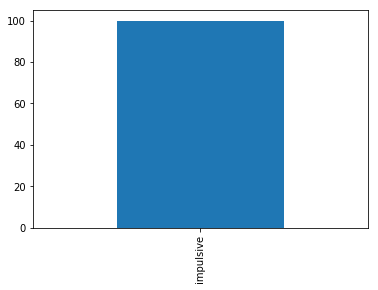

In [8]:
pd.Series(winner_list).value_counts().plot.bar();

In [9]:
pd.Series(round_list).value_counts()[1000]

100

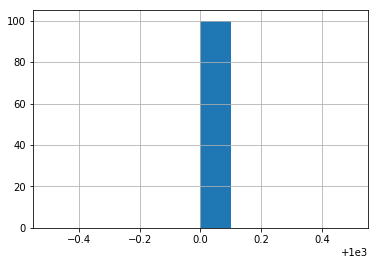

In [10]:
pd.Series(round_list).hist()